In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import gc
import random 

from astropy.coordinates import SkyCoord
import astropy.units as u

import lsst.daf.butler as dafButler
from lsst.pex.config import Config
from lsst.pipe.base import Instrument
import lsst.afw.display as afwDisplay
import lsst.display.astrowidgets

In [2]:
afwDisplay.setDefaultBackend('astrowidgets')
afwDisplay.setDefaultBackend('matplotlib')
plt.style.use('tableau-colorblind10')
%matplotlib inline

In [3]:
repo = '/sdf/group/rubin/repo/embargo'
skymapName = 'latiss_v1'
instrumentName = 'LATISS'

collection_good = f"u/{os.environ['USER']}/auxtel_goodseeing_template_subtract"
collection_deep = f"u/{os.environ['USER']}/auxtel_deep_template_subtract"

butler_good = dafButler.Butler(repo, collections=collection_good, skymap=skymapName)
butler_deep = dafButler.Butler(repo, collections=collection_deep, skymap=skymapName)

registry_good = butler_good.registry
registry_deep = butler_deep.registry

In [4]:
def cutout_coadd(butler, ra, dec, band='r', datasetType='deepCoadd',
                 skymap=None, cutoutSideLength=51, **kwargs):
    """
    Produce a cutout from a coadd at the given ra, dec position.

    Adapted from DC2 tutorial notebook by Michael Wood-Vasey.

    Parameters
    ----------
    butler: lsst.daf.persistence.Butler
        Helper object providing access to a data repository
    ra: float
        Right ascension of the center of the cutout, in degrees
    dec: float
        Declination of the center of the cutout, in degrees
    band: string
        Filter of the image to load
    datasetType: string ['deepCoadd']
        Which type of coadd to load.  Doesn't support 'calexp'
    skymap: lsst.afw.skyMap.SkyMap [optional]
        Pass in to avoid the Butler read.  Useful if you have lots of them.
    cutoutSideLength: float [optional]
        Size of the cutout region in pixels.

    Returns
    -------
    MaskedImage
    """
    radec = geom.SpherePoint(ra, dec, geom.degrees)
    cutoutSize = geom.ExtentI(cutoutSideLength, cutoutSideLength)

    if skymap is None:
        skymap = butler.get("skyMap")

    # Look up the tract, patch for the RA, Dec
    tractInfo = skymap.findTract(radec)
    patchInfo = tractInfo.findPatch(radec)
    xy = geom.PointI(tractInfo.getWcs().skyToPixel(radec))
    bbox = geom.BoxI(xy - cutoutSize // 2, cutoutSize)
    patch = tractInfo.getSequentialPatchIndex(patchInfo)

    coaddId = {'tract': tractInfo.getId(), 'patch': patch, 'band': band}
    parameters = {'bbox': bbox}

    cutout_image = butler.get(datasetType, parameters=parameters,
                              dataId=coaddId)

    return cutout_image

def remove_figure(fig):
    """
    Remove a figure to reduce memory footprint.

    Parameters
    ----------
    fig: matplotlib.figure.Figure
        Figure to be removed.

    Returns
    -------
    None
    """
    # get the axes and clear their images
    for ax in fig.get_axes():
        for im in ax.get_images():
            im.remove()
    fig.clf()       # clear the figure
    plt.close(fig)  # close the figure

## check number of visits going into goodSeeingCoadd for the same dataId in good and deep

In [11]:
datasetrefs = registry_good.queryDatasets('goodSeeingCoadd')
for i, ref in enumerate(list(datasetrefs)[120:130]):
    dataId = ref.dataId.mapping
    print(dataId)
    exposure_good = butler_good.get('goodSeeingCoadd', dataId=dataId)
    visits_good = exposure_good.getInfo().getCoaddInputs().visits
    print('Number of visits in good: ', len(visits_good))

    exposure_deep = butler_deep.get('goodSeeingCoadd', dataId=dataId)
    visits_deep = exposure_deep.getInfo().getCoaddInputs().visits
    print('Number of visits in deep: ', len(visits_deep))

    print('------------------')

{band: 'r', skymap: 'latiss_v1', tract: 3864, patch: 237}
Number of visits in good:  66
Number of visits in deep:  208
------------------
{band: 'i', skymap: 'latiss_v1', tract: 5615, patch: 333}
Number of visits in good:  8
Number of visits in deep:  24
------------------
{band: 'g', skymap: 'latiss_v1', tract: 5615, patch: 276}
Number of visits in good:  10
Number of visits in deep:  24
------------------
{band: 'i', skymap: 'latiss_v1', tract: 5615, patch: 293}
Number of visits in good:  40
Number of visits in deep:  109
------------------
{band: 'r', skymap: 'latiss_v1', tract: 10644, patch: 181}
Number of visits in good:  2
Number of visits in deep:  2
------------------
{band: 'i', skymap: 'latiss_v1', tract: 452, patch: 44}
Number of visits in good:  6
Number of visits in deep:  7
------------------
{band: 'i', skymap: 'latiss_v1', tract: 5615, patch: 295}
Number of visits in good:  32
Number of visits in deep:  93
------------------
{band: 'i', skymap: 'latiss_v1', tract: 5634,

In [12]:
dataid_template_list = [{'band': 'r', 'skymap': 'latiss_v1', 'tract': 8188, 'patch': 65},
                        {'band': 'g', 'skymap': 'latiss_v1', 'tract': 10644, 'patch': 183},
                        {'band': 'i', 'skymap': 'latiss_v1', 'tract': 3863, 'patch': 262},
                        {'band': 'y', 'skymap': 'latiss_v1', 'tract': 383, 'patch': 359},
                        {'band': 'y', 'skymap': 'latiss_v1', 'tract': 455, 'patch': 14},
                        {'band': 'i', 'skymap': 'latiss_v1', 'tract': 5614, 'patch': 211},
                        {'band': 'i', 'skymap': 'latiss_v1', 'tract': 382, 'patch': 342},
                        {'band': 'r', 'skymap': 'latiss_v1', 'tract': 455, 'patch': 33},
                        {'band': 'g', 'skymap': 'latiss_v1', 'tract': 3864, 'patch': 254},
                        {'band': 'i', 'skymap': 'latiss_v1', 'tract': 5634, 'patch': 74},
                        {'band': 'r', 'skymap': 'latiss_v1', 'tract': 5634, 'patch': 93},
                        {'band': 'g', 'skymap': 'latiss_v1', 'tract': 3864, 'patch': 256},
                        {'band': 'g', 'skymap': 'latiss_v1', 'tract': 5634, 'patch': 92},
                        {'band': 'r', 'skymap': 'latiss_v1', 'tract': 5634, 'patch': 92}]

good_template_visits = [1, 2, 5, 4, 5, 8, 16, 22, 25, 34, 47, 63, 102, 119]
deep_template_visits = [1, 2, 5, 12, 17, 21, 41, 54, 79, 97, 137, 195, 265, 350]

In [13]:
print('Selecting random 10 visits from the vitis in goodseeing template')
visit_list = []
for i, dataId in enumerate(dataid_template_list):
    print(dataId)
    print('Number of visits in good template: ', good_template_visits[i])
    print('Number of visits in deep template: ', deep_template_visits[i])
    exposure_good = butler_good.get('goodSeeingCoadd', dataId=dataId)
    visits = exposure_good.getInfo().getCoaddInputs().visits["id"].tolist()
    # choose random 4 visits for each dataid
    # if len(set(visits)) >= 4:
    #     random_visits = random.sample(visits, 4)
    if len(set(visits)) >= 10:
        random_visits = random.sample(visits, 10)
    else:
        random_visits = visits
    print(random_visits)
    visit_list.append(random_visits)
    print('----------------')

Selecting random 10 visits from the vitis in goodseeing template
{'band': 'r', 'skymap': 'latiss_v1', 'tract': 8188, 'patch': 65}
Number of visits in good template:  1
Number of visits in deep template:  1
[2023070400574]
----------------
{'band': 'g', 'skymap': 'latiss_v1', 'tract': 10644, 'patch': 183}
Number of visits in good template:  2
Number of visits in deep template:  2
[2023070400488, 2023070400596]
----------------
{'band': 'i', 'skymap': 'latiss_v1', 'tract': 3863, 'patch': 262}
Number of visits in good template:  5
Number of visits in deep template:  5
[2023110700574, 2023110700580, 2023110700583, 2023110700593, 2023110700596]
----------------
{'band': 'y', 'skymap': 'latiss_v1', 'tract': 383, 'patch': 359}
Number of visits in good template:  4
Number of visits in deep template:  12
[2023112100225, 2023112100229, 2023112100233, 2023112900295]
----------------
{'band': 'y', 'skymap': 'latiss_v1', 'tract': 455, 'patch': 14}
Number of visits in good template:  5
Number of vis

In [14]:
visit_list

[[2023070400574],
 [2023070400488, 2023070400596],
 [2023110700574, 2023110700580, 2023110700583, 2023110700593, 2023110700596],
 [2023112100225, 2023112100229, 2023112100233, 2023112900295],
 [2023112100217, 2023112100221, 2023112100225, 2023112100233, 2023112800294],
 [2023051100399,
  2023051100493,
  2023051100498,
  2023051100499,
  2023051100529,
  2023051100543,
  2023051100546,
  2023051100549],
 [2023111300239,
  2023111300245,
  2023110800309,
  2023111300188,
  2023111300197,
  2023110800342,
  2023111300203,
  2023110800318,
  2023111300209,
  2023111300242],
 [2023110800341,
  2023110800367,
  2023110800326,
  2023111300232,
  2023110800320,
  2023110800284,
  2023111300211,
  2023110800364,
  2023110800347,
  2023111300247],
 [2023120400593,
  2023120500517,
  2023120600220,
  2023112700353,
  2023112700357,
  2023120400589,
  2023112700385,
  2023120600315,
  2023120600256,
  2023120400585],
 [2023080300612,
  2023082900347,
  2023080300330,
  2023071800243,
  2023071800

In [8]:
# random_visit_list = [2023112000329, 2023111600694, 2023111600689, 2023111600420, 2023092800080, 2023080300471, 2023082900460, 2023072000171, 2023052400666, 2023051100472]

In [9]:
# visit_list = (2023112100513, 2023112900274, 2023120400545, 2023112800610, 2023112000366, 2023051100287)
# visit_list = random_visit_list
# dataId_list = []

# refs = registry_good.queryDatasets('calexp', 
#                                   where="visit IN (visit_ids)",
#                                   bind={"visit_ids": visit_list})
# for ref in refs:
#     print(ref.dataId)
#     dataId_list.append(ref.dataId)

In [10]:
# datasetrefs = registry_good.queryDatasets('goodSeeingCoadd')
# for i, ref in enumerate(list(datasetrefs)[0:1]):
#     dataId = ref.dataId.mapping
#     print(dataId)
#     exposure_good = butler_good.get('goodSeeingCoadd', dataId=dataId)
#     visits = exposure_good.getInfo().getCoaddInputs().visits["id"]
#     # choose random 4 visits for each dataid
#     random_visits = np.random.choice(visits, 4)
#     print(random_visits)

In [11]:
# exposure_good = butler_good.get('goodSeeingCoadd', dataId={'band': 'g', 'skymap': 'latiss_v1', 'tract': 3864, 'patch': 237})
# exposure_good.getInfo().getVisitInfo()

In [12]:
# datasetrefs = registry_good.queryDatasets('goodSeeingCoadd')
# for i, ref in enumerate(list(datasetrefs)[110:130]):
#     dataId = ref.dataId.mapping
#     print(dataId)
#     exposure_good = butler_good.get('goodSeeingCoadd', dataId=dataId)
#     visits_good = exposure_good.getInfo().getCoaddInputs().visits
#     print('Number of visits in good: ', len(visits_good))

#     exposure_deep = butler_deep.get('goodSeeingCoadd', dataId=dataId)
#     visits_deep = exposure_deep.getInfo().getCoaddInputs().visits
#     print('Number of visits in deep: ', len(visits_deep))

#     print('------------------')

## Plotting DIA sources

In [13]:
# Because the number of visits is the same in deep and good, use one of these to get the list if visits
def get_visits(datasettype):
    # visitList_deep = []
    visitlist_good = []

    # for item in registry_deep.queryDatasets(datasettype):
    #     visitList_deep.append(item.dataId.get('visit'))
    for item in registry_good.queryDatasets(datasettype):
        visitlist_good.append(item.dataId.get('visit'))

    if datasettype == 'goodSeeingDiff_diaSrcTable':
        detector_good = []
        for item in registry_good.queryDatasets(datasettype):
            detector_good.append(item.dataId.get('detector'))
            
        return visitlist_good, detector_good

    return visitlist_good

In [14]:
def plot_ra_dec_srcs(datasettype, visitlist_good, num_good_visits, num_deep_visits):
    
    # fig, axs = plt.subplots(int(len(visitlist_good)/2),2, figsize=(16, 40), facecolor='w', edgecolor='k')
    if len(visitlist_good) > 2:
        fig, axs = plt.subplots(int(len(visitlist_good)/2),2, figsize=(8,6), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .3, wspace=.2)
    else:
        fig, axs = plt.subplots(1, 2, figsize=(8,3), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .3, wspace=.2)
    axs = axs.ravel()
    for i, visit in enumerate(visitlist_good):
        if datasettype == 'goodSeeingDiff_diaSrcTable':
            oneDiaSourceTable_good = butler_good.get(datasettype, visit=visit, detector=0)
            oneDiaSourceTable_deep = butler_deep.get(datasettype, visit=visit, detector=0)
        else:
            oneDiaSourceTable_good = butler_good.get(datasettype, visit=visit)
            oneDiaSourceTable_deep = butler_deep.get(datasettype, visit=visit)
        
        axs[i].scatter(oneDiaSourceTable_good['ra'], oneDiaSourceTable_good['dec'], s=24, color='C1', label='good', marker='*')
        axs[i].scatter(oneDiaSourceTable_deep['ra'], oneDiaSourceTable_deep['dec'], s=8, color='C0', label = 'deep')
        # axs[i].set_title(datasettype + ': Visit '+ str(visit), fontsize=14)
        axs[i].set_title('Visit: '+ str(visit)+' '+'good '+str(num_good_visits)+' '+'deep '+str(num_deep_visits), fontsize=7)
        # axs[i].set_xlabel('RA (deg)', fontsize=14)
        # axs[i].set_ylabel('DEC (deg)', fontsize=14)
        # axs[i].xaxis.set_tick_params(labelsize=12)
        # axs[i].yaxis.set_tick_params(labelsize=12)
        axs[i].set_xlabel('RA (deg)', fontsize=7)
        axs[i].set_ylabel('DEC (deg)', fontsize=7)
        axs[i].xaxis.set_tick_params(labelsize=6)
        axs[i].yaxis.set_tick_params(labelsize=6)
        # axs[i].set_xticks(fontsize=12)
        # axs[i].set_yticks(fontsize=12)
        axs[i].legend(loc='lower left')

    return axs

### Plotting DIA sources for the visits going into templates

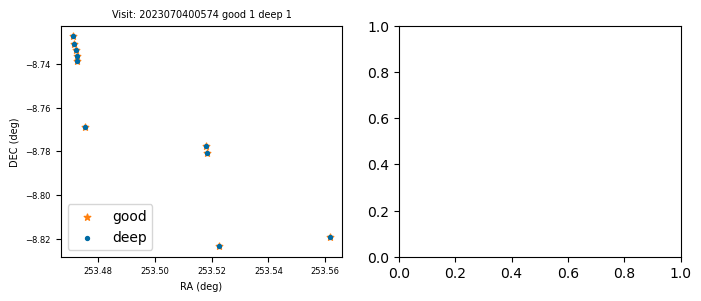

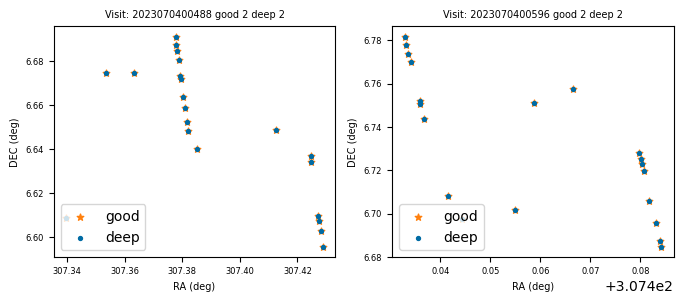

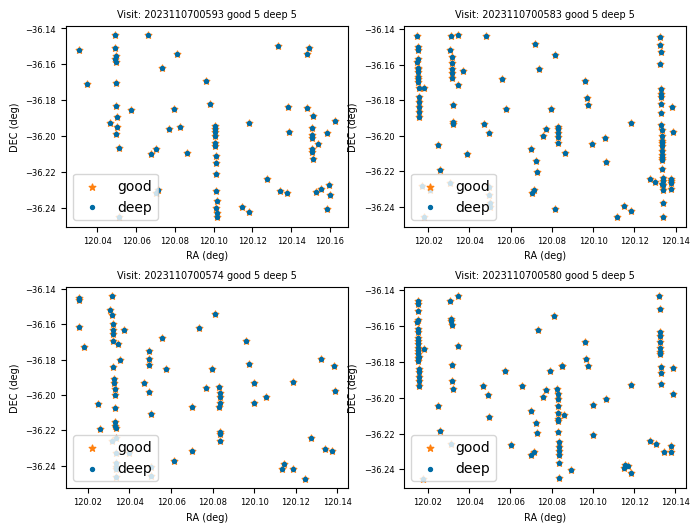

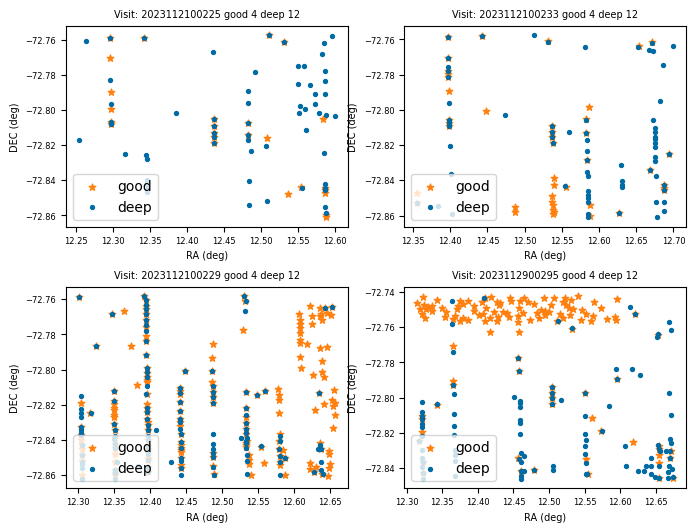

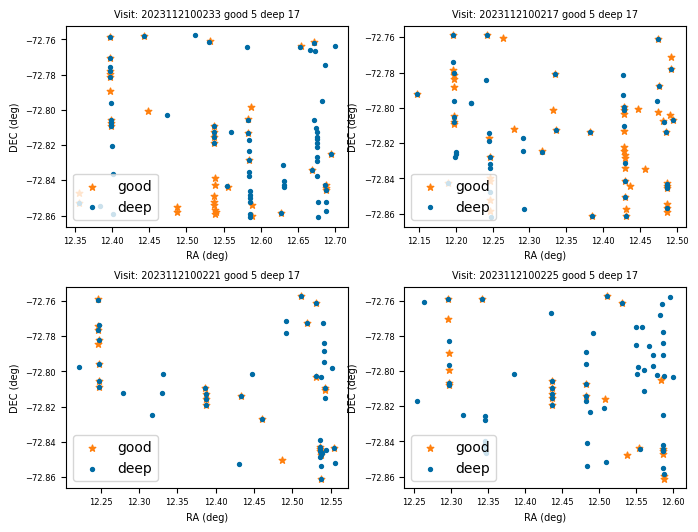

...

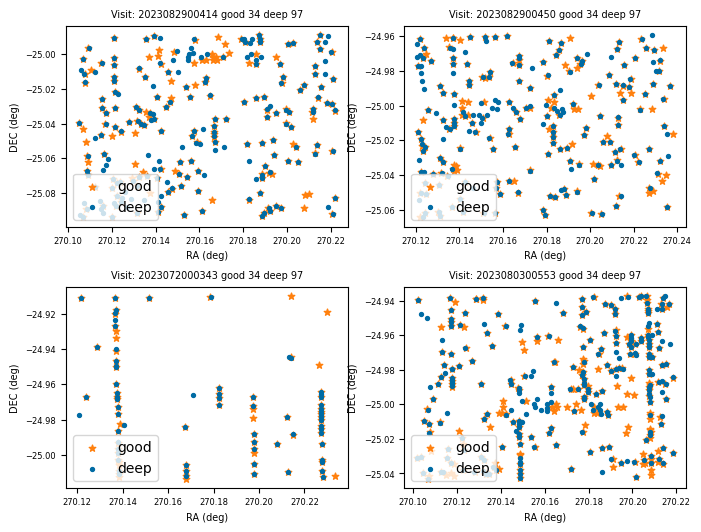

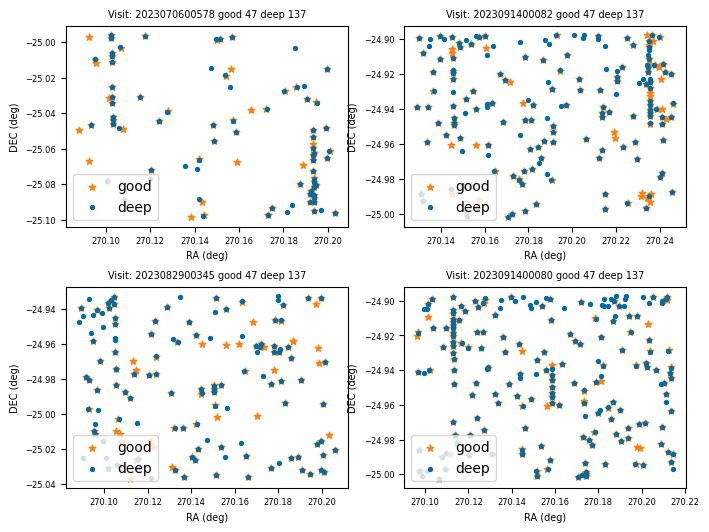

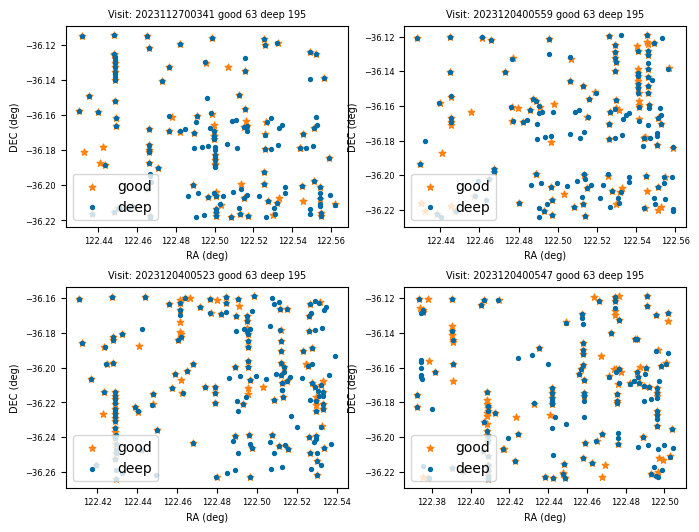

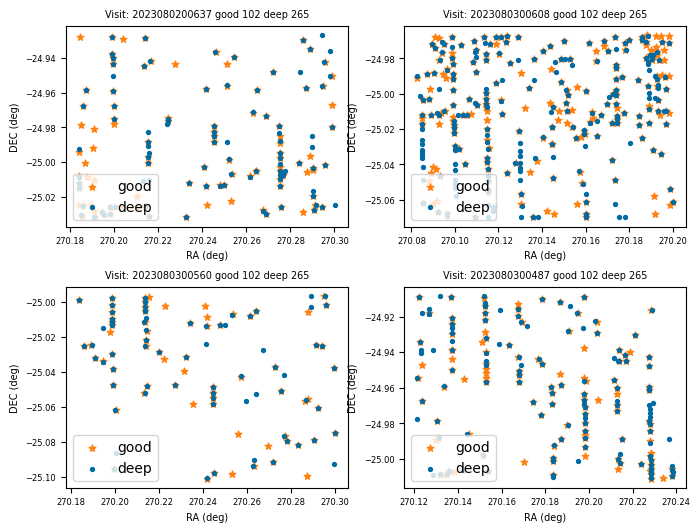

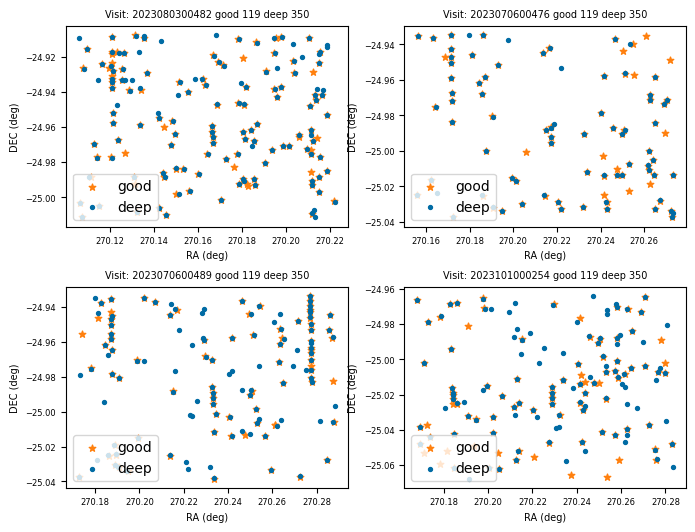

In [15]:
for i, visits in enumerate(visit_list):
    axs = plot_ra_dec_srcs('goodSeeingDiff_diaSrcTable', visits, good_template_visits[i], deep_template_visits[i])
    axs

## DataId from calexp

In [15]:
dataId_list_all_templates = []

for i, visits in enumerate(visit_list):
    print('Number of visits in good template: ', good_template_visits[i])
    print('Number of visits in deep template: ', deep_template_visits[i])    
    refs = registry_good.queryDatasets('calexp', 
                                      where="visit IN (visit_ids)",
                                      bind={"visit_ids": visits})
    dataId_list = []
    for ref in refs:
        print(ref.dataId)
        dataId_list.append(ref.dataId)
    dataId_list_all_templates.append(dataId_list)
    print('---------------------------')

Number of visits in good template:  1
Number of visits in deep template:  1
{instrument: 'LATISS', detector: 0, visit: 2023070400574, band: 'r', day_obs: 20230704, physical_filter: 'SDSSr_65mm~empty'}
---------------------------
Number of visits in good template:  2
Number of visits in deep template:  2
{instrument: 'LATISS', detector: 0, visit: 2023070400488, band: 'g', day_obs: 20230704, physical_filter: 'SDSSg_65mm~empty'}
{instrument: 'LATISS', detector: 0, visit: 2023070400596, band: 'g', day_obs: 20230704, physical_filter: 'SDSSg_65mm~empty'}
---------------------------
Number of visits in good template:  5
Number of visits in deep template:  5
{instrument: 'LATISS', detector: 0, visit: 2023110700574, band: 'i', day_obs: 20231107, physical_filter: 'empty~SDSSi_65mm'}
{instrument: 'LATISS', detector: 0, visit: 2023110700580, band: 'i', day_obs: 20231107, physical_filter: 'empty~SDSSi_65mm'}
{instrument: 'LATISS', detector: 0, visit: 2023110700583, band: 'i', day_obs: 20231107, phy

In [16]:
visit_list_all = [x for xs in visit_list for x in xs]

In [17]:
num_visits_good = []
num_visits_deep = []

for i, dataId_list in enumerate(dataId_list_all_templates):
    for dataId in dataId_list:
        num_visits_good.append(good_template_visits[i])
        num_visits_deep.append(deep_template_visits[i])  

## Plotting num of srcs in calexp and difference images from good and deep

In [18]:
num_diff_srcs_good = []
num_diff_srcs_deep = []

for i, visits in enumerate(visit_list):
    for j, visit in enumerate(visits):
        oneDiaSourceTable_good = butler_good.get('goodSeeingDiff_diaSrcTable', visit=visit, detector=0)
        oneDiaSourceTable_deep = butler_deep.get('goodSeeingDiff_diaSrcTable', visit=visit, detector=0)
        num_diff_srcs_good.append(len(oneDiaSourceTable_good['ra']))
        num_diff_srcs_deep.append(len(oneDiaSourceTable_deep['ra']))

In [19]:
num_calexp_srcs_good = []
num_calexp_srcs_deep = []

for i, visits in enumerate(visit_list):
    for j, visit in enumerate(visits):
        oneDiaSourceTable_good = butler_good.get('sourceTable_visit', visit=visit, detector=0)
        oneDiaSourceTable_deep = butler_deep.get('sourceTable_visit', visit=visit, detector=0)
        num_calexp_srcs_good.append(len(oneDiaSourceTable_good['ra']))
        num_calexp_srcs_deep.append(len(oneDiaSourceTable_deep['ra']))

In [20]:
num_srcs_dict = {'num of visits in good template': num_visits_good,
                'num of visits in deep template': num_visits_deep,
                'visit' : visit_list_all,
                'srcs in calexp good': num_calexp_srcs_good, 
                'srcs in calexp deep': num_calexp_srcs_deep, 
                'srcs in difference good': num_diff_srcs_good,
                'srcs in difference deep': num_diff_srcs_deep,
                }
num_srcs_df = pd.DataFrame.from_dict(num_srcs_dict)

In [21]:
num_srcs_df

,num of visits in good template,num of visits in deep template,visit,srcs in calexp good,srcs in calexp deep,srcs in difference good,srcs in difference deep
0,1,1,2023070400574,243,243,10,10
1,2,2,2023070400488,240,240,21,21
2,2,2,2023070400596,286,286,20,20
3,5,5,2023110700574,1037,1037,74,74
4,5,5,2023110700580,974,974,98,98
...,...,...,...,...,...,...,...
100,119,350,2023082900447,1467,1467,120,115
101,119,350,2023072000225,923,923,128,122
102,119,350,2023080300326,1434,1434,150,166
103,119,350,2023052400660,2089,2089,172,191


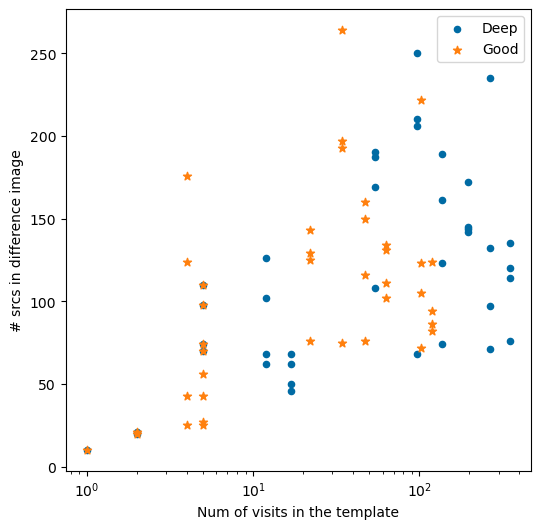

In [23]:
fig, (ax1) = plt.subplots(nrows=1, sharex=True, figsize=(6,6))

ax1.scatter(num_visits_deep, num_diff_srcs_deep, marker='o', s=20, label='Deep')
ax1.scatter(num_visits_good, num_diff_srcs_good, marker='*', label='Good')
ax1.set_ylabel('# srcs in difference image')
ax1.set_xscale('log')
ax1.legend()

# ax2.scatter(num_visits_deep, num_calexp_srcs_deep, marker='o', s=20, label='Deep')
# ax2.scatter(num_visits_good, num_calexp_srcs_good, marker='*', label='Good')
# ax2.set_ylabel('# srcs in calexp image')
# ax2.legend()

plt.xlabel('Num of visits in the template')


plt.show()

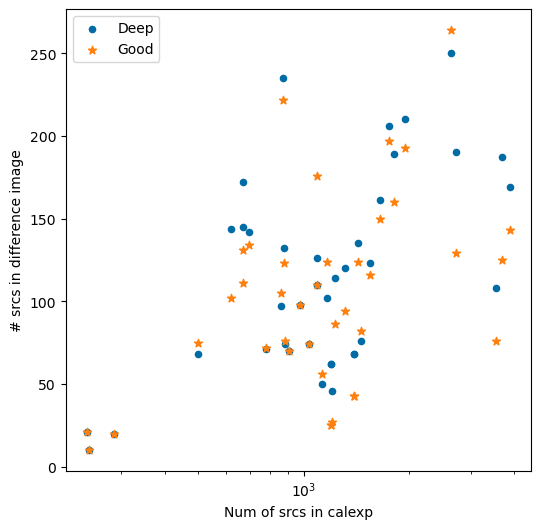

In [24]:
fig, (ax1) = plt.subplots(nrows=1, sharex=True, figsize=(6,6))

ax1.scatter(num_calexp_srcs_good, num_diff_srcs_deep, marker='o', s=20, label='Deep')
ax1.scatter(num_calexp_srcs_good, num_diff_srcs_good, marker='*', label='Good')
ax1.set_ylabel('# srcs in difference image')
ax1.set_xscale('log')
ax1.legend()

# ax2.scatter(num_visits_deep, num_calexp_srcs_deep, marker='o', s=20, label='Deep')
# ax2.scatter(num_visits_good, num_calexp_srcs_good, marker='*', label='Good')
# ax2.set_ylabel('# srcs in calexp image')
# ax2.legend()

plt.xlabel('Num of srcs in calexp')


plt.show()

### Plotting with flags applied

In [57]:
def plot_ra_dec_srcs_with_cuts(datasettype, flag, visitlist_good, num_good_visits, num_deep_visits):
    
    # fig, axs = plt.subplots(int(len(visitlist_good)/2),2, figsize=(16, 40), facecolor='w', edgecolor='k')
    if len(visitlist_good) > 2:
        fig, axs = plt.subplots(int(len(visitlist_good)/2),2, figsize=(8,6), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .3, wspace=.2)
    else:
        fig, axs = plt.subplots(1, 2, figsize=(8,3), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .3, wspace=.2)
    axs = axs.ravel()
    for i, visit in enumerate(visitlist_good):
        if datasettype == 'goodSeeingDiff_diaSrcTable':
            oneDiaSourceTable_good = butler_good.get(datasettype, visit=visit, detector=0)
            oneDiaSourceTable_good = oneDiaSourceTable_good[oneDiaSourceTable_good[flag] == False]
            
            oneDiaSourceTable_deep = butler_deep.get(datasettype, visit=visit, detector=0)
            oneDiaSourceTable_deep = oneDiaSourceTable_deep[oneDiaSourceTable_deep[flag] == False]
        else:
            oneDiaSourceTable_good = butler_good.get(datasettype, visit=visit)
            oneDiaSourceTable_deep = butler_deep.get(datasettype, visit=visit)
        
        axs[i].scatter(oneDiaSourceTable_good['ra'], oneDiaSourceTable_good['dec'], s=24, color='C1', label='good', marker='*')
        axs[i].scatter(oneDiaSourceTable_deep['ra'], oneDiaSourceTable_deep['dec'], s=8, color='C0', label = 'deep')
        # axs[i].set_title(datasettype + ': Visit '+ str(visit), fontsize=14)
        axs[i].set_title('Visit: '+ str(visit)+' '+'good '+str(num_good_visits)+' '+'deep '+str(num_deep_visits), fontsize=7)
        # axs[i].set_xlabel('RA (deg)', fontsize=14)
        # axs[i].set_ylabel('DEC (deg)', fontsize=14)
        # axs[i].xaxis.set_tick_params(labelsize=12)
        # axs[i].yaxis.set_tick_params(labelsize=12)
        axs[i].set_xlabel('RA (deg)', fontsize=7)
        axs[i].set_ylabel('DEC (deg)', fontsize=7)
        axs[i].xaxis.set_tick_params(labelsize=6)
        axs[i].yaxis.set_tick_params(labelsize=6)
        # axs[i].set_xticks(fontsize=12)
        # axs[i].set_yticks(fontsize=12)
        axs[i].legend(loc='lower left')

    return axs

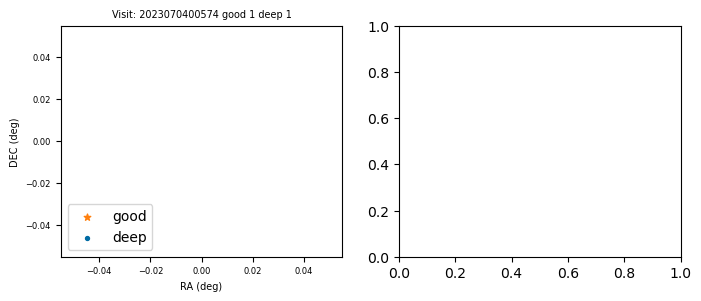

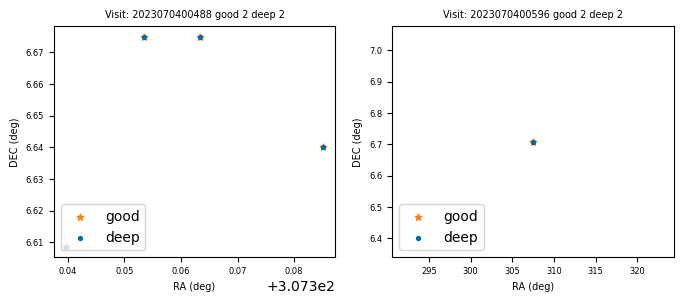

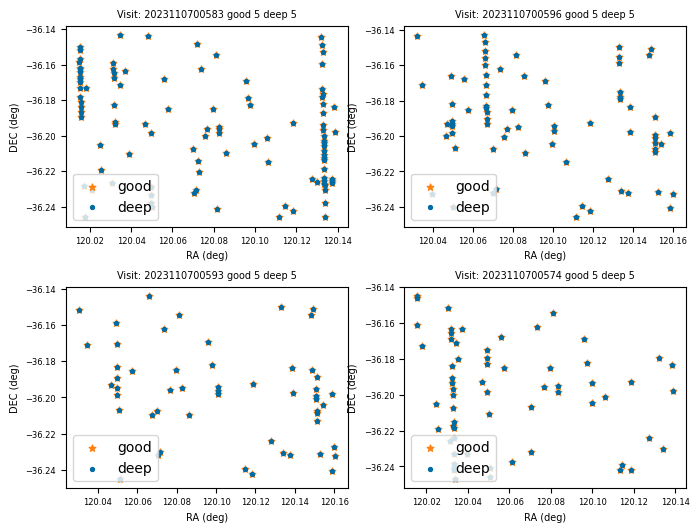

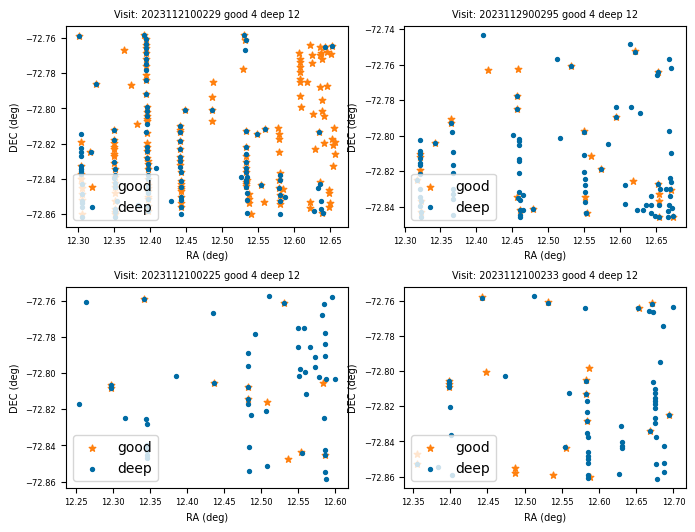

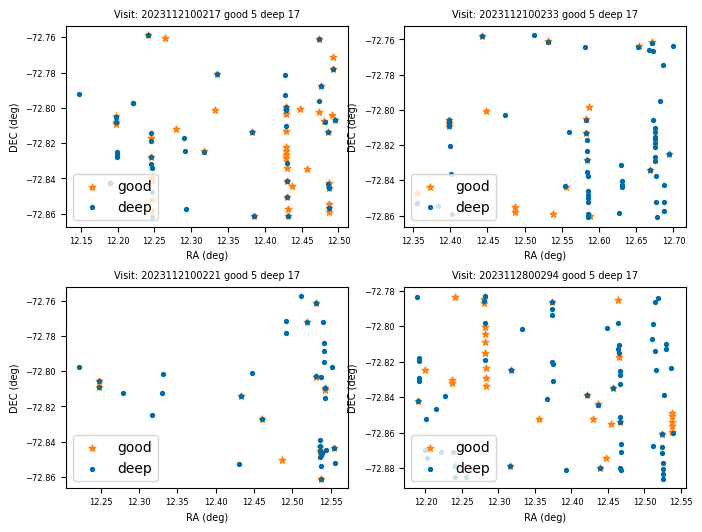

...

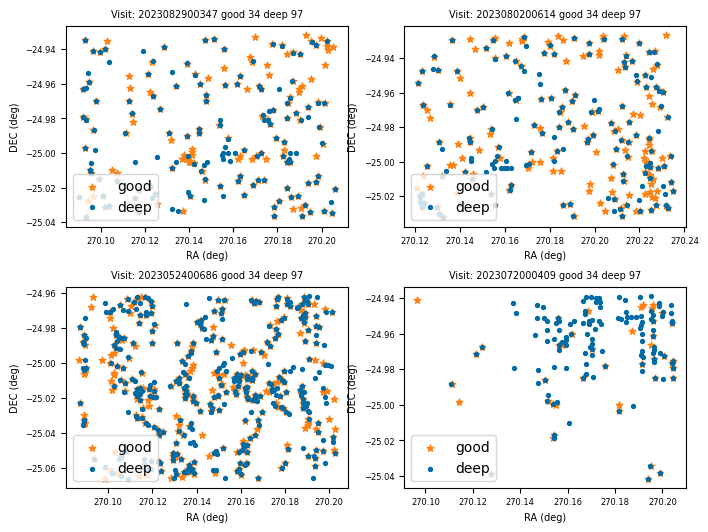

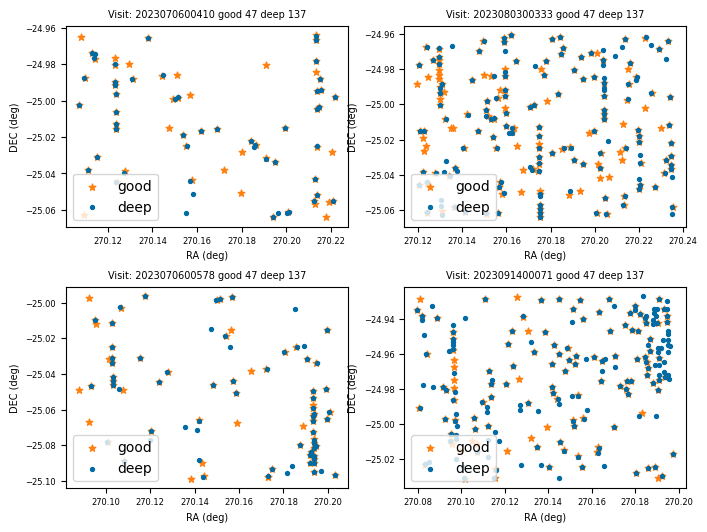

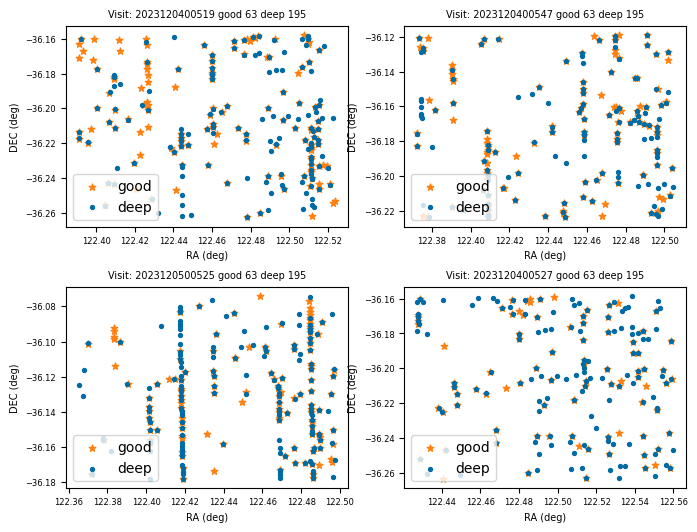

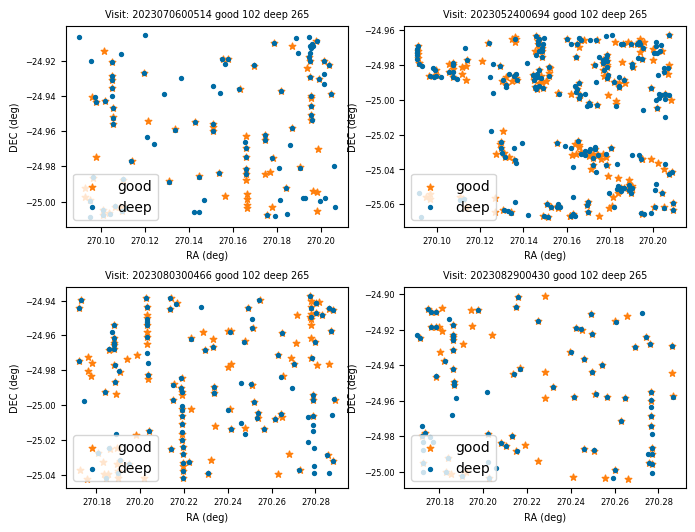

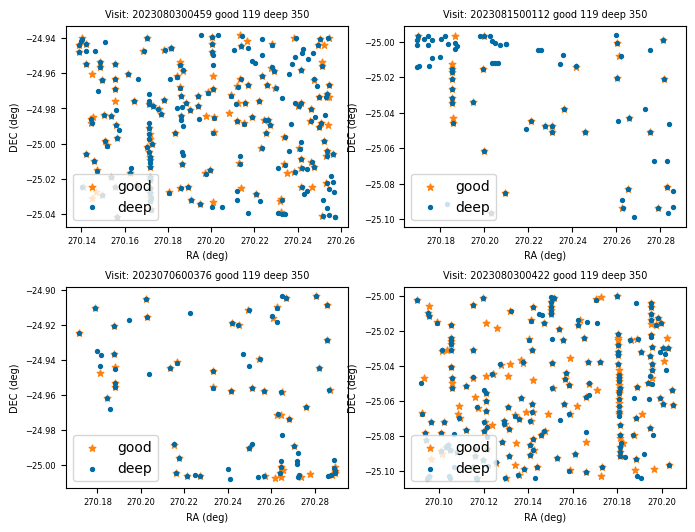

In [58]:
for i, visits in enumerate(visit_list):
    axs = plot_ra_dec_srcs_with_cuts('goodSeeingDiff_diaSrcTable', 'pixelFlags_edge', visits, good_template_visits[i], deep_template_visits[i])
    axs

In [59]:
num_diff_srcs_good_with_cuts = []
num_diff_srcs_deep_with_cuts = []

for i, visits in enumerate(visit_list):
    for j, visit in enumerate(visits):
        oneDiaSourceTable_good = butler_good.get('goodSeeingDiff_diaSrcTable', visit=visit, detector=0)
        oneDiaSourceTable_good = oneDiaSourceTable_good[oneDiaSourceTable_good['pixelFlags_edge'] == False]
        oneDiaSourceTable_deep = butler_deep.get('goodSeeingDiff_diaSrcTable', visit=visit, detector=0)
        oneDiaSourceTable_deep = oneDiaSourceTable_deep[oneDiaSourceTable_deep['pixelFlags_edge'] == False]
        num_diff_srcs_good_with_cuts.append(len(oneDiaSourceTable_good['ra']))
        num_diff_srcs_deep_with_cuts.append(len(oneDiaSourceTable_deep['ra']))

In [63]:
num_srcs_dict_with_cuts = {'num of visits in good template': num_visits_good,
                'num of visits in deep template': num_visits_deep,
                'visit' : visit_list_all,
                'srcs in calexp good': num_calexp_srcs_good, 
                'srcs in calexp deep': num_calexp_srcs_deep, 
                'srcs in difference good': num_diff_srcs_good_with_cuts,
                'srcs in difference deep': num_diff_srcs_deep_with_cuts,
                }
num_srcs_df_with_cuts = pd.DataFrame.from_dict(num_srcs_dict_with_cuts)

In [64]:
num_srcs_df_with_cuts

,num of visits in good template,num of visits in deep template,visit,srcs in calexp good,srcs in calexp deep,srcs in difference good,srcs in difference deep
0,1,1,2023070400574,243,243,0,0
1,2,2,2023070400488,240,240,4,4
2,2,2,2023070400596,286,286,1,1
3,5,5,2023110700583,1092,1092,103,103
4,5,5,2023110700596,859,859,73,73
5,5,5,2023110700593,909,909,53,53
6,5,5,2023110700574,1037,1037,63,63
7,4,12,2023112100229,1093,1093,161,113
8,4,12,2023112900295,1167,1167,32,92
9,4,12,2023112100225,1193,1193,12,54


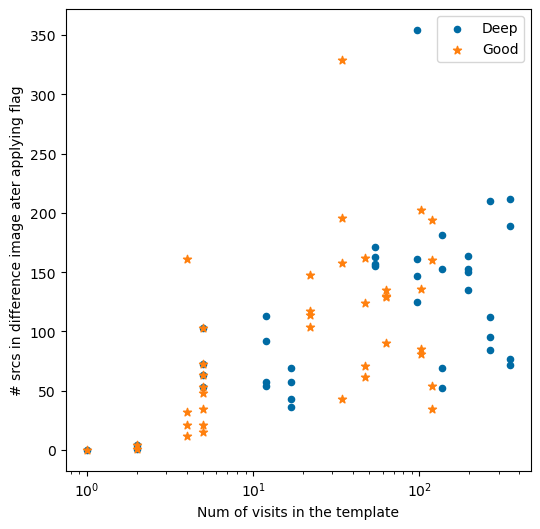

In [65]:
fig, (ax1) = plt.subplots(nrows=1, sharex=True, figsize=(6,6))

ax1.scatter(num_visits_deep, num_diff_srcs_deep_with_cuts, marker='o', s=20, label='Deep')
ax1.scatter(num_visits_good, num_diff_srcs_good_with_cuts, marker='*', label='Good')
ax1.set_ylabel('# srcs in difference image ater applying flag')
ax1.set_xscale('log')
ax1.legend()

# ax2.scatter(num_visits_deep, num_calexp_srcs_deep, marker='o', s=20, label='Deep')
# ax2.scatter(num_visits_good, num_calexp_srcs_good, marker='*', label='Good')
# ax2.set_ylabel('# srcs in calexp image')
# ax2.legend()

plt.xlabel('Num of visits in the template')


plt.show()

## Looking into the Variance of calexp, template, and Difference images

### The psf determinant radius is computed  

https://community.lsst.org/t/image-difference-task-using-decam-images-gen3/5947/27

https://pipelines.lsst.io/py-api/lsst.afw.geom.Quadrupole.html#lsst.afw.geom.Quadrupole

What are the units?

In [22]:
# Plotting calexp, template and difference image variance


sigma2fwhm = 2.*np.sqrt(2.*np.log(2.))

median_calexp_good = []
median_template_good = []
median_diff_good = []

psf_radius_calexp_good = []
psf_radius_template_good = []
psf_radius_diff_good = []

for i, dataId_list in enumerate(dataId_list_all_templates):
    print('Number of visits in good template: ', good_template_visits[i])

    for dataId in dataId_list:
        dataId = dataId.mapping
        dataId_string = {str(key): dataId[key] for key in dataId.keys()}
        
        # calexp_image_good = butler_deep.get('calexp', **dataId_string).image
        # diff_image_deep = butler_deep.get('goodSeeingDiff_differenceExp', **dataId_string).image
        # template_image_deep = butler_deep.get('goodSeeingDiff_templateExp', **dataId_string).image
    
        calexp_image_good = butler_good.get('calexp', **dataId_string).variance
        diff_image_good = butler_good.get('goodSeeingDiff_differenceExp', **dataId_string).variance
        template_image_good = butler_good.get('goodSeeingDiff_templateExp', **dataId_string).variance

        calexp_image_psf = butler_good.get('calexp', **dataId_string).psf
        calexp_psf_radius = calexp_image_psf.computeShape(calexp_image_psf.getAveragePosition()).getDeterminantRadius()*sigma2fwhm
        
        diff_image_psf = butler_good.get('goodSeeingDiff_differenceExp', **dataId_string).psf
        diff_psf_radius = diff_image_psf.computeShape(diff_image_psf.getAveragePosition()).getDeterminantRadius()*sigma2fwhm
        
        template_image_psf = butler_good.get('goodSeeingDiff_templateExp', **dataId_string).psf
        template_psf_radius = template_image_psf.computeShape(template_image_psf.getAveragePosition()).getDeterminantRadius()*sigma2fwhm

        
        psf_radius_calexp_good.append(calexp_psf_radius)
        psf_radius_template_good.append(template_psf_radius)
        psf_radius_diff_good.append(diff_psf_radius)
    
        # fig, ax = plt.subplots(figsize=(4,4))
    
        # display_template_good = afwDisplay.Display(frame=fig)
        # display_template_good.scale('linear', 'zscale')
        # display_template_good.mtv(template_image_good)
        # plt.title('Deep template : '+str(dataId['visit']), fontsize=16)
        # ax2 = plt.gca()
        # xax2 = ax2.axes.get_xaxis().set_visible(False)
        # yax2 = ax2.axes.get_yaxis().set_visible(False)
        # plt.show()
        # display_template_good.delAllDisplays()
        # remove_figure(fig)

        image_arr = template_image_good.array
        median_template = round(np.nanmedian(image_arr), 3)
        median_template_good.append(median_template)
        # print("median of the good template: ", np.nanmedian(image_arr))
        # print("std of the good template: ", np.nanstd(image_arr))
    
        # display_good = afwDisplay.Display(frame=fig)
        # display_good.scale('linear', 'zscale')
        # display_good.mtv(calexp_image_good)
        # plt.title('calexp : '+str(dataId['visit']), fontsize=16)
        # ax1 = plt.gca()
        # xax1 = ax1.axes.get_xaxis().set_visible(False)
        # yax1 = ax1.axes.get_yaxis().set_visible(False)
        # plt.show()
        # remove_figure(fig)

        image_arr = calexp_image_good.array
        median_calexp = round(np.nanmedian(image_arr), 3)
        median_calexp_good.append(median_calexp)
        # print("median of the good calexp: ", np.nanmedian(image_arr))
        # print("std of the good calexp: ", np.nanstd(image_arr))

    
        # display_diff_good = afwDisplay.Display(frame=fig)
        # display_diff_good.scale('linear', 'zscale')
        # display_diff_good.mtv(diff_image_good)
        # plt.title('diff : '+str(dataId['visit']), fontsize=16)
        # ax3 = plt.gca()
        # xax3 = ax3.axes.get_xaxis().set_visible(False)
        # yax3 = ax3.axes.get_yaxis().set_visible(False)
        # plt.show()
        # remove_figure(fig)

        image_arr = diff_image_good.array
        median_diff = round(np.nanmedian(image_arr), 3)
        median_diff_good.append(median_diff)
        # print("median of the good difference: ", np.nanmedian(image_arr))
        # print("std of the good difference: ", np.nanstd(image_arr))
        
        del(dataId_string)

Number of visits in good template:  1
Number of visits in good template:  2
Number of visits in good template:  5
Number of visits in good template:  4
Number of visits in good template:  5
Number of visits in good template:  8
Number of visits in good template:  16
Number of visits in good template:  22
Number of visits in good template:  25
Number of visits in good template:  34
Number of visits in good template:  47
Number of visits in good template:  63
Number of visits in good template:  102
Number of visits in good template:  119


In [23]:
# Plotting calexp, template and difference image variance

median_calexp_deep = []
median_template_deep = []
median_diff_deep = []

psf_radius_calexp_deep = []
psf_radius_template_deep = []
psf_radius_diff_deep = []

for i, dataId_list in enumerate(dataId_list_all_templates):
    print('Number of visits in deep template: ', deep_template_visits[i])

    for dataId in dataId_list:
        dataId = dataId.mapping
        dataId_string = {str(key): dataId[key] for key in dataId.keys()}
        
        # calexp_image_deep = butler_deep.get('calexp', **dataId_string).image
        # diff_image_deep = butler_deep.get('deepSeeingDiff_differenceExp', **dataId_string).image
        # template_image_deep = butler_deep.get('deepSeeingDiff_templateExp', **dataId_string).image
    
        calexp_image_deep = butler_deep.get('calexp', **dataId_string).variance
        diff_image_deep = butler_deep.get('goodSeeingDiff_differenceExp', **dataId_string).variance
        template_image_deep = butler_deep.get('goodSeeingDiff_templateExp', **dataId_string).variance

        calexp_image_psf = butler_deep.get('calexp', **dataId_string).psf
        calexp_psf_radius = calexp_image_psf.computeShape(calexp_image_psf.getAveragePosition()).getDeterminantRadius()*sigma2fwhm
        
        diff_image_psf = butler_deep.get('goodSeeingDiff_differenceExp', **dataId_string).psf
        diff_psf_radius = diff_image_psf.computeShape(diff_image_psf.getAveragePosition()).getDeterminantRadius()*sigma2fwhm
        
        template_image_psf = butler_deep.get('goodSeeingDiff_templateExp', **dataId_string).psf
        template_psf_radius = template_image_psf.computeShape(template_image_psf.getAveragePosition()).getDeterminantRadius()*sigma2fwhm

        psf_radius_calexp_deep.append(calexp_psf_radius)
        psf_radius_template_deep.append(template_psf_radius)
        psf_radius_diff_deep.append(diff_psf_radius)
    
        # fig, ax = plt.subplots(figsize=(4,4))
    
        # display_template_deep = afwDisplay.Display(frame=fig)
        # display_template_deep.scale('linear', 'zscale')
        # display_template_deep.mtv(template_image_deep)
        # plt.title('Deep template : '+str(dataId['visit']), fontsize=16)
        # ax2 = plt.gca()
        # xax2 = ax2.axes.get_xaxis().set_visible(False)
        # yax2 = ax2.axes.get_yaxis().set_visible(False)
        # plt.show()
        # display_template_deep.delAllDisplays()
        # remove_figure(fig)

        image_arr = template_image_deep.array
        median_template = round(np.nanmedian(image_arr), 3)
        median_template_deep.append(median_template)
        # print("median of the deep template: ", np.nanmedian(image_arr))
        # print("std of the deep template: ", np.nanstd(image_arr))
    
        # display_deep = afwDisplay.Display(frame=fig)
        # display_deep.scale('linear', 'zscale')
        # display_deep.mtv(calexp_image_deep)
        # plt.title('calexp : '+str(dataId['visit']), fontsize=16)
        # ax1 = plt.gca()
        # xax1 = ax1.axes.get_xaxis().set_visible(False)
        # yax1 = ax1.axes.get_yaxis().set_visible(False)
        # plt.show()
        # remove_figure(fig)

        image_arr = calexp_image_deep.array
        median_calexp = round(np.nanmedian(image_arr), 3)
        median_calexp_deep.append(median_calexp)
        # print("median of the deep calexp: ", np.nanmedian(image_arr))
        # print("std of the deep calexp: ", np.nanstd(image_arr))

    
        # display_diff_deep = afwDisplay.Display(frame=fig)
        # display_diff_deep.scale('linear', 'zscale')
        # display_diff_deep.mtv(diff_image_deep)
        # plt.title('diff : '+str(dataId['visit']), fontsize=16)
        # ax3 = plt.gca()
        # xax3 = ax3.axes.get_xaxis().set_visible(False)
        # yax3 = ax3.axes.get_yaxis().set_visible(False)
        # plt.show()
        # remove_figure(fig)

        image_arr = diff_image_deep.array
        median_diff = round(np.nanmedian(image_arr), 3)
        median_diff_deep.append(median_diff)
        # print("median of the deep difference: ", np.nanmedian(image_arr))
        # print("std of the deep difference: ", np.nanstd(image_arr))
        
        del(dataId_string)

Number of visits in deep template:  1
Number of visits in deep template:  2
Number of visits in deep template:  5
Number of visits in deep template:  12
Number of visits in deep template:  17
Number of visits in deep template:  21
Number of visits in deep template:  41
Number of visits in deep template:  54
Number of visits in deep template:  79
Number of visits in deep template:  97
Number of visits in deep template:  137
Number of visits in deep template:  195
Number of visits in deep template:  265
Number of visits in deep template:  350


In [24]:
median_dict = {'num of visits in good coadd': num_visits_good,
               'num of visits in deep coadd': num_visits_deep,
               'visit' : visit_list_all,
               'median calexp variance' : median_calexp_good,
               'median template variance good' : median_template_good,
               'median template variance deep' : median_template_deep,
               'median diff variance good' : median_diff_good,
               'median diff variance deep' : median_diff_deep,
               'calexp psf' : psf_radius_calexp_deep,
               'template psf good': psf_radius_template_good,
               'template psf deep': psf_radius_template_deep,
               'diff psf good': psf_radius_diff_good,
               'diff psf deep': psf_radius_diff_deep,
              }
median_df = pd.DataFrame.from_dict(median_dict)

In [25]:
median_df.to_csv('median_variance_psf_10visits_per_coadd.csv')

In [26]:
median_df

,num of visits in good coadd,num of visits in deep coadd,visit,median calexp variance,median template variance good,median template variance deep,median diff variance good,median diff variance deep,calexp psf,template psf good,template psf deep,diff psf good,diff psf deep
0,1,1,2023070400574,130.858994,20.343000,20.343000,159.447998,159.447998,21.075004,20.976498,20.976498,21.070277,21.070277
1,2,2,2023070400488,191.011993,20.851999,20.851999,243.628006,243.628006,19.727229,19.668739,19.668739,19.680002,19.680002
2,2,2,2023070400596,177.001007,18.264999,18.264999,216.212006,216.212006,18.046827,18.112374,18.112374,18.124222,18.124222
3,5,5,2023110700574,91.388000,2.617000,2.617000,71.614998,71.614998,10.254188,10.959142,10.959142,10.346195,10.346195
4,5,5,2023110700580,91.230003,2.617000,2.617000,71.345001,71.345001,11.106005,10.958482,10.958482,11.094817,11.094817
...,...,...,...,...,...,...,...,...,...,...,...,...,...
100,119,350,2023082900447,88.174004,0.407000,0.154000,60.330002,59.433998,12.316392,13.454737,15.639308,12.373565,12.402822
101,119,350,2023072000225,100.964996,0.401000,0.148000,69.805000,68.864998,13.808736,13.496765,15.508447,13.870755,13.896861
102,119,350,2023080300326,97.361000,0.484000,0.163000,70.803001,69.361000,10.434051,12.779612,15.157687,10.597310,10.644399
103,119,350,2023052400660,88.244003,0.493000,0.198000,60.641998,59.773998,11.728412,13.511969,15.540431,11.863789,11.903730


In [107]:
(np.array(psf_radius_template_deep) - np.array(psf_radius_template_good))/np.array(psf_radius_template_deep)

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.13280423, 0.12983691, 0.13861805,
       0.10007981, 0.11818069, 0.11724568, 0.13280423, 0.13861805,
       0.10336287, 0.0827972 , 0.10648456, 0.11881022, 0.15603794,
       0.15311414, 0.11974808, 0.13169264, 0.14541644, 0.14970885,
       0.1353194 , 0.14080062, 0.16859604, 0.17889595, 0.17508778,
       0.17305199, 0.13628255, 0.13915673, 0.12166634, 0.12420693,
       0.14210351, 0.13965701, 0.13648604, 0.15604088])

In [108]:
(np.array(psf_radius_diff_deep) - np.array(psf_radius_diff_good))/np.array(psf_radius_diff_deep)

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 1.13518226e-02,
       1.24145903e-02, 1.38032852e-02, 8.57808034e-03, 1.05821075e-02,
       1.02417400e-02, 1.13518226e-02, 1.38032852e-02, 6.29159865e-03,
       9.18134651e-03, 4.90901856e-03, 7.13749211e-03, 9.26544257e-06,
       5.96365545e-03, 2.41145917e-03, 1.80437805e-03, 2.11072928e-04,
       1.71783137e-03, 4.19124748e-03, 2.00065514e-03, 2.94253568e-03,
       3.68565942e-03, 3.89115854e-03, 2.38011942e-03, 1.61816594e-03,
       2.41217292e-03, 3.25493518e-03, 2.46829002e-03, 3.56204165e-04,
       2.42916872e-04, 2.16260189e-03, 1.71041159e-03])

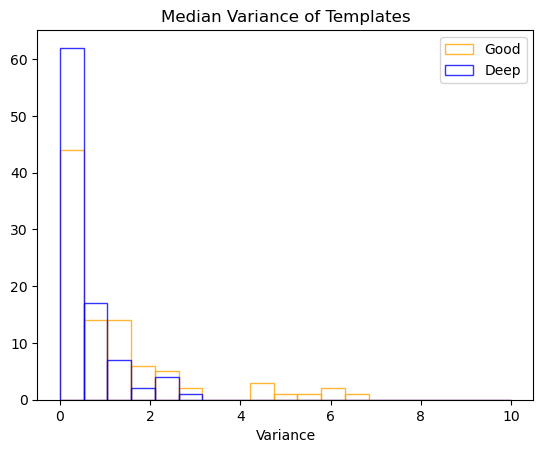

In [113]:
bins=np.linspace(0, 10, 20)
plt.hist(median_template_good, bins=bins, alpha=0.8, edgecolor='orange', label='Good', facecolor="None")
plt.hist(median_template_deep, bins=bins, alpha=0.8, edgecolor='blue', label='Deep', facecolor="None")
plt.xlabel('Variance')
plt.title('Median Variance of Templates')
plt.legend()

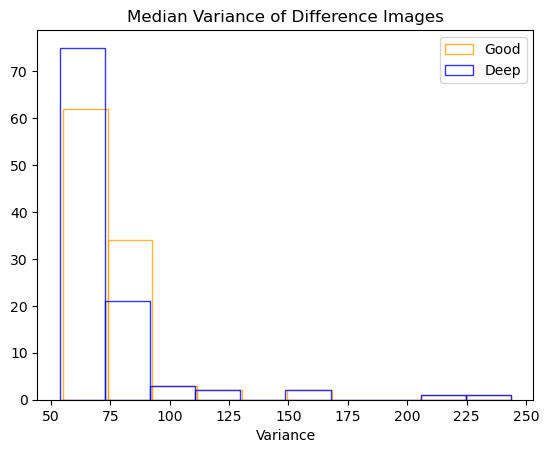

In [112]:
# bins=np.linspace(0, 10, 20)
plt.hist(median_diff_good, alpha=0.8, edgecolor='orange', label='Good', facecolor="None")
plt.hist(median_diff_deep, alpha=0.8, edgecolor='blue', label='Deep', facecolor="None")
plt.xlabel('Variance')
plt.title('Median Variance of Difference Images')
plt.legend()

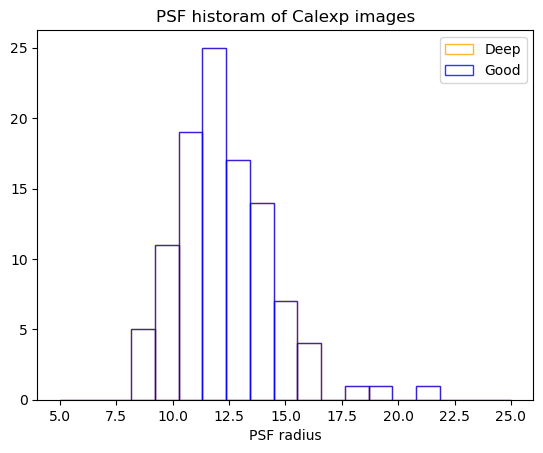

In [114]:
bins=np.linspace(5, 25, 20)
plt.hist(psf_radius_calexp_deep, bins=bins, alpha=0.8, edgecolor='orange', label='Deep', facecolor="None")
plt.hist(psf_radius_calexp_good, bins=bins, alpha=0.8, edgecolor='blue', label='Good', facecolor="None")
plt.xlabel('PSF radius')
plt.title('PSF historam of Calexp images')
plt.legend()

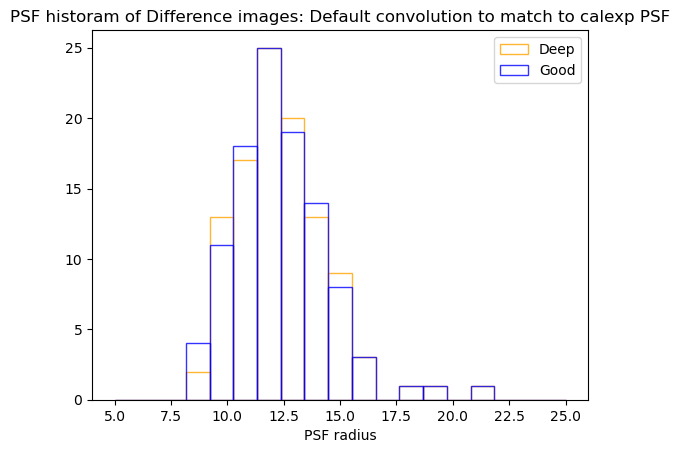

In [119]:
bins=np.linspace(5, 25, 20)
plt.hist(psf_radius_diff_deep, bins=bins, alpha=0.8, edgecolor='orange', label='Deep', facecolor="None")
plt.hist(psf_radius_diff_good, bins=bins, alpha=0.8, edgecolor='blue', label='Good', facecolor="None")
plt.xlabel('PSF radius')
plt.title('PSF historam of Difference images: Default convolution to match to calexp PSF')
plt.legend()

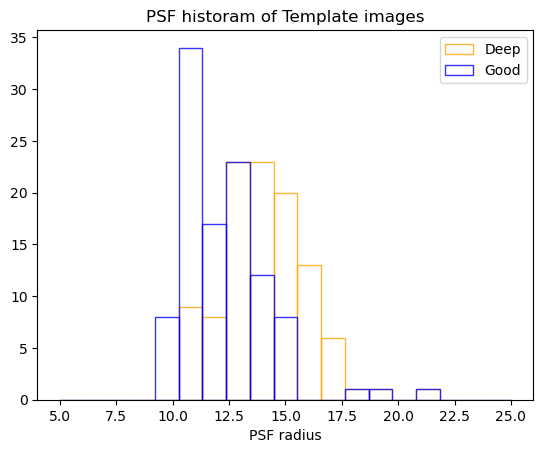

In [118]:
bins=np.linspace(5, 25, 20)
plt.hist(psf_radius_template_deep, bins=bins, alpha=0.8, edgecolor='orange', label='Deep', facecolor="None")
plt.hist(psf_radius_template_good,bins=bins,  alpha=0.8, edgecolor='blue', label='Good', facecolor="None")
plt.xlabel('PSF radius')
plt.title('PSF historam of Template images')
plt.legend()

Text(0, 0.5, 'Good Template PSF')

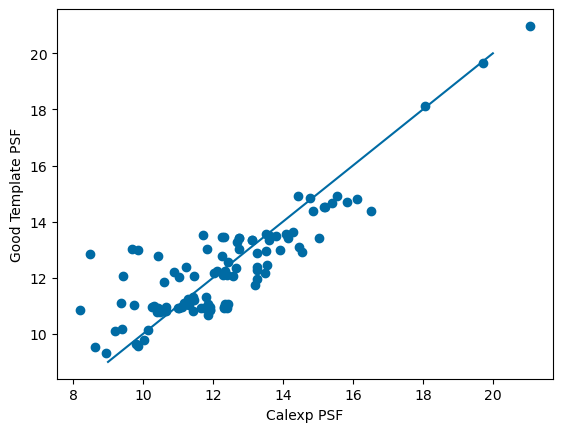

In [135]:
plt.scatter(median_df['calexp psf'], median_df['template psf good'])
plt.plot([9,20], [9, 20])
plt.xlabel('Calexp PSF')
plt.ylabel('Good Template PSF')

Text(0, 0.5, 'Deep Template PSF')

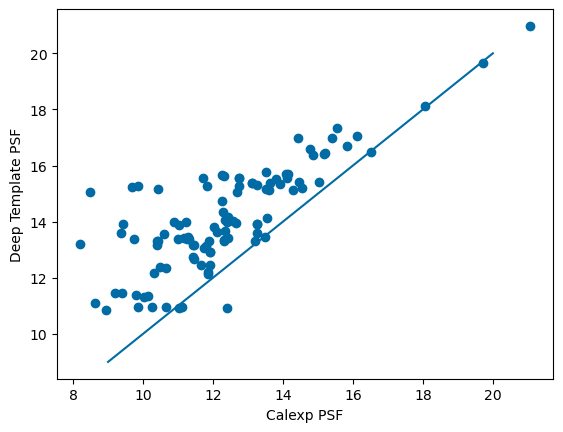

In [136]:
plt.scatter(median_df['calexp psf'], median_df['template psf deep'])
plt.plot([9,20], [9, 20])
plt.xlabel('Calexp PSF')
plt.ylabel('Deep Template PSF')

In [30]:
# Select rows where good psf < visit psf < deep psf 
df_interesting_visits =  median_df[(median_df['calexp psf'] > median_df['template psf good']) 
                                    & (median_df['calexp psf'] < median_df['template psf deep'])]

In [32]:
# Select rows where visit psf < deep psf and good psf
df_visitpsf_lt_good_deep =  median_df[(median_df['calexp psf'] < median_df['template psf good']) 
                                    & (median_df['calexp psf'] < median_df['template psf deep'])]

In [33]:
# Select rows where deep psf < visit psf < good psf 
df_visitpsf_lt_good_gt_deep =  median_df[(median_df['calexp psf'] < median_df['template psf good']) 
                                    & (median_df['calexp psf'] > median_df['template psf deep'])]

In [126]:
df_visitpsf_gt_deep = median_df[(median_df['calexp psf'] > median_df['template psf deep'])]
df_visitpsf_lt_deep = median_df[(median_df['calexp psf'] < median_df['template psf deep'])]

In [128]:
df_visitpsf_gt_good = median_df[(median_df['calexp psf'] > median_df['template psf good'])]
df_visitpsf_lt_good = median_df[(median_df['calexp psf'] < median_df['template psf good'])]

In [130]:
len(df_visitpsf_lt_good)

43

In [131]:
len(df_visitpsf_gt_good)

62

In [127]:
df_visitpsf_lt_deep

,num of visits in good coadd,num of visits in deep coadd,visit,median calexp variance,median template variance good,median template variance deep,median diff variance good,median diff variance deep,calexp psf,template psf good,template psf deep,diff psf good,diff psf deep
2,2,2,2023070400596,177.001007,18.264999,18.264999,216.212006,216.212006,18.046827,18.112374,18.112374,18.124222,18.124222
3,5,5,2023110700574,91.388000,2.617000,2.617000,71.614998,71.614998,10.254188,10.959142,10.959142,10.346195,10.346195
5,5,5,2023110700583,91.827003,2.618000,2.618000,71.058998,71.058998,10.649929,10.963208,10.963208,10.637391,10.637391
8,4,12,2023112100225,99.932999,74.866997,29.339001,79.172997,71.922997,13.101633,13.349435,15.393796,13.149541,13.300526
9,4,12,2023112100229,99.747002,76.961998,29.172001,78.597000,72.007004,15.021057,13.410062,15.410975,14.781770,14.967586
...,...,...,...,...,...,...,...,...,...,...,...,...,...
100,119,350,2023082900447,88.174004,0.407000,0.154000,60.330002,59.433998,12.316392,13.454737,15.639308,12.373565,12.402822
101,119,350,2023072000225,100.964996,0.401000,0.148000,69.805000,68.864998,13.808736,13.496765,15.508447,13.870755,13.896861
102,119,350,2023080300326,97.361000,0.484000,0.163000,70.803001,69.361000,10.434051,12.779612,15.157687,10.597310,10.644399
103,119,350,2023052400660,88.244003,0.493000,0.198000,60.641998,59.773998,11.728412,13.511969,15.540431,11.863789,11.903730


In [125]:
df_visitpsf_gt_deep

,num of visits in good coadd,num of visits in deep coadd,visit,median calexp variance,median template variance good,median template variance deep,median diff variance good,median diff variance deep,calexp psf,template psf good,template psf deep,diff psf good,diff psf deep
0,1,1,2023070400574,130.858994,20.343000,20.343000,159.447998,159.447998,21.075004,20.976498,20.976498,21.070277,21.070277
1,2,2,2023070400488,191.011993,20.851999,20.851999,243.628006,243.628006,19.727229,19.668739,19.668739,19.680002,19.680002
4,5,5,2023110700580,91.230003,2.617000,2.617000,71.345001,71.345001,11.106005,10.958482,10.958482,11.094817,11.094817
6,5,5,2023110700593,91.539001,2.610000,2.610000,72.488998,72.488998,11.032221,10.915388,10.915388,10.988867,10.988867
7,5,5,2023110700596,92.405998,2.635000,2.635000,73.379997,73.379997,12.389783,10.921618,10.921618,12.207122,12.207122
37,22,54,2023110800326,86.994003,1.142000,0.506000,60.522999,58.761002,13.486013,12.164931,13.454931,13.441950,13.501279
85,102,265,2023072000163,173.468994,0.362000,0.159000,130.250000,129.320999,16.511081,14.365821,16.474051,16.462567,16.478930


In [122]:
print('fraction of visits with good template psf < visit psf < deep template psf : ', len(df_interesting_visits)/len(median_df))
print('fraction of visits with visit psf < good and deep template: ', len(df_visitpsf_lt_good_deep)/len(median_df))
print('fraction of visits with deep template psf < visit psf < good template psf: ', len(df_visitpsf_lt_good_gt_deep)/len(median_df))

fraction of visits with good template psf < visit psf < deep template psf :  0.5238095238095238
fraction of visits with visit psf < good and deep template:  0.4095238095238095
fraction of visits with deep template psf < visit psf < good template psf:  0.0


In [123]:
df_visitpsf_lt_good_deep

,num of visits in good coadd,num of visits in deep coadd,visit,median calexp variance,median template variance good,median template variance deep,median diff variance good,median diff variance deep,calexp psf,template psf good,template psf deep,diff psf good,diff psf deep
2,2,2,2023070400596,177.001007,18.264999,18.264999,216.212006,216.212006,18.046827,18.112374,18.112374,18.124222,18.124222
3,5,5,2023110700574,91.388000,2.617000,2.617000,71.614998,71.614998,10.254188,10.959142,10.959142,10.346195,10.346195
5,5,5,2023110700583,91.827003,2.618000,2.618000,71.058998,71.058998,10.649929,10.963208,10.963208,10.637391,10.637391
8,4,12,2023112100225,99.932999,74.866997,29.339001,79.172997,71.922997,13.101633,13.349435,15.393796,13.149541,13.300526
10,4,12,2023112100233,99.328003,80.362999,30.136000,81.377998,71.614998,12.744674,13.401761,15.558442,12.852517,13.032407
13,5,17,2023112100221,99.649002,75.235001,30.617001,77.614998,72.037003,12.697673,13.291249,15.056567,12.726145,12.857832
14,5,17,2023112100225,99.932999,74.866997,29.339001,79.172997,71.922997,13.101633,13.349435,15.393796,13.149541,13.300526
15,5,17,2023112100233,99.328003,80.362999,30.136000,81.377998,71.614998,12.744674,13.401761,15.558442,12.852517,13.032407
16,5,17,2023112800294,101.475998,84.889999,35.938000,83.390999,75.611000,12.256736,12.789773,14.725459,12.510066,12.752838
17,8,21,2023051100399,104.079002,4.692000,1.111000,82.436996,75.789001,9.194159,10.117110,11.445723,9.319555,9.382541


In [31]:
df_interesting_visits

,num of visits in good coadd,num of visits in deep coadd,visit,median calexp variance,median template variance good,median template variance deep,median diff variance good,median diff variance deep,calexp psf,template psf good,template psf deep,diff psf good,diff psf deep
9,4,12,2023112100229,99.747002,76.961998,29.172001,78.597000,72.007004,15.021057,13.410062,15.410975,14.781770,14.967586
11,4,12,2023112900295,96.056999,72.188004,30.544001,76.362999,71.544998,14.295761,13.625765,15.141082,14.206417,14.329336
12,5,17,2023112100217,100.000000,78.348000,34.931999,82.113998,74.794998,13.602319,13.331873,15.118600,13.605049,13.750559
19,8,21,2023051100498,101.350998,5.384000,1.357000,83.485001,76.755997,9.855399,9.565963,10.956974,9.819019,9.913657
20,8,21,2023051100499,109.116997,5.961000,1.192000,84.524002,78.519997,10.146453,10.125734,11.339148,10.163865,10.210714
21,8,21,2023051100529,102.455002,4.416000,1.142000,84.962997,74.772003,9.812763,9.635124,11.402681,9.772587,9.836236
22,8,21,2023051100543,91.910004,4.215000,1.076000,80.318001,67.275002,10.019241,9.766512,11.306164,9.983416,10.115331
28,16,41,2023111300188,95.712997,1.224000,0.522000,68.268997,66.259003,11.425048,11.306551,12.737660,11.404652,11.448572
29,16,41,2023111300197,98.202003,1.310000,0.557000,72.033997,69.226997,11.867995,11.063433,12.134283,11.866068,11.939356
30,16,41,2023110800342,97.263000,1.568000,0.628000,75.003998,68.950996,11.807414,11.328581,13.126326,11.815110,11.909256


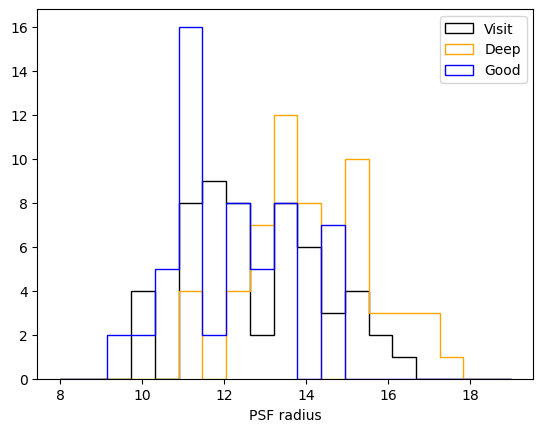

In [67]:
bins=np.linspace(8, 19, 20)
plt.hist(df_interesting_visits['calexp psf'], bins=bins, alpha=1.0, edgecolor='k',  histtype='step', label='Visit')
plt.hist(df_interesting_visits['template psf deep'], bins=bins, alpha=1.0, edgecolor='orange',  histtype='step', label='Deep')
plt.hist(df_interesting_visits['template psf good'], bins=bins, alpha=1.0, edgecolor='blue',  histtype='step', label='Good')
plt.xlabel('PSF radius')
# plt.title('PSF historam of Template images')
plt.legend()

In [91]:
diff_visit_good = df_interesting_visits['calexp psf'].values - df_interesting_visits['template psf good'].values
diff_visit_deep =  df_interesting_visits['template psf deep'].values - df_interesting_visits['calexp psf'].values

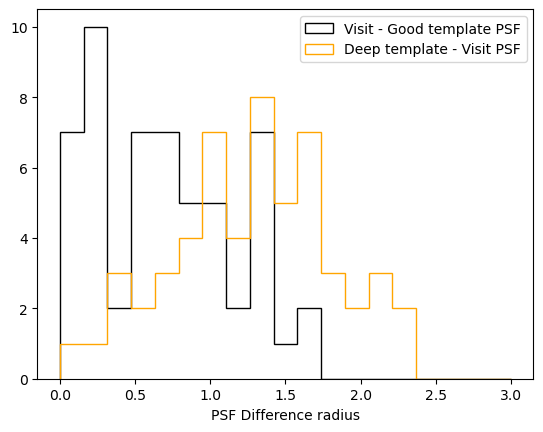

In [97]:
bins=np.linspace(0.0, 3.0, 20)
plt.hist(diff_visit_good, bins=bins, alpha=1.0, edgecolor='k',  histtype='step', label='Visit - Good template PSF')
plt.hist(diff_visit_deep, bins=bins, alpha=1.0, edgecolor='orange',  histtype='step', label='Deep template - Visit PSF')
plt.xlabel('PSF Difference radius')
# plt.title('PSF historam of Template images')
plt.legend()

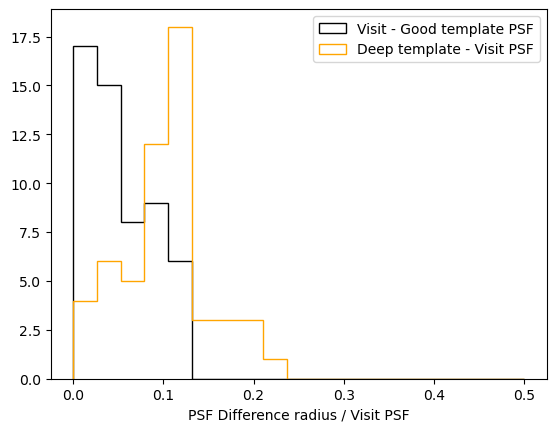

In [99]:
bins=np.linspace(0.0, 0.5, 20)
plt.hist(diff_visit_good/df_interesting_visits['calexp psf'].values, bins=bins, alpha=1.0, edgecolor='k',  histtype='step', label='Visit - Good template PSF')
plt.hist(diff_visit_deep/df_interesting_visits['calexp psf'].values, bins=bins, alpha=1.0, edgecolor='orange',  histtype='step', label='Deep template - Visit PSF')
plt.xlabel('PSF Difference radius / Visit PSF')
# plt.title('PSF historam of Template images')
plt.legend()

### SNR of interesting visits

Visit psf - Good psf:  1.611
Deep psf - Visit psf:  0.39


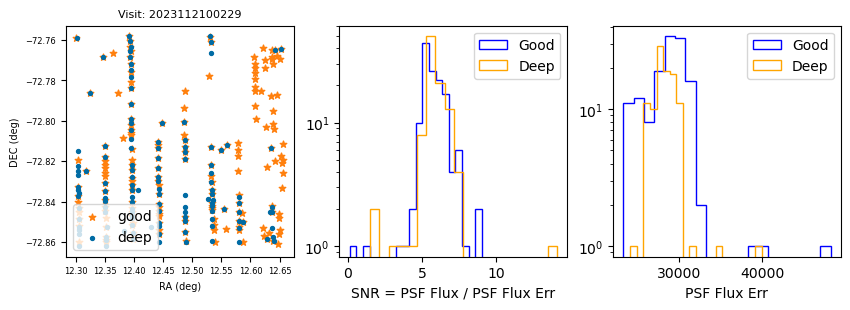

Visit psf - Good psf:  0.67
Deep psf - Visit psf:  0.845


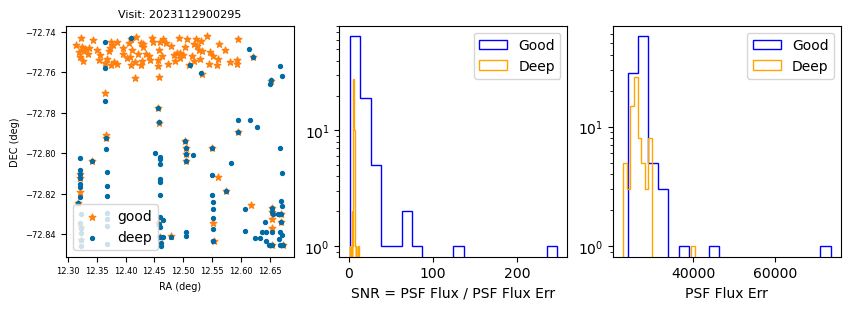

Visit psf - Good psf:  0.27
Deep psf - Visit psf:  1.516


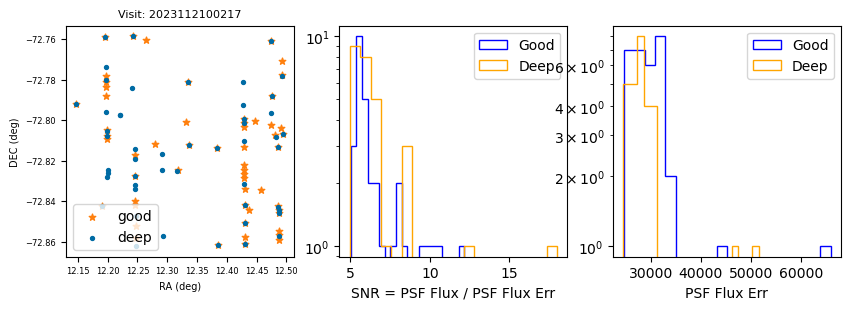

Visit psf - Good psf:  0.289
Deep psf - Visit psf:  1.102


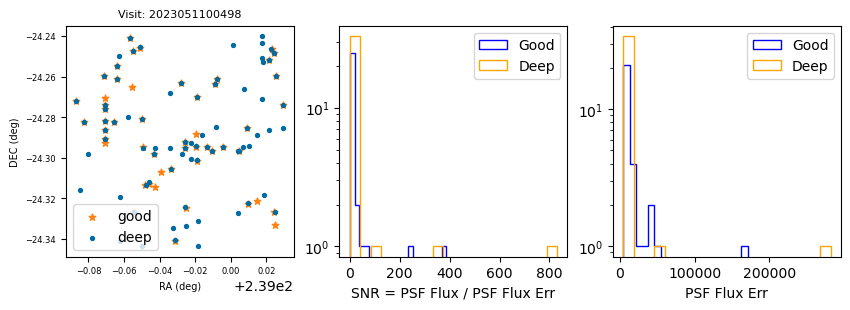

Visit psf - Good psf:  0.021
Deep psf - Visit psf:  1.193


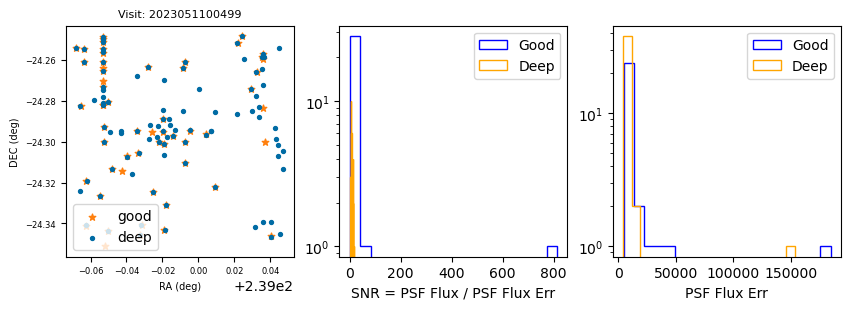

Visit psf - Good psf:  0.178
Deep psf - Visit psf:  1.59


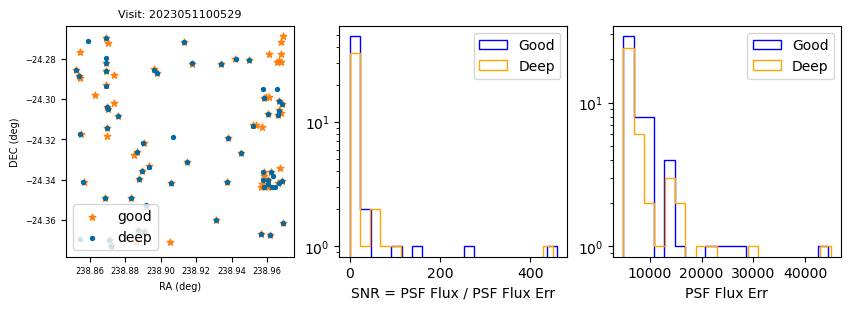

Visit psf - Good psf:  0.253
Deep psf - Visit psf:  1.287


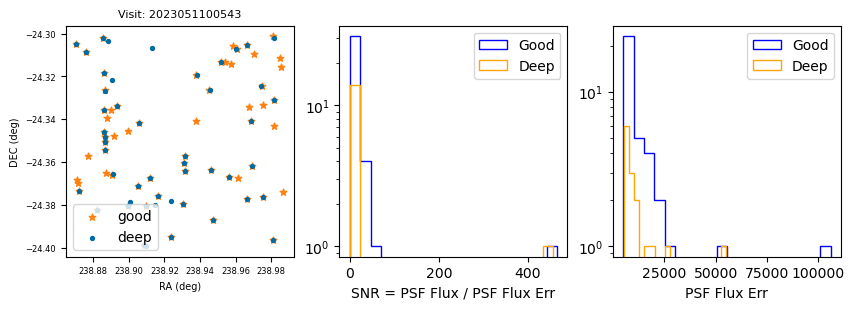

Visit psf - Good psf:  0.118
Deep psf - Visit psf:  1.313


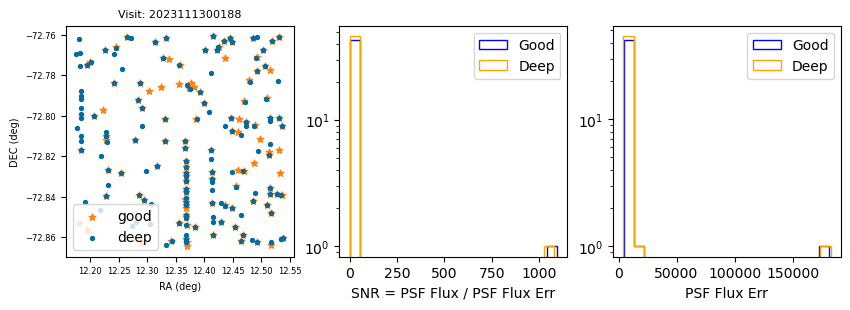

Visit psf - Good psf:  0.805
Deep psf - Visit psf:  0.266


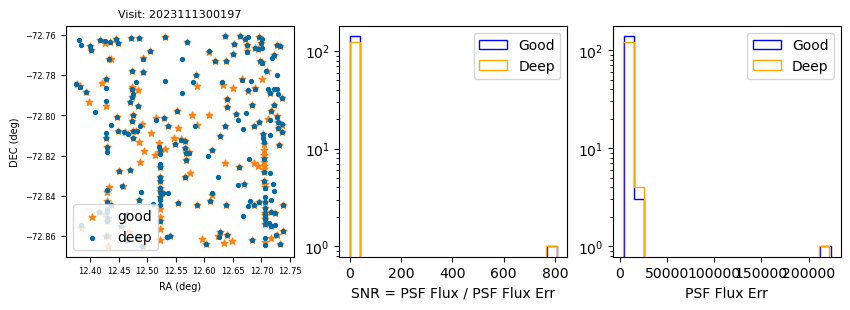

Visit psf - Good psf:  0.479
Deep psf - Visit psf:  1.319


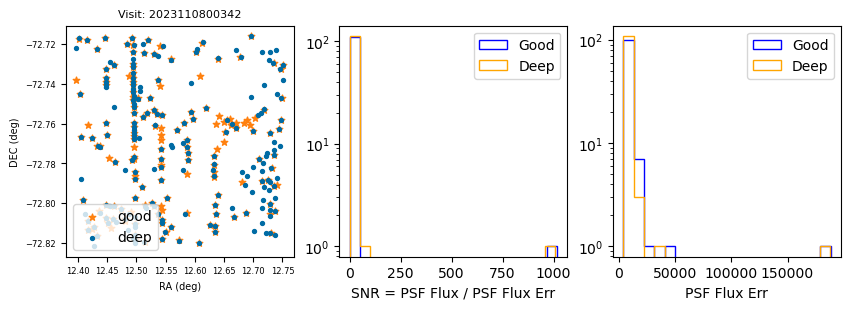

Visit psf - Good psf:  0.229
Deep psf - Visit psf:  1.233


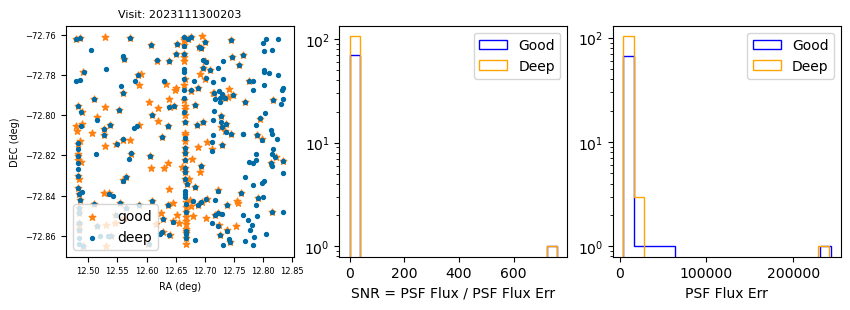

Visit psf - Good psf:  0.729
Deep psf - Visit psf:  0.799


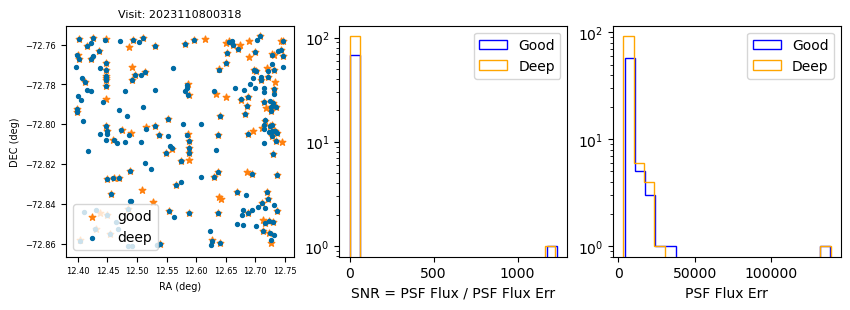

Visit psf - Good psf:  1.2
Deep psf - Visit psf:  0.352


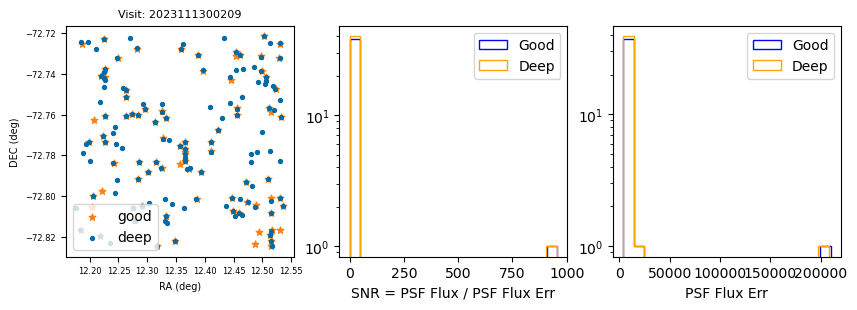

Visit psf - Good psf:  0.94
Deep psf - Visit psf:  0.524


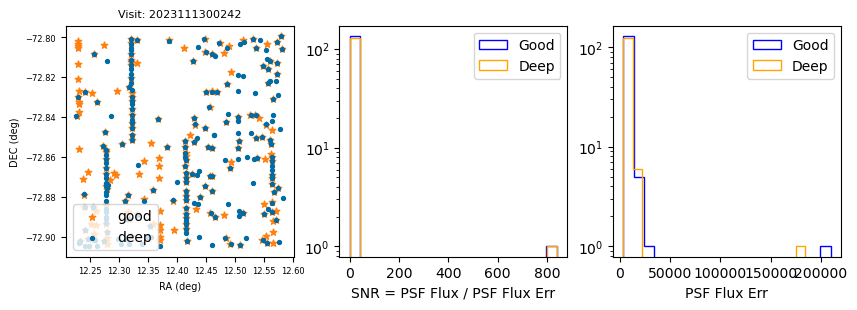

Visit psf - Good psf:  0.848
Deep psf - Visit psf:  0.661


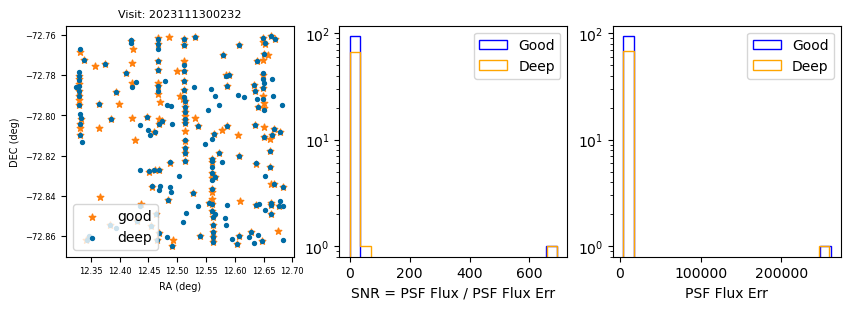

Visit psf - Good psf:  0.33
Deep psf - Visit psf:  1.283


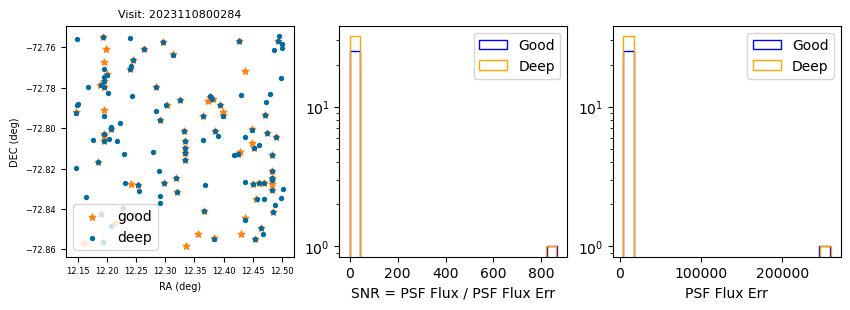

Visit psf - Good psf:  1.321
Deep psf - Visit psf:  0.318


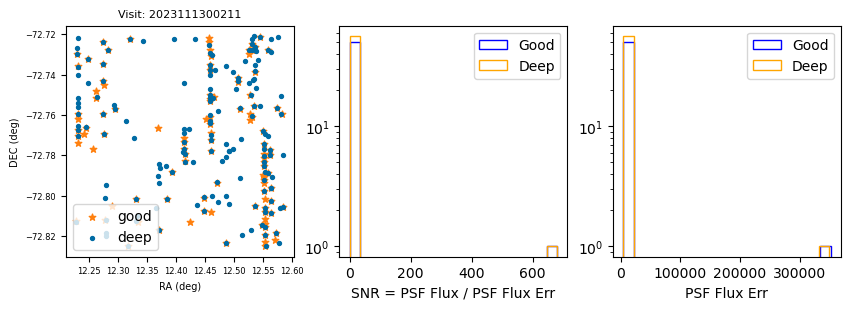

Visit psf - Good psf:  1.101
Deep psf - Visit psf:  0.592


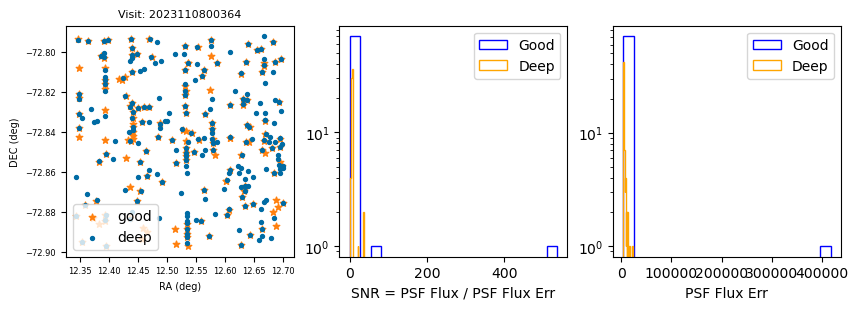

Visit psf - Good psf:  1.441
Deep psf - Visit psf:  0.111


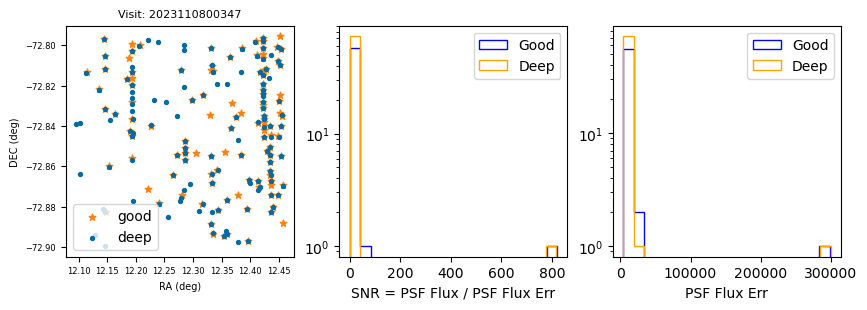

Visit psf - Good psf:  1.057
Deep psf - Visit psf:  1.007


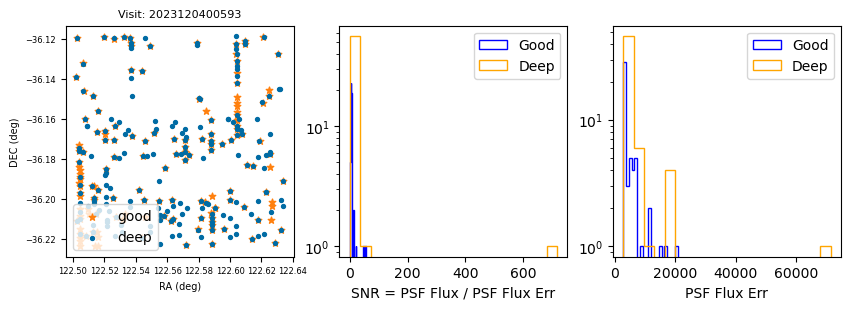

Visit psf - Good psf:  0.595
Deep psf - Visit psf:  1.743


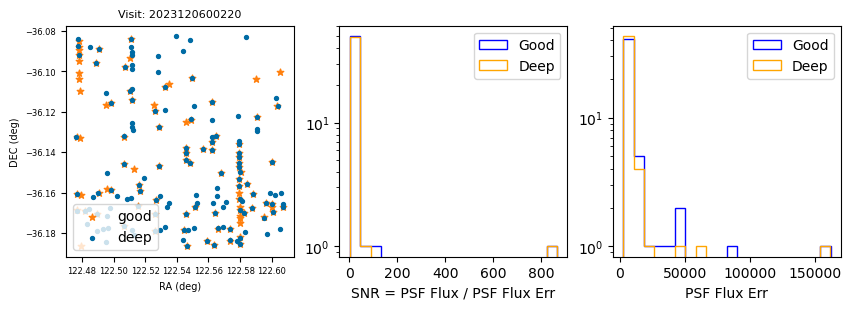

Visit psf - Good psf:  0.094
Deep psf - Visit psf:  2.368


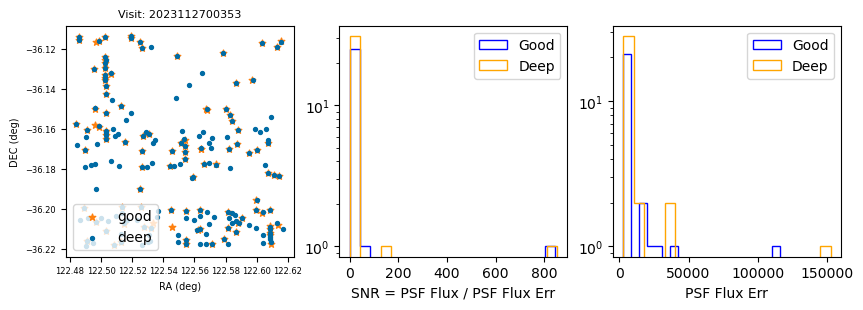

Visit psf - Good psf:  0.282
Deep psf - Visit psf:  2.078


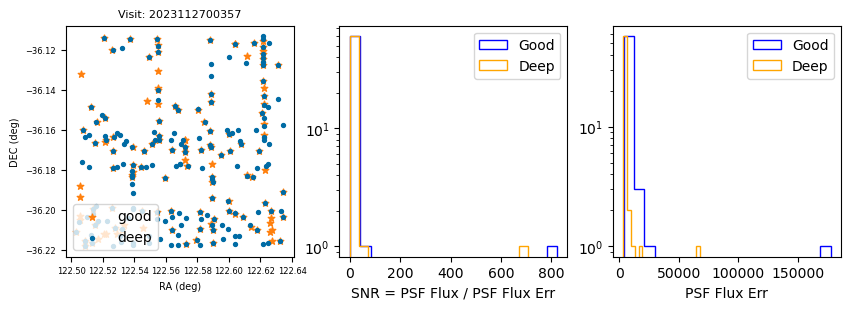

Visit psf - Good psf:  1.414
Deep psf - Visit psf:  0.987


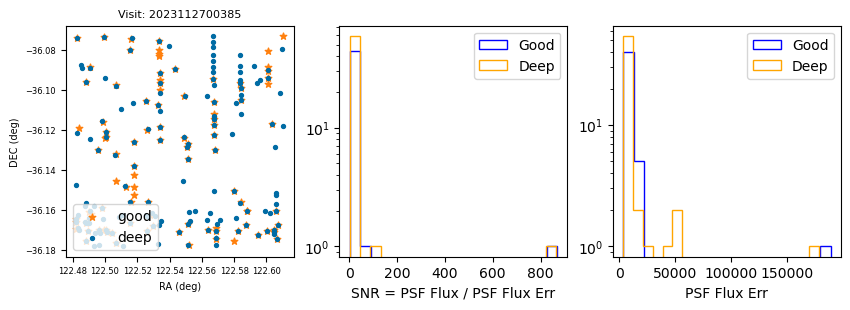

Visit psf - Good psf:  1.02
Deep psf - Visit psf:  1.412


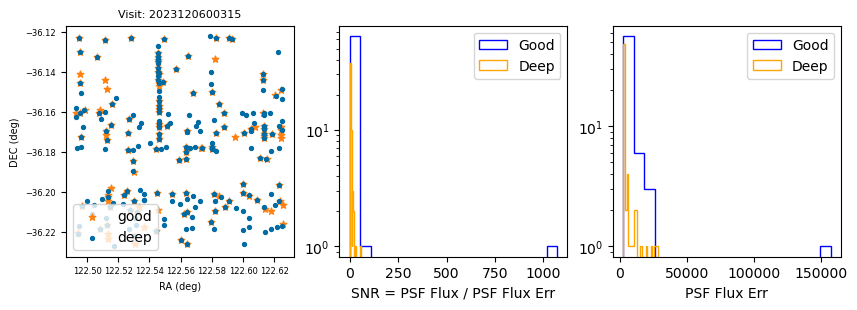

Visit psf - Good psf:  0.113
Deep psf - Visit psf:  1.72


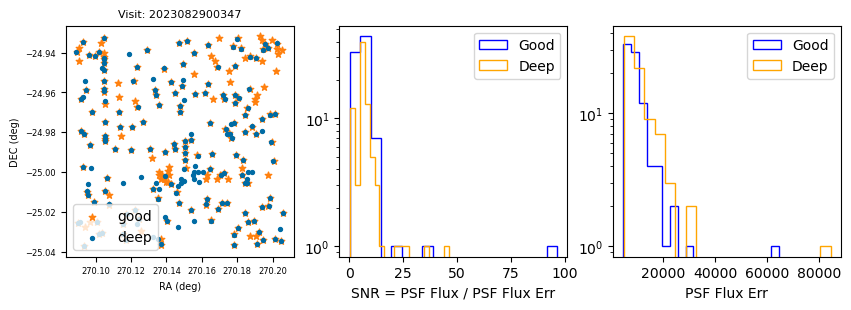

Visit psf - Good psf:  0.29
Deep psf - Visit psf:  1.583


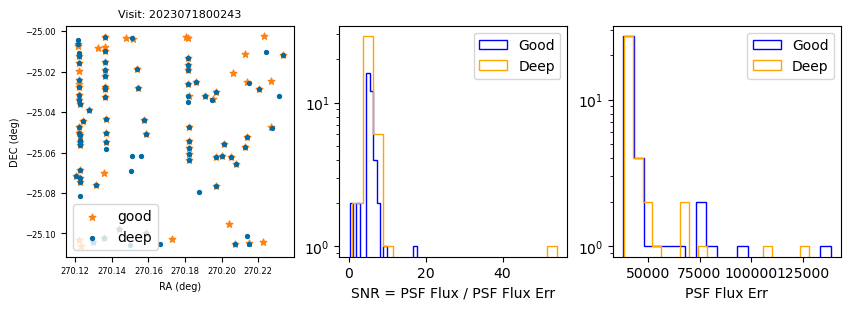

Visit psf - Good psf:  0.51
Deep psf - Visit psf:  1.431


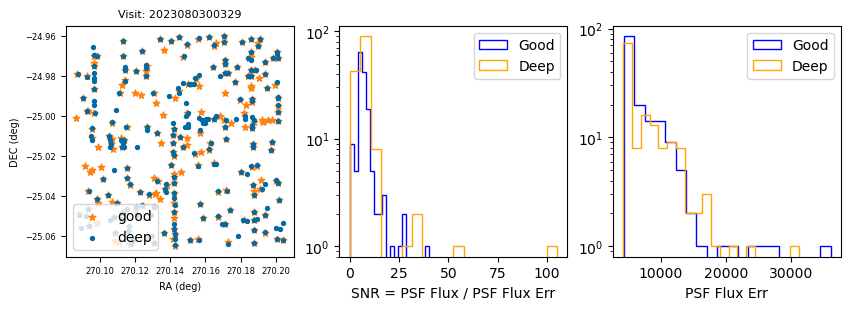

Visit psf - Good psf:  0.201
Deep psf - Visit psf:  2.047


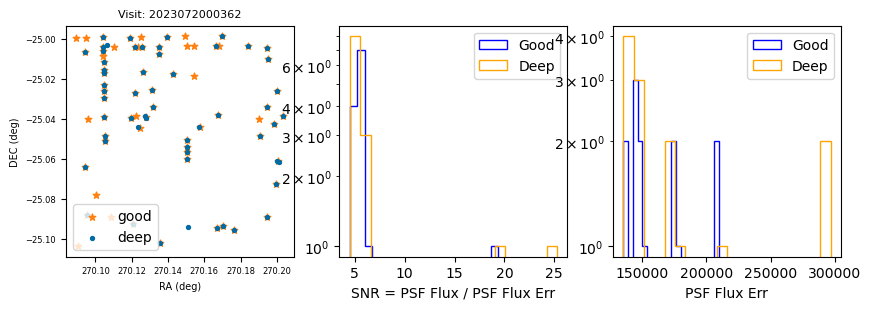

Visit psf - Good psf:  0.99
Deep psf - Visit psf:  0.65


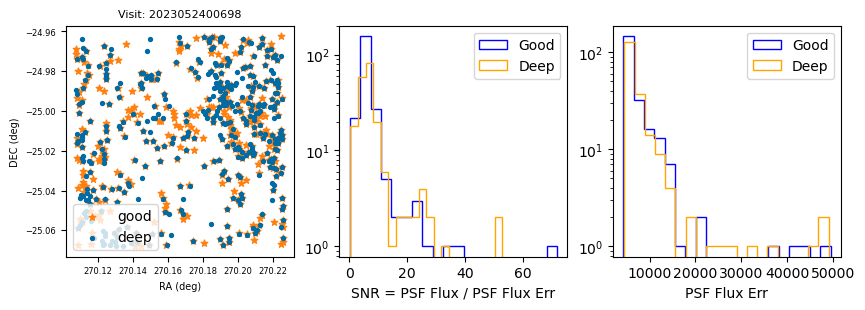

Visit psf - Good psf:  1.373
Deep psf - Visit psf:  0.957


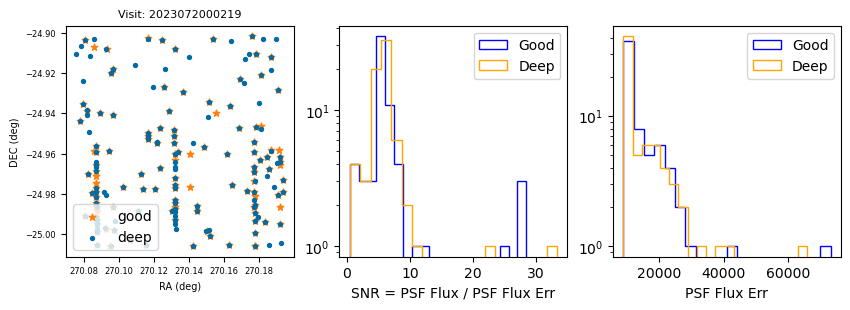

Visit psf - Good psf:  0.542
Deep psf - Visit psf:  1.598


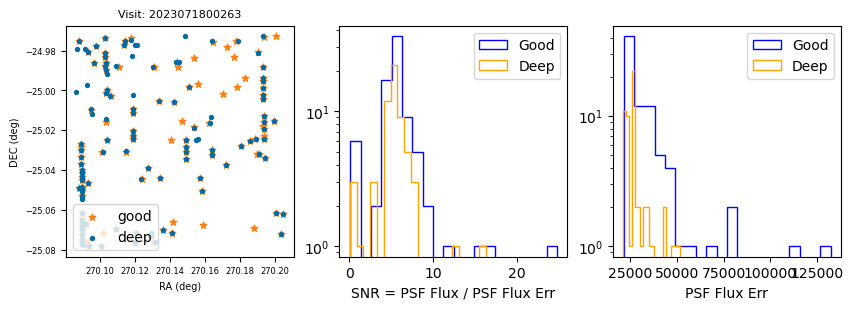

Visit psf - Good psf:  0.358
Deep psf - Visit psf:  2.046


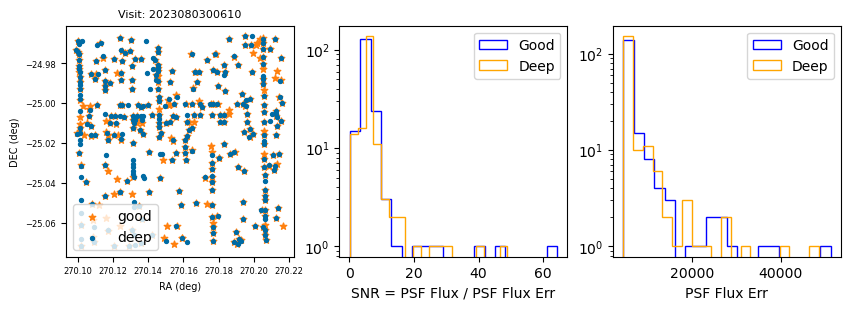

Visit psf - Good psf:  0.57
Deep psf - Visit psf:  1.619


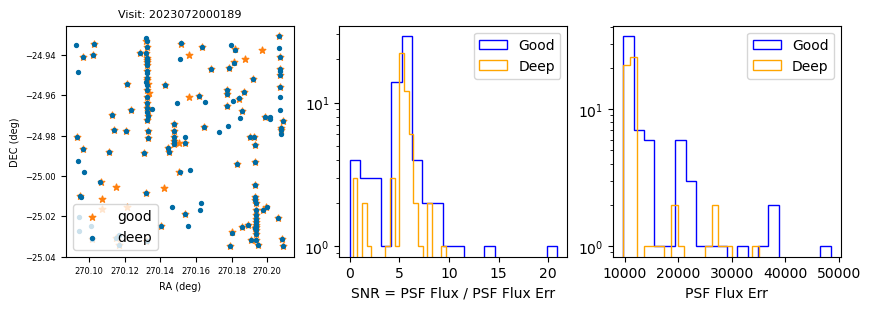

Visit psf - Good psf:  1.057
Deep psf - Visit psf:  1.007


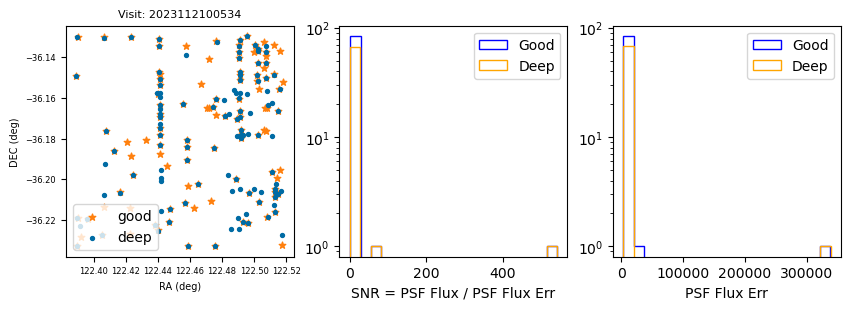

Visit psf - Good psf:  1.357
Deep psf - Visit psf:  1.042


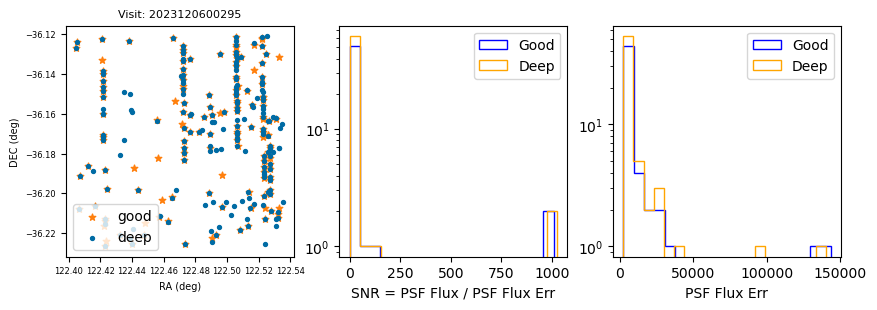

Visit psf - Good psf:  0.047
Deep psf - Visit psf:  2.167


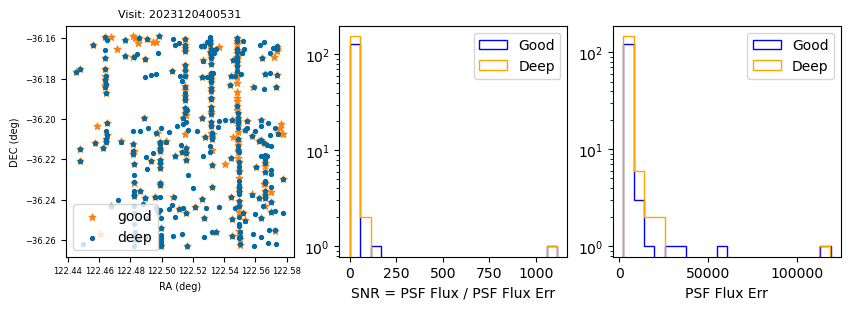

Visit psf - Good psf:  0.044
Deep psf - Visit psf:  2.276


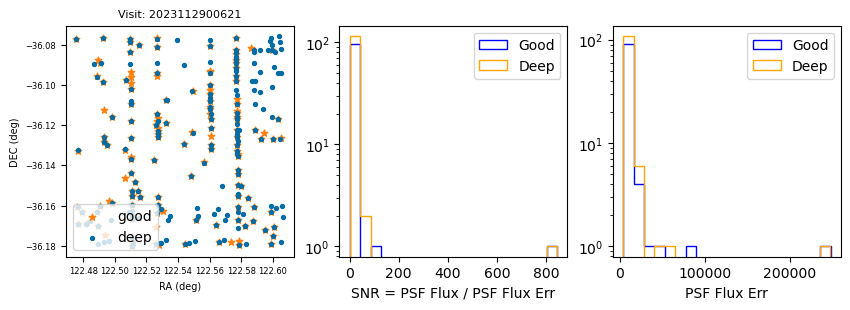

Visit psf - Good psf:  0.166
Deep psf - Visit psf:  2.123


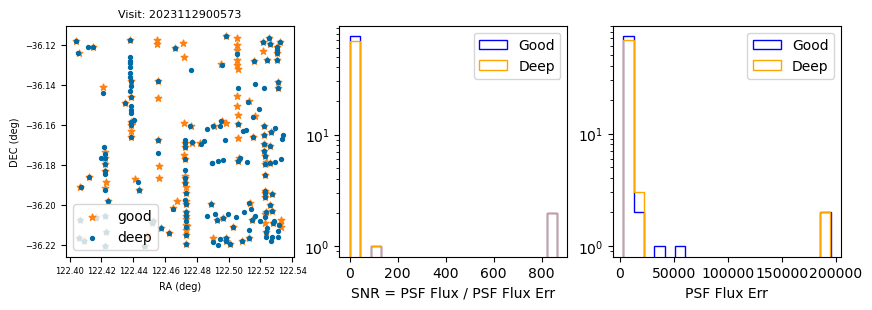

Visit psf - Good psf:  0.834
Deep psf - Visit psf:  1.315


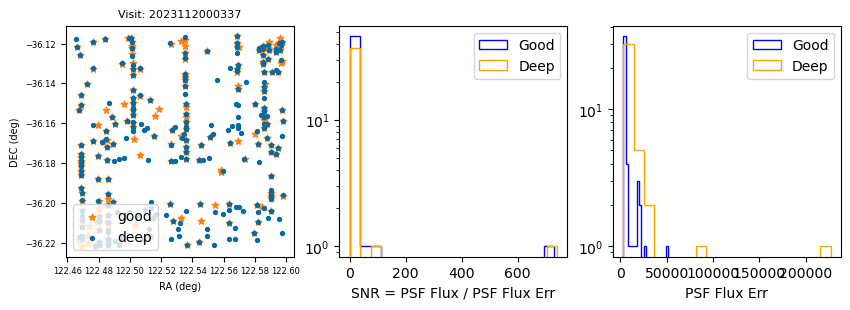

Visit psf - Good psf:  1.414
Deep psf - Visit psf:  0.987


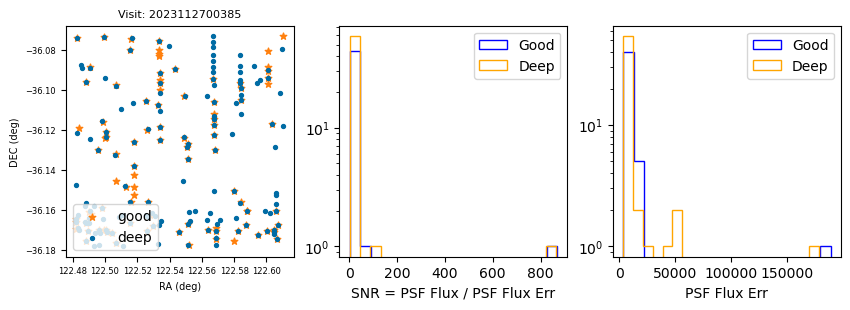

Visit psf - Good psf:  1.292
Deep psf - Visit psf:  1.311


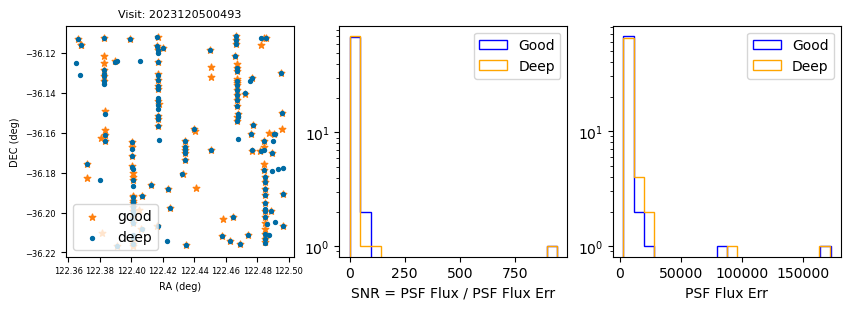

Visit psf - Good psf:  1.314
Deep psf - Visit psf:  0.932


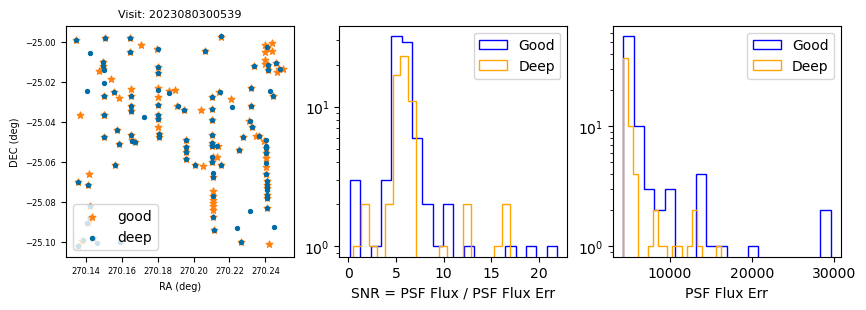

Visit psf - Good psf:  0.703
Deep psf - Visit psf:  1.238


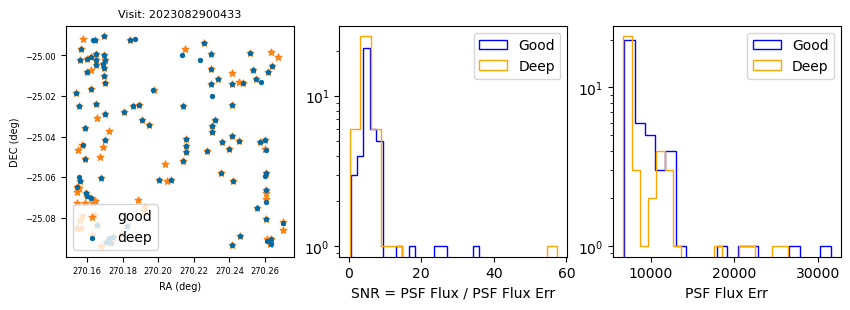

Visit psf - Good psf:  0.733
Deep psf - Visit psf:  1.586


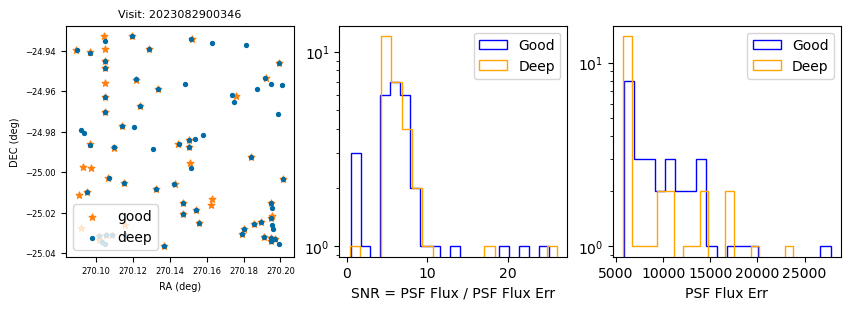

Visit psf - Good psf:  0.654
Deep psf - Visit psf:  1.228


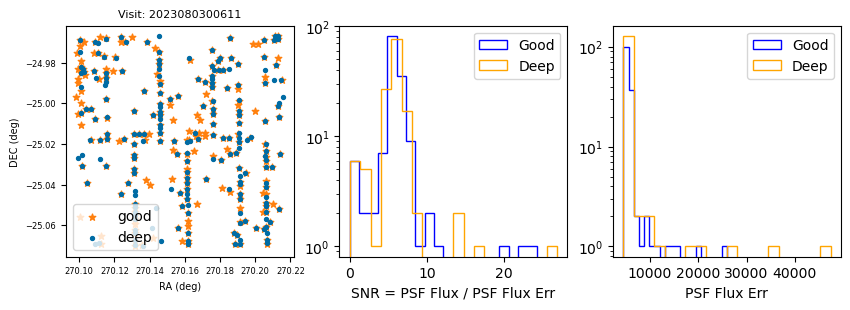

Visit psf - Good psf:  0.485
Deep psf - Visit psf:  1.505


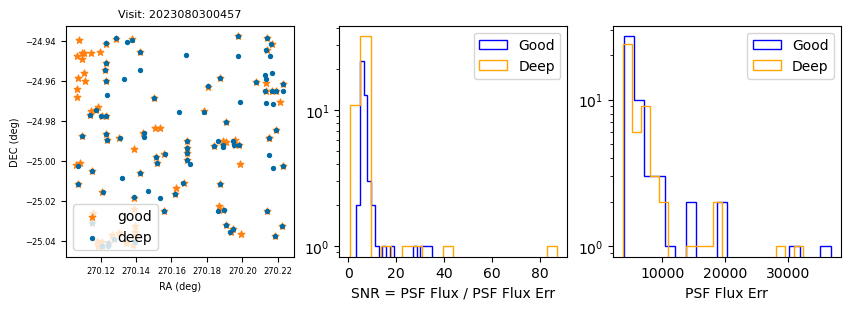

Visit psf - Good psf:  0.637
Deep psf - Visit psf:  1.774


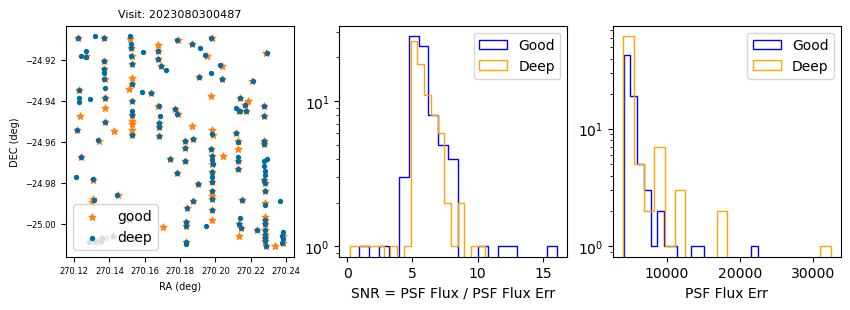

Visit psf - Good psf:  1.15
Deep psf - Visit psf:  0.866


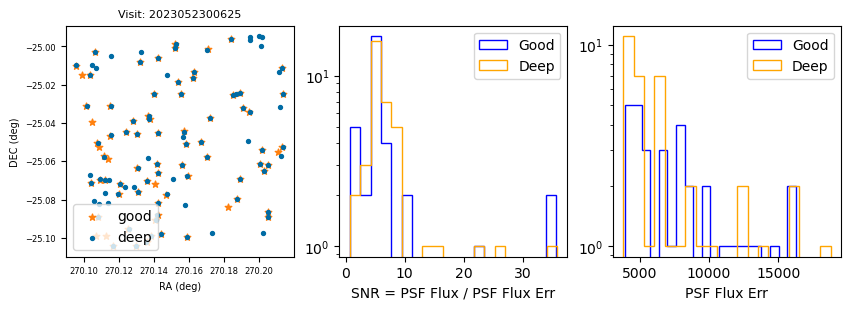

Visit psf - Good psf:  0.154
Deep psf - Visit psf:  1.752


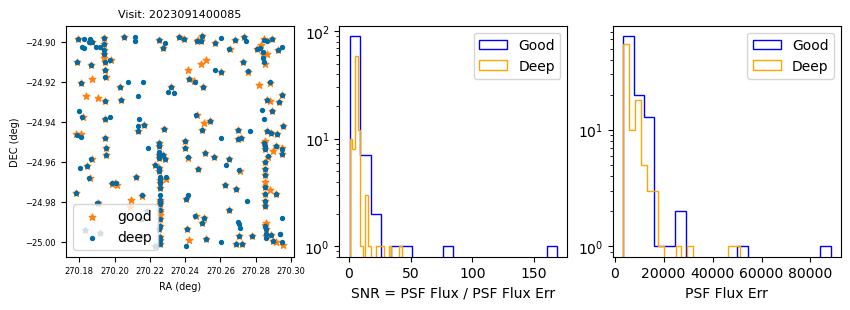

Visit psf - Good psf:  0.935
Deep psf - Visit psf:  1.403


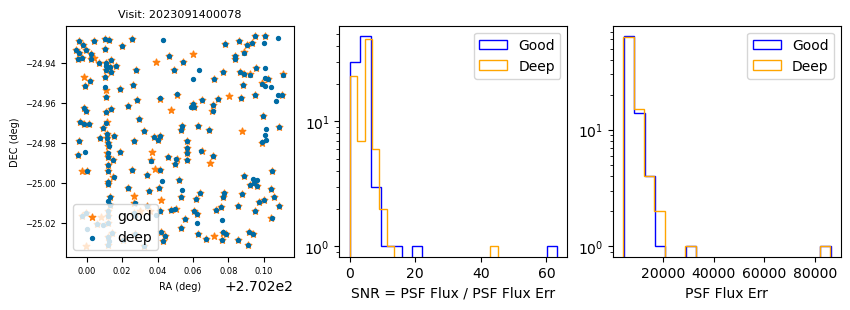

Visit psf - Good psf:  0.725
Deep psf - Visit psf:  1.544


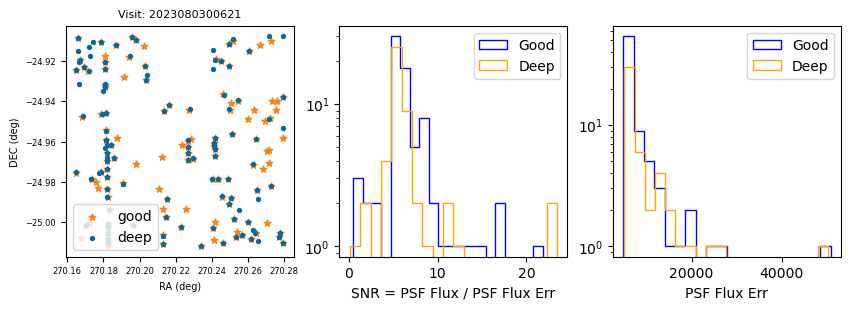

Visit psf - Good psf:  1.622
Deep psf - Visit psf:  0.663


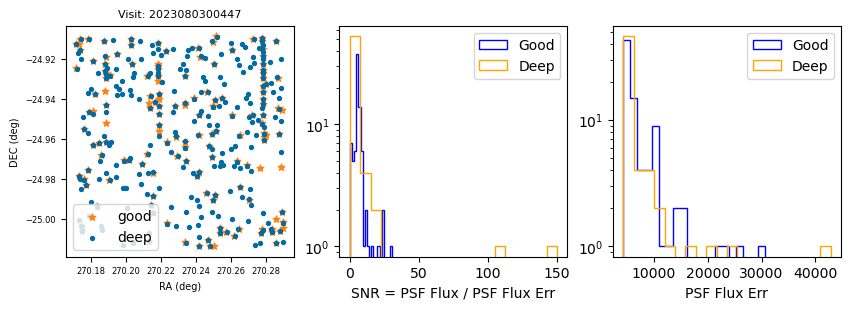

Visit psf - Good psf:  0.58
Deep psf - Visit psf:  1.441


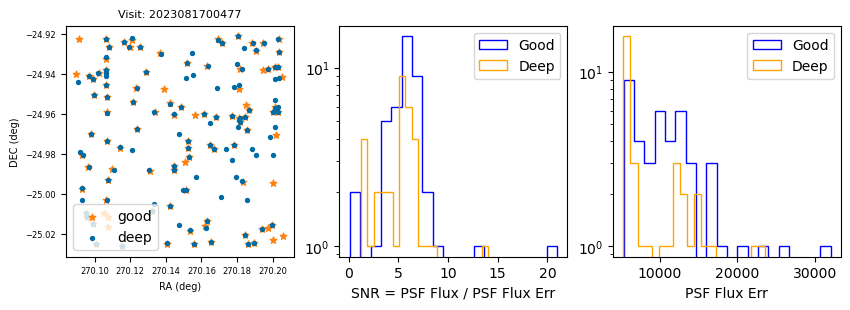

Visit psf - Good psf:  0.312
Deep psf - Visit psf:  1.7


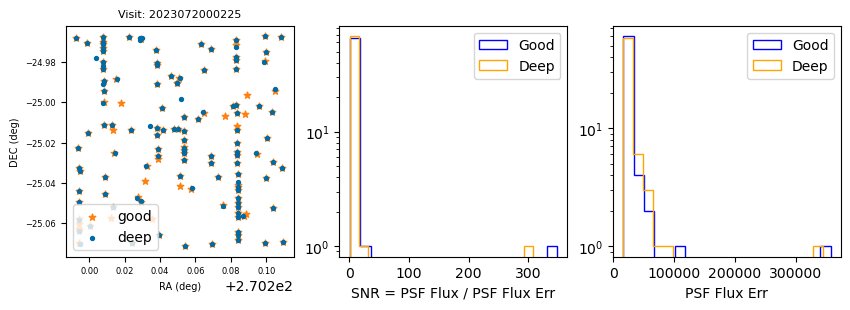

In [84]:
for visit in df_interesting_visits['visit']:
    
    fig, axs = plt.subplots(1, 3, figsize=(10,3), facecolor='w', edgecolor='k')
    fig.subplots_adjust(hspace = .3, wspace=.2)
    axs = axs.ravel()

    DiaSourceTable_good = butler_good.get('goodSeeingDiff_diaSrcTable', visit=visit, detector=0)
    DiaSourceTable_deep = butler_deep.get('goodSeeingDiff_diaSrcTable', visit=visit, detector=0)

    axs[0].scatter(DiaSourceTable_good['ra'], DiaSourceTable_good['dec'], s=24, color='C1', label='good', marker='*')
    axs[0].scatter(DiaSourceTable_deep['ra'], DiaSourceTable_deep['dec'], s=8, color='C0', label = 'deep')
    axs[0].set_title('Visit: '+ str(visit), fontsize=8)
    axs[0].set_xlabel('RA (deg)', fontsize=7)
    axs[0].set_ylabel('DEC (deg)', fontsize=7)
    axs[0].xaxis.set_tick_params(labelsize=6)
    axs[0].yaxis.set_tick_params(labelsize=6)
    axs[0].legend(loc='lower left')

    flux_df_good = DiaSourceTable_good[['psfFlux', 'psfFluxErr']]
    flux_df_good = flux_df_good[flux_df_good['psfFlux'] > 0]
    flux_df_deep = DiaSourceTable_deep[['psfFlux', 'psfFluxErr']]
    flux_df_deep = flux_df_deep[flux_df_deep['psfFlux'] > 0]
    flux_df_good['SNR'] = flux_df_good['psfFlux']/flux_df_good['psfFluxErr']
    flux_df_deep['SNR'] = flux_df_deep['psfFlux']/flux_df_deep['psfFluxErr']

    calexp_psf = df_interesting_visits[df_interesting_visits['visit'] == visit]['calexp psf'].values
    good_psf = df_interesting_visits[df_interesting_visits['visit'] == visit]['template psf good'].values
    deep_psf = df_interesting_visits[df_interesting_visits['visit'] == visit]['template psf deep'].values
    
    diff_visit_good = calexp_psf - good_psf
    diff_visit_deep = deep_psf - calexp_psf 

    print('Visit psf - Good psf: ', round(diff_visit_good[0],3))
    print('Deep psf - Visit psf: ', round(diff_visit_deep[0],3))

    # Plot SNR
    
    bins = 20

    axs[1].hist(flux_df_good['SNR'],bins=bins, histtype = 'step', alpha=1.0, edgecolor='blue', label='Good');
    axs[1].hist(flux_df_deep['SNR'],bins=bins, histtype = 'step', alpha=1.0, edgecolor='orange',label='Deep');
    
    axs[1].set_xlabel('SNR = PSF Flux / PSF Flux Err')
    axs[1].set_yscale('log')
    axs[1].legend(loc='upper right')

    # Plot psf flux error

    axs[2].hist(flux_df_good['psfFluxErr'],bins=bins, histtype = 'step', alpha=1.0, edgecolor='blue', label='Good');
    axs[2].hist(flux_df_deep['psfFluxErr'],bins=bins, histtype = 'step', alpha=1.0, edgecolor='orange',label='Deep');
    
    axs[2].set_xlabel('PSF Flux Err')
    axs[2].set_yscale('log')
    axs[2].legend(loc='upper right')

    
    plt.show()
    plt.close()



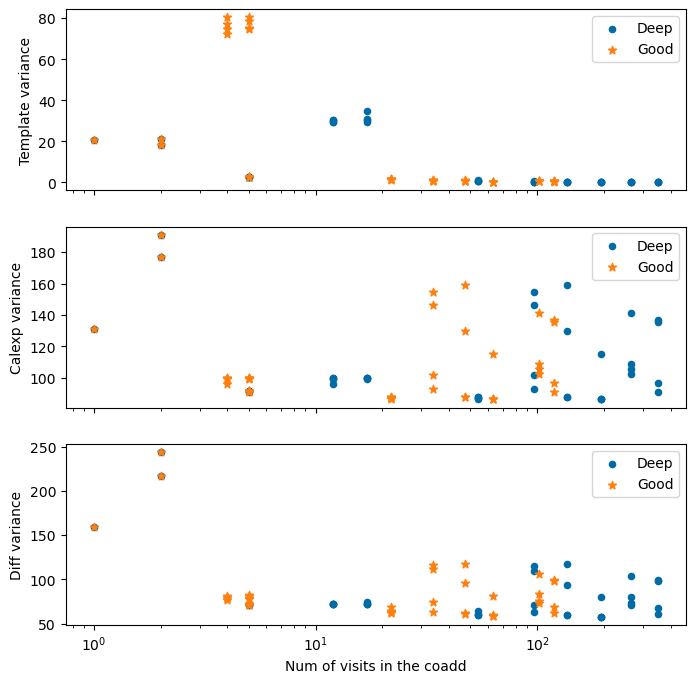

In [96]:
fig, (ax1, ax2, ax3) = plt.subplots(nrows=3, sharex=True, figsize=(8,8))

ax1.scatter(num_visits_deep, median_template_deep, marker='o', s=20, label='Deep')
ax1.scatter(num_visits_good, median_template_good, marker='*', label='Good')
ax1.set_ylabel('Template variance')
ax1.set_xscale('log')
ax1.legend()

ax2.scatter(num_visits_deep, median_calexp_deep, marker='o', s=20, label='Deep')
ax2.scatter(num_visits_good, median_calexp_good, marker='*', label='Good')
ax2.set_ylabel('Calexp variance')
ax2.legend()

ax3.scatter(num_visits_deep, median_diff_deep, marker='o', s=20, label='Deep')
ax3.scatter(num_visits_good, median_diff_good, marker='*', label='Good')
ax3.set_ylabel('Diff variance')
ax3.legend()

plt.xlabel('Num of visits in the coadd')


plt.show()

### Variance images of templates with more visits in coadd

In [50]:
normal_variance_list = dataId_list_all_templates[5:]

# plotting one visit 

for dataId_list in normal_variance_list:
    for dataId in dataId_list[::4]:
        print(dataId)

{instrument: 'LATISS', detector: 0, visit: 2023110800329, band: 'r', physical_filter: 'SDSSr_65mm~empty'}
{instrument: 'LATISS', detector: 0, visit: 2023052400686, band: 'i', physical_filter: 'SDSSi_65mm~empty'}
{instrument: 'LATISS', detector: 0, visit: 2023070600410, band: 'r', physical_filter: 'SDSSr_65mm~empty'}
{instrument: 'LATISS', detector: 0, visit: 2023120400519, band: 'g', physical_filter: 'SDSSg_65mm~empty'}
{instrument: 'LATISS', detector: 0, visit: 2023052400694, band: 'g', physical_filter: 'SDSSg_65mm~empty'}
{instrument: 'LATISS', detector: 0, visit: 2023070600376, band: 'r', physical_filter: 'SDSSr_65mm~empty'}


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


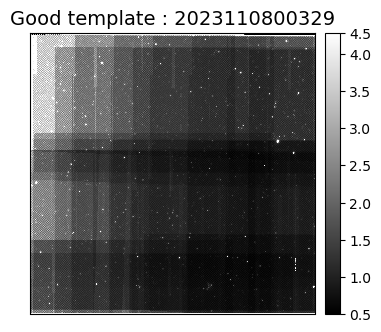

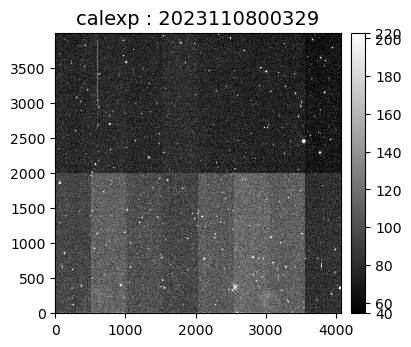

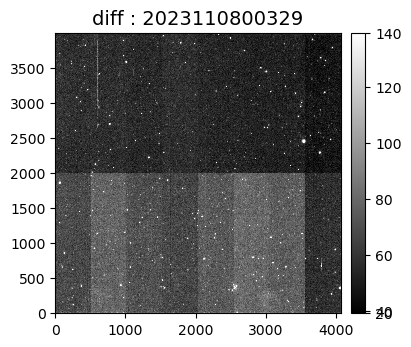

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


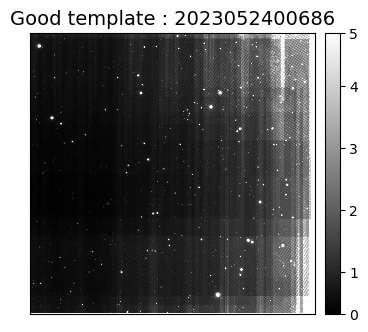

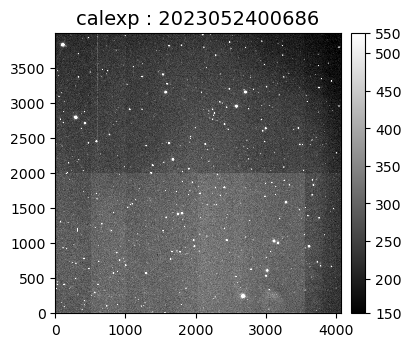

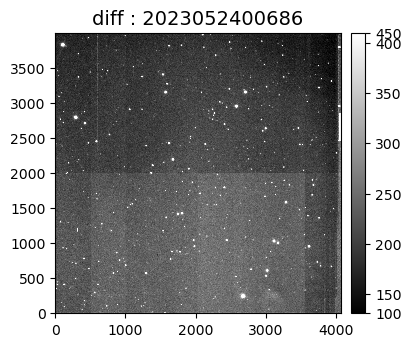

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


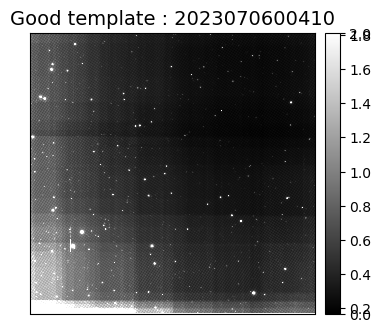

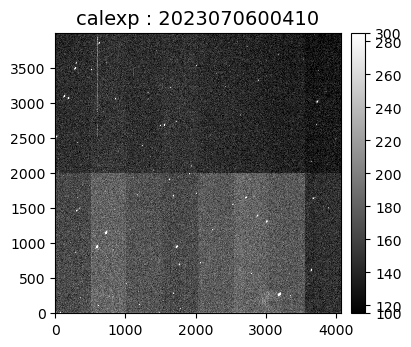

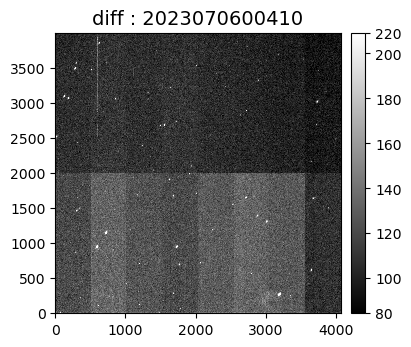

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


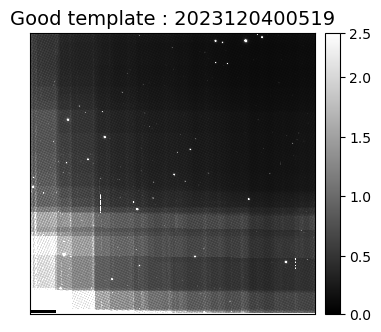

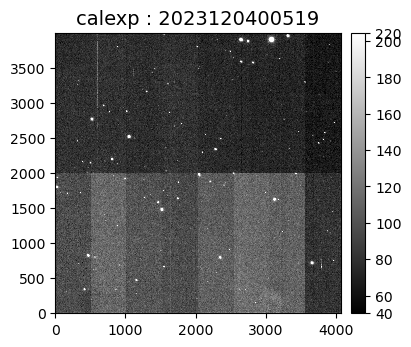

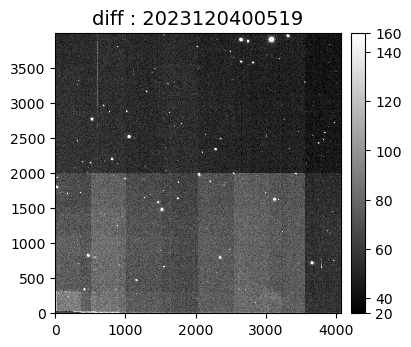

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


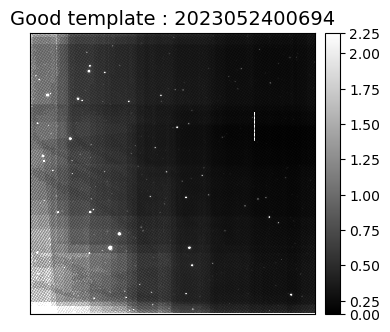

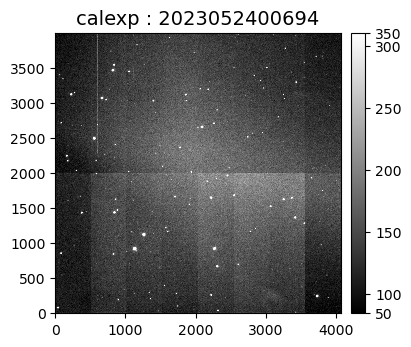

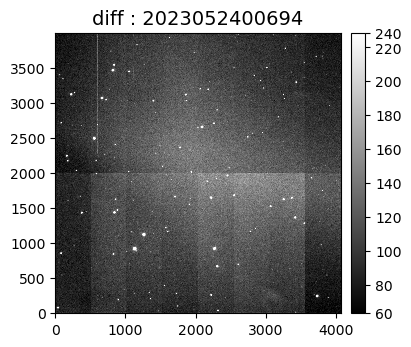

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


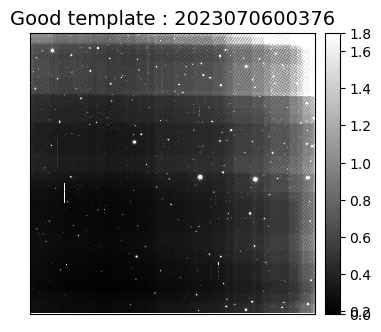

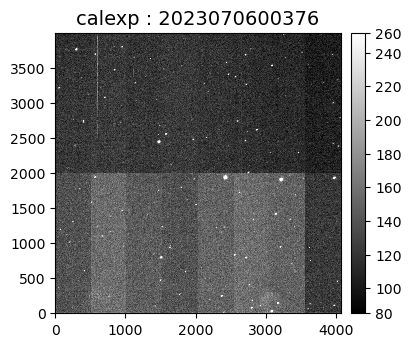

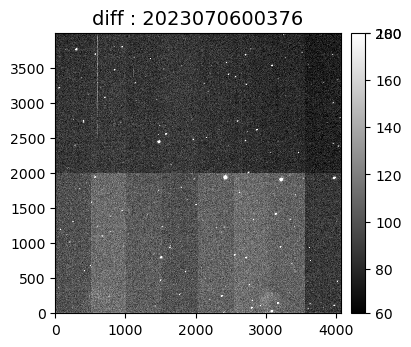

In [54]:
normal_variance_list = dataId_list_all_templates[5:]
# plotting one visit 

for dataId_list in normal_variance_list:
    for dataId in dataId_list[::4]:
        dataId = dataId.mapping
        dataId_string = {str(key): dataId[key] for key in dataId.keys()}
        
        calexp_image_good = butler_good.get('calexp', **dataId_string).variance
        diff_image_good = butler_good.get('goodSeeingDiff_differenceExp', **dataId_string).variance
        template_image_good = butler_good.get('goodSeeingDiff_templateExp', **dataId_string).variance
        fig, ax = plt.subplots(figsize=(4,4))
    
        display_template_good = afwDisplay.Display(frame=fig)
        display_template_good.scale('linear', 'zscale')
        display_template_good.mtv(template_image_good)
        plt.title('Good template : '+str(dataId['visit']), fontsize=14)
        ax2 = plt.gca()
        xax2 = ax2.axes.get_xaxis().set_visible(False)
        yax2 = ax2.axes.get_yaxis().set_visible(False)
        plt.show()
        display_template_good.delAllDisplays()
        remove_figure(fig)
    
        display_good = afwDisplay.Display(frame=fig)
        display_good.scale('linear', 'zscale')
        display_good.mtv(calexp_image_good)
        plt.title('calexp : '+str(dataId['visit']), fontsize=14)
        # ax1 = plt.gca()
        xax1 = ax1.axes.get_xaxis().set_visible(False)
        yax1 = ax1.axes.get_yaxis().set_visible(False)
        plt.show()
        remove_figure(fig)
    
        display_diff_good = afwDisplay.Display(frame=fig)
        display_diff_good.scale('linear', 'zscale')
        display_diff_good.mtv(diff_image_good)
        plt.title('diff : '+str(dataId['visit']), fontsize=14)
        # ax3 = plt.gca()
        xax3 = ax3.axes.get_xaxis().set_visible(False)
        yax3 = ax3.axes.get_yaxis().set_visible(False)
        plt.show()
        remove_figure(fig)
    
        del(dataId_string)

### Looking into anomoloy variance

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


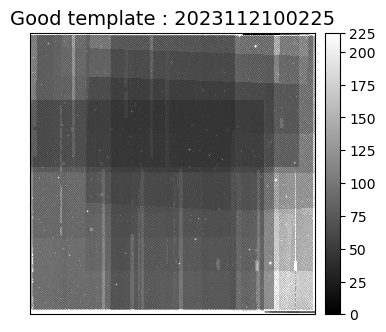

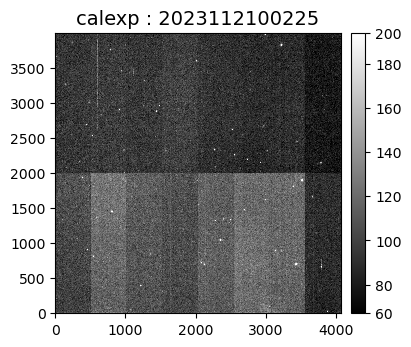

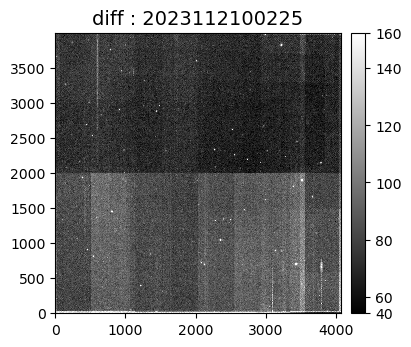

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


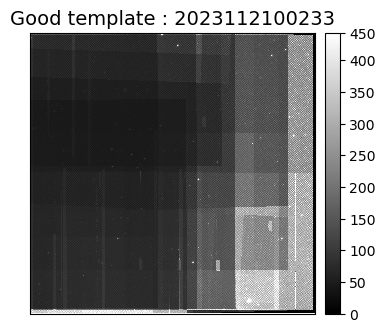

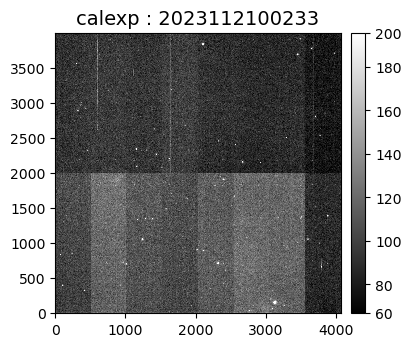

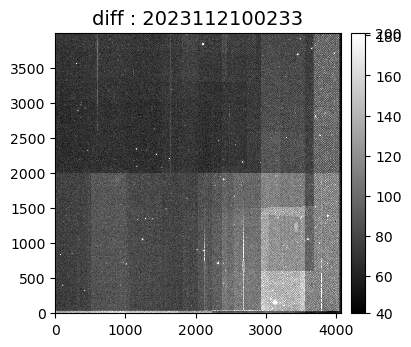

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


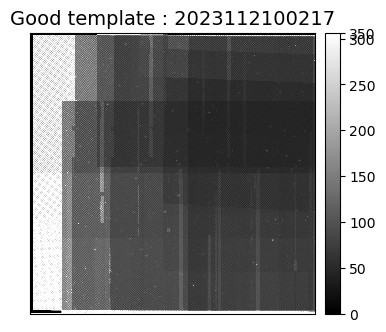

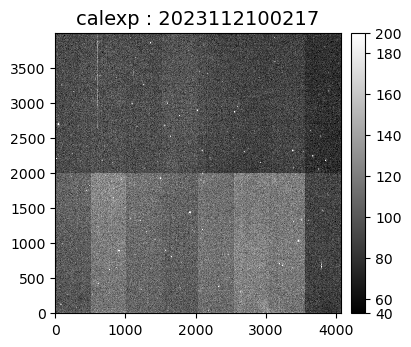

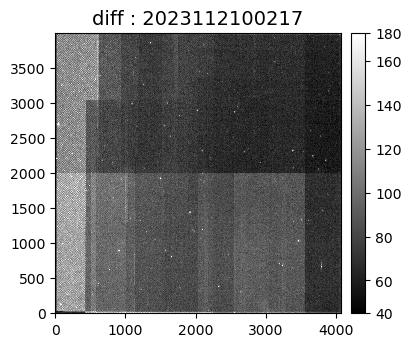

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


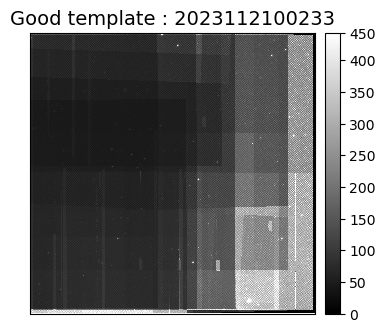

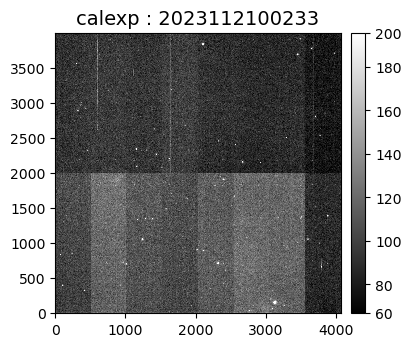

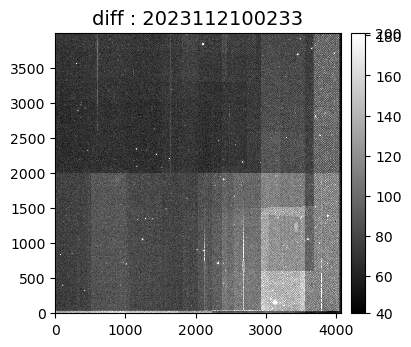

In [55]:
# rows 7-14
weird_dataids_large_variance = dataId_list_all_templates[3:5] 

for dataId_list in weird_dataids_large_variance:
    for dataId in dataId_list[::2]:
        dataId = dataId.mapping
        dataId_string = {str(key): dataId[key] for key in dataId.keys()}
        
        calexp_image_good = butler_good.get('calexp', **dataId_string).variance
        diff_image_good = butler_good.get('goodSeeingDiff_differenceExp', **dataId_string).variance
        template_image_good = butler_good.get('goodSeeingDiff_templateExp', **dataId_string).variance
        fig, ax = plt.subplots(figsize=(4,4))
    
        display_template_good = afwDisplay.Display(frame=fig)
        display_template_good.scale('linear', 'zscale')
        display_template_good.mtv(template_image_good)
        plt.title('Good template : '+str(dataId['visit']), fontsize=14)
        ax2 = plt.gca()
        xax2 = ax2.axes.get_xaxis().set_visible(False)
        yax2 = ax2.axes.get_yaxis().set_visible(False)
        plt.show()
        display_template_good.delAllDisplays()
        remove_figure(fig)
    
        display_good = afwDisplay.Display(frame=fig)
        display_good.scale('linear', 'zscale')
        display_good.mtv(calexp_image_good)
        plt.title('calexp : '+str(dataId['visit']), fontsize=14)
        # ax1 = plt.gca()
        xax1 = ax1.axes.get_xaxis().set_visible(False)
        yax1 = ax1.axes.get_yaxis().set_visible(False)
        plt.show()
        remove_figure(fig)
    
        display_diff_good = afwDisplay.Display(frame=fig)
        display_diff_good.scale('linear', 'zscale')
        display_diff_good.mtv(diff_image_good)
        plt.title('diff : '+str(dataId['visit']), fontsize=14)
        # ax3 = plt.gca()
        xax3 = ax3.axes.get_xaxis().set_visible(False)
        yax3 = ax3.axes.get_yaxis().set_visible(False)
        plt.show()
        remove_figure(fig)
    
        del(dataId_string)

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


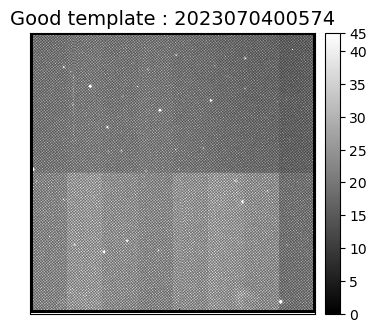

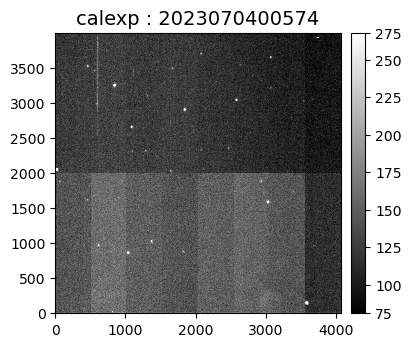

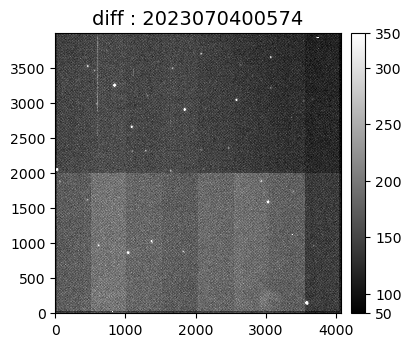

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


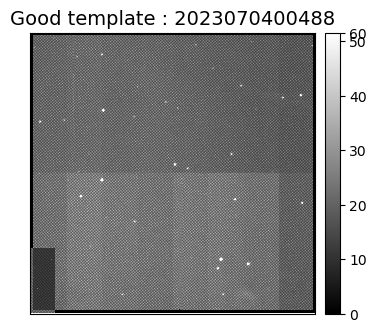

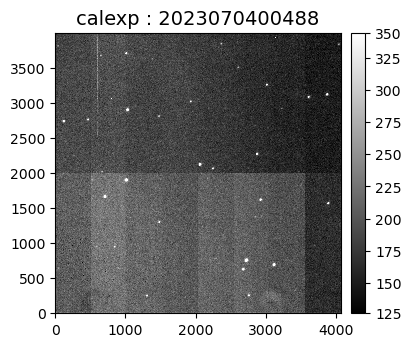

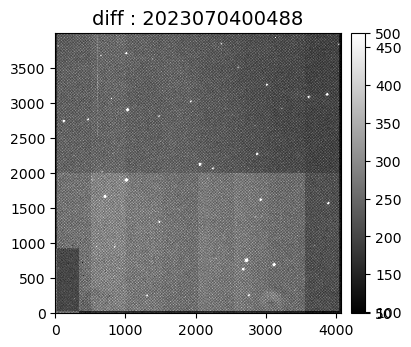

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


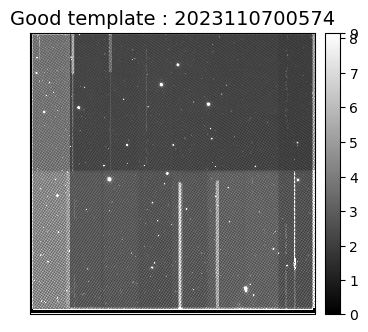

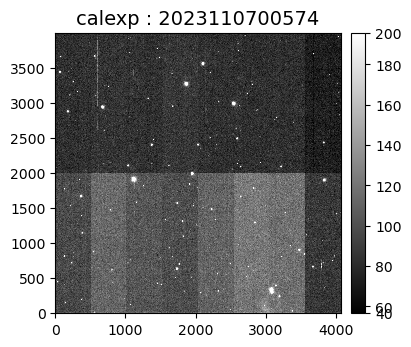

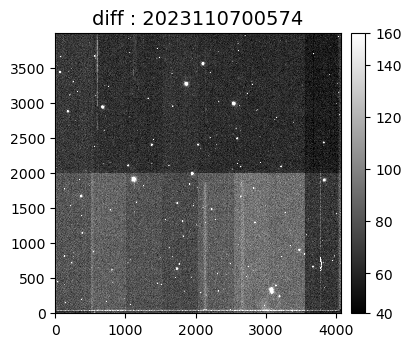

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


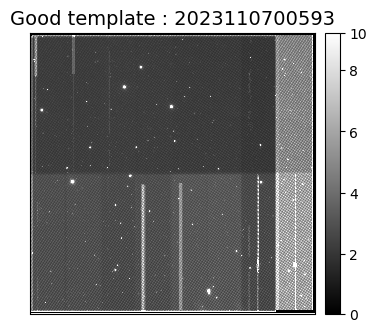

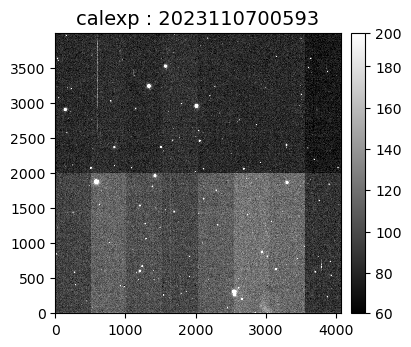

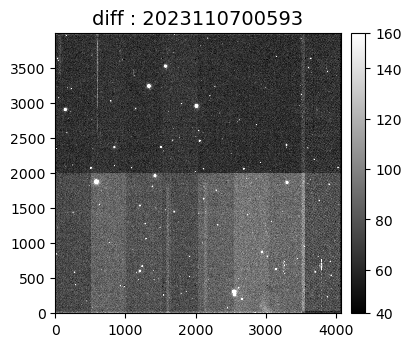

In [56]:
# rows 4-7
weird_dataids_large_variance = dataId_list_all_templates[0:3] 

for dataId_list in weird_dataids_large_variance:
    for dataId in dataId_list[::2]:
        dataId = dataId.mapping
        dataId_string = {str(key): dataId[key] for key in dataId.keys()}
        
        calexp_image_good = butler_good.get('calexp', **dataId_string).variance
        diff_image_good = butler_good.get('goodSeeingDiff_differenceExp', **dataId_string).variance
        template_image_good = butler_good.get('goodSeeingDiff_templateExp', **dataId_string).variance
        fig, ax = plt.subplots(figsize=(4,4))
    
        display_template_good = afwDisplay.Display(frame=fig)
        display_template_good.scale('linear', 'zscale')
        display_template_good.mtv(template_image_good)
        plt.title('Good template : '+str(dataId['visit']), fontsize=14)
        ax2 = plt.gca()
        xax2 = ax2.axes.get_xaxis().set_visible(False)
        yax2 = ax2.axes.get_yaxis().set_visible(False)
        plt.show()
        display_template_good.delAllDisplays()
        remove_figure(fig)
    
        display_good = afwDisplay.Display(frame=fig)
        display_good.scale('linear', 'zscale')
        display_good.mtv(calexp_image_good)
        plt.title('calexp : '+str(dataId['visit']), fontsize=14)
        # ax1 = plt.gca()
        xax1 = ax1.axes.get_xaxis().set_visible(False)
        yax1 = ax1.axes.get_yaxis().set_visible(False)
        plt.show()
        remove_figure(fig)
    
        display_diff_good = afwDisplay.Display(frame=fig)
        display_diff_good.scale('linear', 'zscale')
        display_diff_good.mtv(diff_image_good)
        plt.title('diff : '+str(dataId['visit']), fontsize=14)
        # ax3 = plt.gca()
        xax3 = ax3.axes.get_xaxis().set_visible(False)
        yax3 = ax3.axes.get_yaxis().set_visible(False)
        plt.show()
        remove_figure(fig)
    
        del(dataId_string)

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


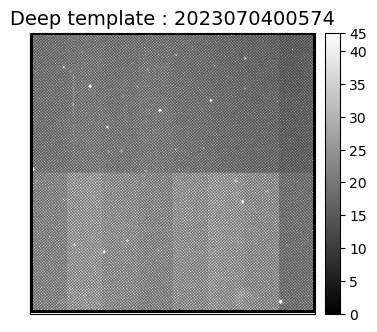

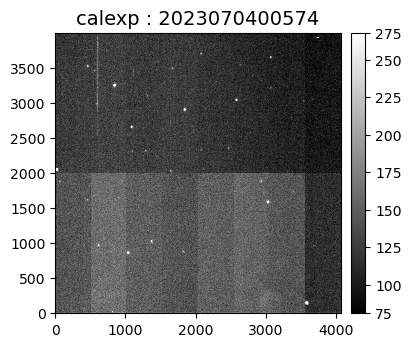

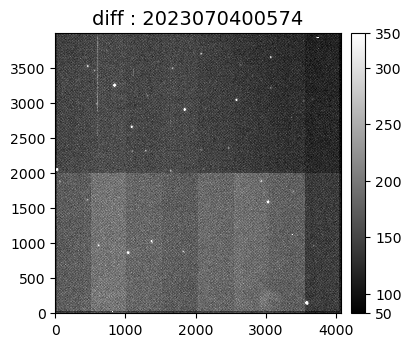

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


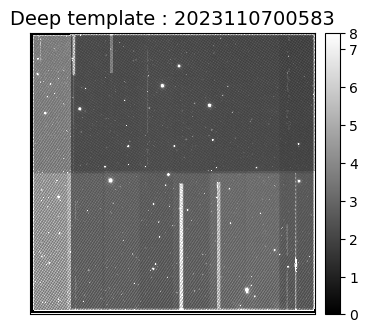

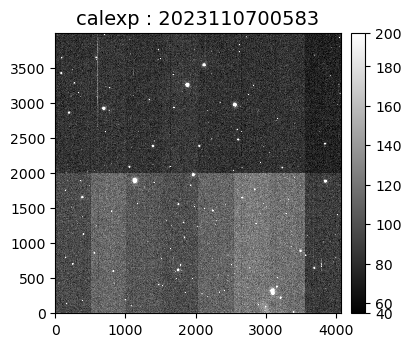

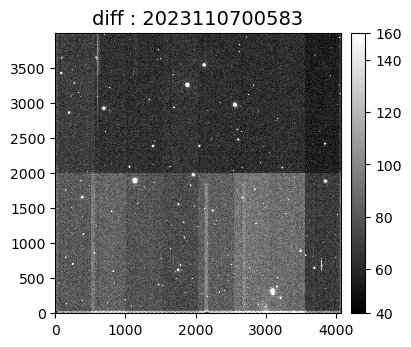

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


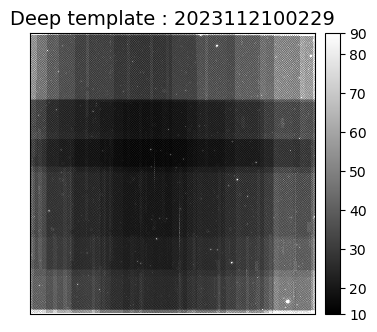

Exception ignored in: <function DisplayImpl.__del__ at 0x7fd94779d120>
Traceback (most recent call last):
  File "/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/afw/gf11f55472b+99ee6e9747/python/lsst/afw/display/virtualDevice.py", line 38, in __del__
    self._close()
  File "/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/display_matplotlib/g0265f82a02+1c31ac625c/python/lsst/display/matplotlib/matplotlib.py", line 175, in _close
    self._figure.gca().format_coord = lambda x, y: None  # keeps a copy of _wcs
    ^^^^^^^^^^^^
AttributeError: 'DisplayImpl' object has no attribute '_figure'
Exception ignored in: <function DisplayImpl.__del__ at 0x7fd94779d120>
Traceback (most recent call last):
  File "/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/afw/gf11f55472b+99ee6e9747/python/lsst/afw/display/virtualDevice.py", line 38, in __del__
    self._close()
  File "/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/di

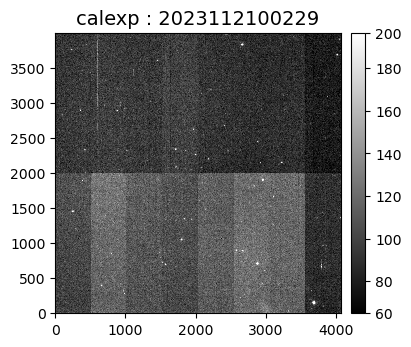

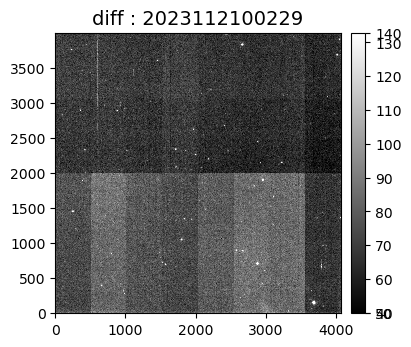

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


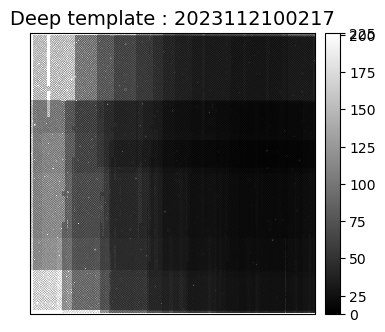

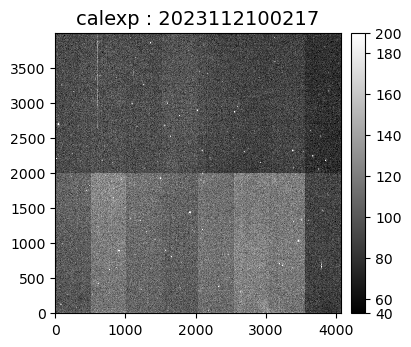

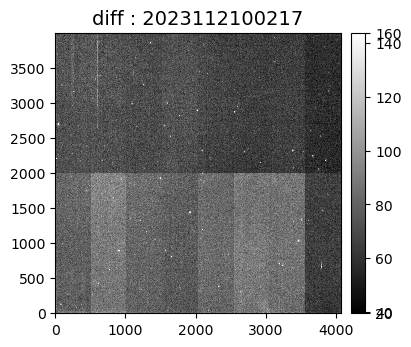

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


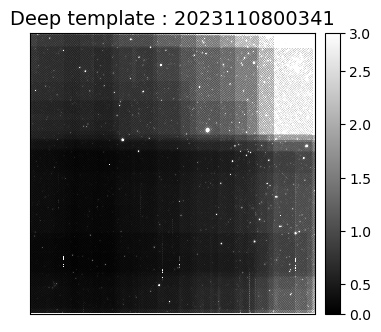

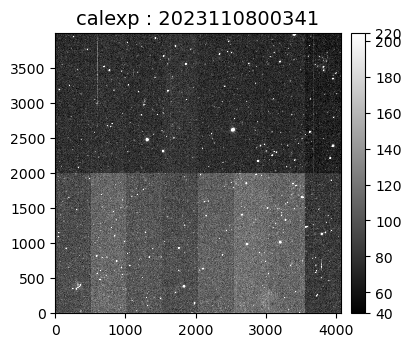

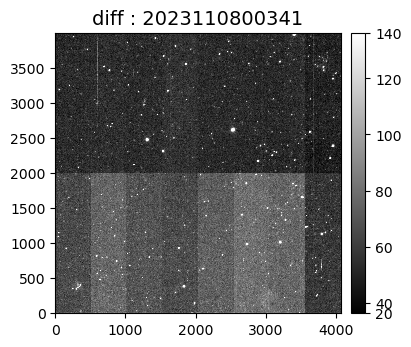

In [42]:
# Plotting calexp, template and difference image variance
for dataId in weird_dataids:
    # dataId = dataId.mapping
    # dataId_string = {str(key): dataId[key] for key in dataId.keys()}
    dataId_string = dataId
    
    # calexp_image_deep = butler_deep.get('calexp', **dataId_string).image
    # diff_image_deep = butler_deep.get('goodSeeingDiff_differenceExp', **dataId_string).image
    # template_image_deep = butler_deep.get('goodSeeingDiff_templateExp', **dataId_string).image

    calexp_image_deep = butler_deep.get('calexp', **dataId_string).variance
    diff_image_deep = butler_deep.get('goodSeeingDiff_differenceExp', **dataId_string).variance
    template_image_deep = butler_deep.get('goodSeeingDiff_templateExp', **dataId_string).variance

    # fig, (ax1, ax2, ax3) = plt.subplots(figsize=(4,4), nrows=3, ncols=1, sharex=True, sharey=True, squeeze=True, )
    fig, ax = plt.subplots(figsize=(4,4))

    display_template_deep = afwDisplay.Display(frame=fig)
    display_template_deep.scale('linear', 'zscale')
    display_template_deep.mtv(template_image_deep)
    plt.title('Deep template : '+str(dataId['visit']), fontsize=14)
    ax2 = plt.gca()
    xax2 = ax2.axes.get_xaxis().set_visible(False)
    yax2 = ax2.axes.get_yaxis().set_visible(False)
    plt.show()
    display_template_deep.delAllDisplays()
    remove_figure(fig)

    # image_arr = display_template_deep.array
    # print("median of the deep template: ", np.nanmedian(image_arr))
    # print("std of the deep template: ", np.nanstd(image_arr))


    display_deep = afwDisplay.Display(frame=fig)
    display_deep.scale('linear', 'zscale')
    display_deep.mtv(calexp_image_deep)
    plt.title('calexp : '+str(dataId['visit']), fontsize=14)
    # ax1 = plt.gca()
    xax1 = ax1.axes.get_xaxis().set_visible(False)
    yax1 = ax1.axes.get_yaxis().set_visible(False)
    plt.show()
    remove_figure(fig)

    # image_arr = display_deep.array
    # print("median of the deep calexp: ", np.nanmedian(image_arr))
    # print("std of the deep calexp: ", np.nanstd(image_arr))

    display_diff_deep = afwDisplay.Display(frame=fig)
    display_diff_deep.scale('linear', 'zscale')
    display_diff_deep.mtv(diff_image_deep)
    plt.title('diff : '+str(dataId['visit']), fontsize=14)
    # ax3 = plt.gca()
    xax3 = ax3.axes.get_xaxis().set_visible(False)
    yax3 = ax3.axes.get_yaxis().set_visible(False)
    plt.show()
    remove_figure(fig)

    # image_arr = display_diff_deep.array
    # print("median of the deep difference: ", np.nanmedian(image_arr))
    # print("std of the deep difference: ", np.nanstd(image_arr))

    del(dataId_string)

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


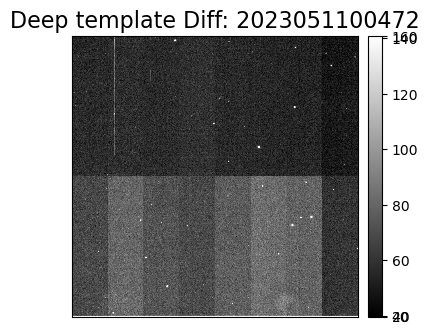

median:  62.427147
std:  2003864.6


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


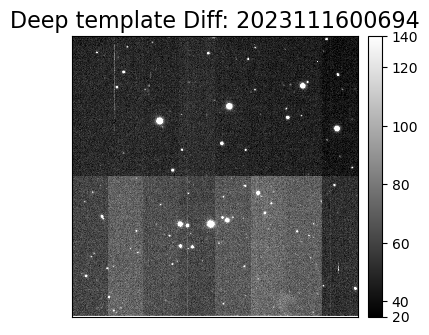

median:  55.525307
std:  1928485.0


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


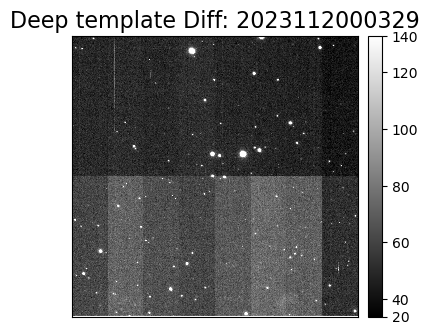

median:  55.282272
std:  1922030.2


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


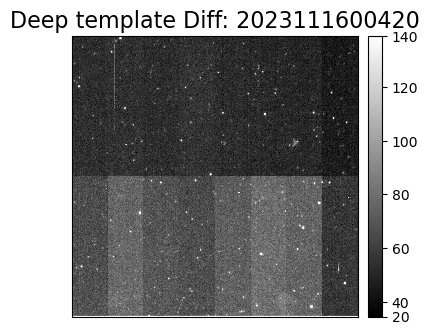

median:  59.561234
std:  nan


/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-8.0.0/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1734: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe', where=where)
/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


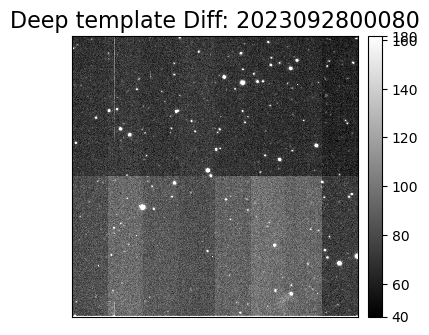

median:  77.91164
std:  nan


/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-8.0.0/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1734: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe', where=where)
/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


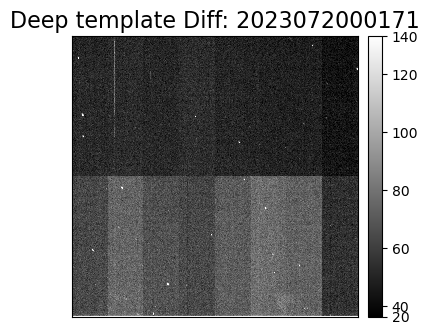

median:  57.03035
std:  nan


/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-8.0.0/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1734: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe', where=where)
/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


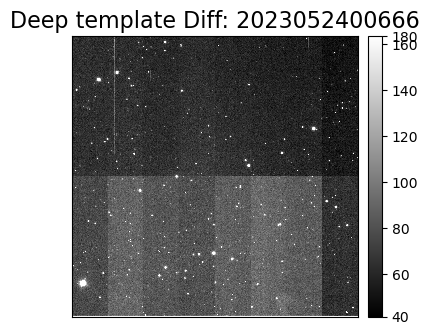

median:  69.986984
std:  nan


/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-8.0.0/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1734: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe', where=where)
/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


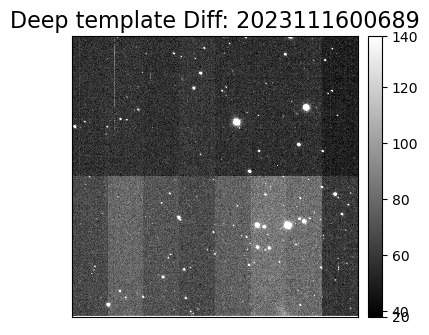

median:  63.28683
std:  100339290000.0


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


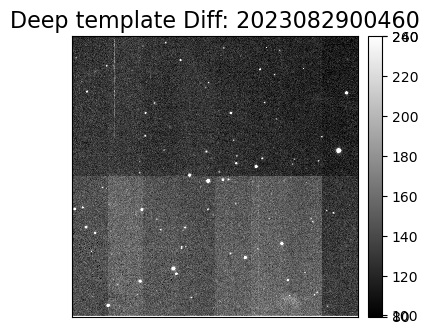

median:  135.85141
std:  2783411.2


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


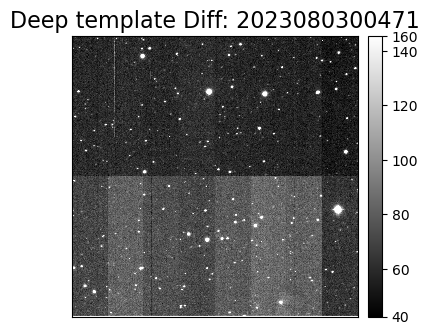

median:  66.0547
std:  nan


/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-8.0.0/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1734: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe', where=where)


In [20]:
# # Plotting deepcoadd template image

# for dataId in dataId_list:
#     dataId = dataId.mapping
#     dataId_string = {str(key): dataId[key] for key in dataId.keys()}
#     # template_image_deep = butler_deep.get('goodSeeingDiff_templateExp', **dataId_string).image
#     # template_image_deep = butler_deep.get('goodSeeingDiff_templateExp', **dataId_string).variance
#     diff_image_deep = butler_deep.get('goodSeeingDiff_differenceExp', **dataId_string).variance

#     fig, ax = plt.subplots(figsize=(4,4))

#     display_deep = afwDisplay.Display(frame=fig)
#     display_deep.scale('linear', 'zscale')
#     # display_deep.mtv(template_image_deep)
#     display_deep.mtv(diff_image_deep)
#     plt.title('Deep template Diff: '+str(dataId['visit']), fontsize=16)
#     ax1 = plt.gca()
#     xax1 = ax1.axes.get_xaxis().set_visible(False)
#     yax1 = ax1.axes.get_yaxis().set_visible(False)
#     plt.show()
#     remove_figure(fig)

#     # image_arr = template_image_deep.array
#     image_arr = diff_image_deep.array
#     # print("mean: ", np.mean(image_arr))
#     print("median: ", np.nanmedian(image_arr))
#     print("std: ", np.nanstd(image_arr))

#     del(dataId_string)

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


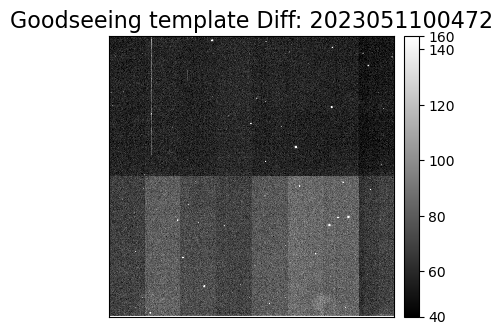

mean:  9415.943
std:  1996428.2


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


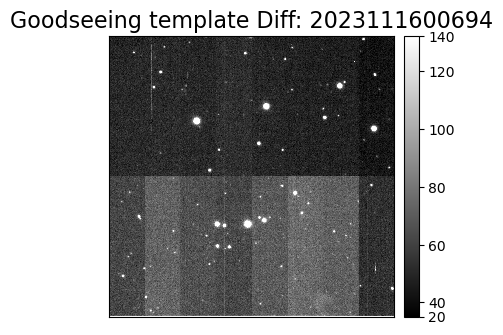

mean:  9191.98
std:  1949899.1


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


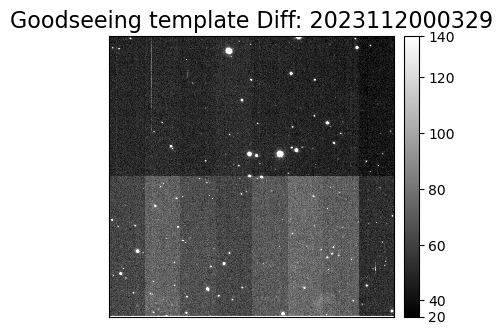

mean:  9195.632
std:  1950792.6


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


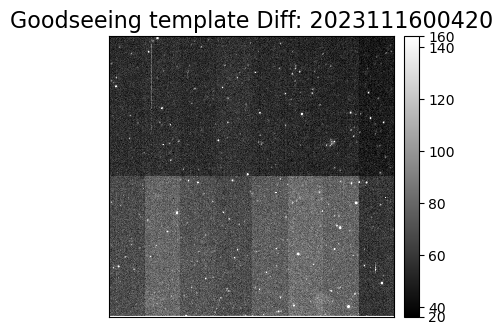

mean:  inf
std:  nan


/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-8.0.0/lib/python3.11/site-packages/numpy/core/_methods.py:236: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


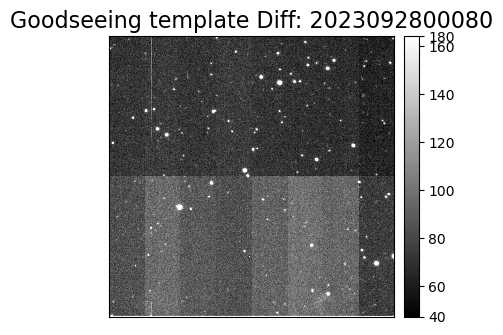

mean:  nan
std:  nan


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


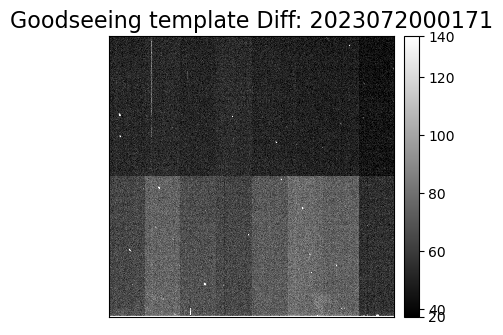

mean:  9181.038
std:  1947935.0


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


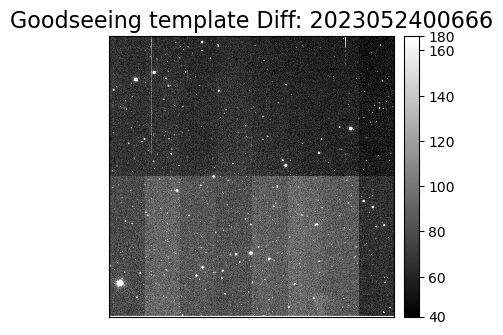

mean:  inf
std:  nan


/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-8.0.0/lib/python3.11/site-packages/numpy/core/_methods.py:236: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)
/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


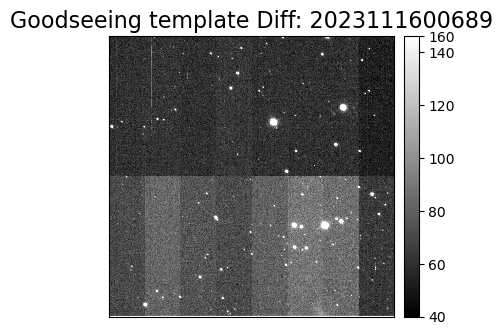

mean:  nan
std:  nan


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


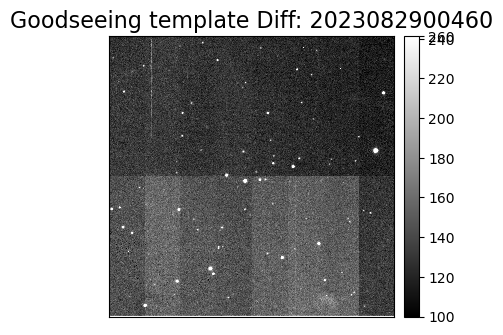

mean:  13148.49
std:  2803087.5


/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-8.0.0/Linux64/obs_base/gae481fbbf9+66445c569b/python/lsst/obs/base/formatters/fitsExposure.py:563: FutureWarning: Summary fields [effTime, effTimePsfSigmaScale, effTimeSkyBgScale, effTimeZeroPointScale] not recognized by this software version; ignoring them.
  result = self.reader.read(**self.checked_parameters)


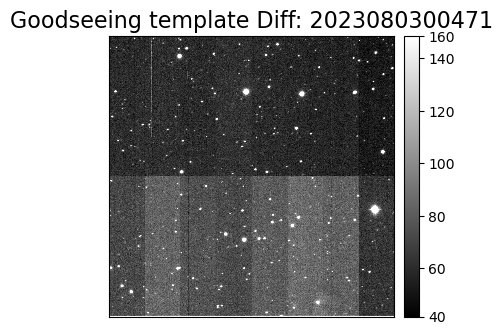

mean:  nan
std:  nan


In [18]:
# Plotting goodseeingcoadd template image

for dataId in dataId_list:
    dataId = dataId.mapping
    dataId_string = {str(key): dataId[key] for key in dataId.keys()}
    # template_image_good = butler_good.get('goodSeeingDiff_templateExp', **dataId_string).image
    # template_image_good = butler_good.get('goodSeeingDiff_templateExp', **dataId_string).variance
    diff_image_good = butler_good.get('goodSeeingDiff_differenceExp', **dataId_string).variance

    fig, ax = plt.subplots(figsize=(4,4))

    display_good = afwDisplay.Display(frame=fig)
    display_good.scale('linear', 'zscale')
    # display_good.mtv(template_image_good)
    display_good.mtv(diff_image_good)
    plt.title('Goodseeing template Diff: '+str(dataId['visit']), fontsize=16)
    ax1 = plt.gca()
    xax1 = ax1.axes.get_xaxis().set_visible(False)
    yax1 = ax1.axes.get_yaxis().set_visible(False)
    plt.show()
    remove_figure(fig)

    # image_arr = template_image_good.array
    image_arr = diff_image_good.array
    print("mean: ", np.mean(image_arr))
    print("std: ", np.std(image_arr))

    del(dataId_string)

## Plotting the flux in deep and goodseeing visits

In [43]:
good_visit_list = [2023112000329, 2023111600694, 2023111600689, 2023111600420, 
               2023092800080, 2023080300471, 2023082900460, 2023072000171, 2023052400666, 2023051100472]

In [52]:
def plot_flux_hostogram(good_visit_list, flux_col, fluxerr_col, snr_col=None):
    for i, visit in enumerate(good_visit_list):
        print('Plotting visit', visit)
        oneDiaSourceTable_good = butler_good.get('goodSeeingDiff_diaSrcTable', visit=visit, detector=0)
        oneDiaSourceTable_deep = butler_deep.get('goodSeeingDiff_diaSrcTable', visit=visit, detector=0)
    
        # selecting sources with flux > 0 and snr > 3
        if snr_col is None:
            flux_df_good = oneDiaSourceTable_good[[flux_col, fluxerr_col]]
            flux_df_good = flux_df_good[flux_df_good[flux_col] > 0.0]
            flux_df_good[snr_col] = flux_df_good[flux_col]/flux_df_good[fluxerr_col]
            flux_df_good[snr_col] = flux_df_good[flux_df_good[snr_col] > 3.0]
            
            flux_df_deep = oneDiaSourceTable_deep[[flux_col, fluxerr_col]]
            flux_df_deep = flux_df_deep[flux_df_deep[flux_col] > 0.0]
            flux_df_deep[snr_col] = flux_df_deep[flux_col]/flux_df_deep[fluxerr_col]
            flux_df_deep[snr_col] = flux_df_good[flux_df_deep[snr_col] > 3.0]
            
        else:
            flux_df_good = oneDiaSourceTable_good[[flux_col, fluxerr_col, snr_col]]
            flux_df_good = flux_df_good[(flux_df_good[flux_col] > 0.0) & (flux_df_good[snr_col] > 3.0)]
            
            flux_df_deep = oneDiaSourceTable_deep[[flux_col, fluxerr_col, snr_col]]
            flux_df_deep = flux_df_deep[(flux_df_deep[flux_col] > 0.0) & (flux_df_deep[snr_col] > 3.0)]
            
    
        fig, axs = plt.subplots(2,2, figsize=(8,8), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .2, wspace=.2)
        axs = axs.ravel()
    
        # scatter plot
        axs[0].scatter(oneDiaSourceTable_good['ra'], oneDiaSourceTable_good['dec'], s=32, color='C1', label='good', marker='*')
        axs[0].scatter(oneDiaSourceTable_deep['ra'], oneDiaSourceTable_deep['dec'], s=10, color='C0', label = 'deep')
        axs[0].set_title('Visit '+ str(visit), fontsize=12)
        axs[0].set_xlabel('RA (deg)', fontsize=14)
        axs[0].set_ylabel('DEC (deg)', fontsize=14)
        axs[0].xaxis.set_tick_params(labelsize=12)
        axs[0].yaxis.set_tick_params(labelsize=12)
        axs[0].legend(loc='lower left')

    
        # SNR plot
        counts_snr, bins_snr = np.histogram(flux_df_good[snr_col], bins=50)
        axs[1].set_xscale('log');
        axs[1].set_yscale('log');
        axs[1].hist(flux_df_good[snr_col],bins=bins_snr, histtype = 'step', label='good', alpha=0.3, edgecolor='C1', color='C1', fill=True);
        axs[1].hist(flux_df_deep[snr_col],bins=bins_snr, histtype = 'step', label='deep', alpha=0.3, edgecolor='C0', color='C0', fill=True);
        axs[1].set_xlabel('SNR = Flux / Flux Err')
        axs[1].legend(loc='upper right')
    
        # flux plot
        bins = 10**(np.arange(1,8,0.1));
        axs[2].set_xscale('log');
        axs[2].set_yscale('log');
        axs[2].hist(flux_df_good[flux_col],bins=bins, histtype = 'step', label='good', alpha=0.3, edgecolor='C1', color='C1', fill=True);
        axs[2].hist(flux_df_deep[flux_col],bins=bins, histtype = 'step', label='deep', alpha=0.3, edgecolor='C0', color='C0', fill=True);
        axs[2].set_xlabel('Flux')
        axs[2].legend(loc='upper right')
    
        # flux error plot
        bins = 10**(np.arange(1,8,0.1));
        axs[3].set_xscale('log');
        axs[3].set_yscale('log');
        axs[3].hist(flux_df_good[fluxerr_col],bins=bins, histtype = 'step', label='good', alpha=0.3, edgecolor='C1', color='C1', fill=True);
        axs[3].hist(flux_df_deep[fluxerr_col],bins=bins, histtype = 'step', label='deep', alpha=0.3, edgecolor='C0', color='C0', fill=True);
        axs[3].set_xlabel('Flux Error')
        axs[3].legend(loc='upper right')
    
    return axs

Plotting visit 2023112000329
Plotting visit 2023111600694
Plotting visit 2023111600689
Plotting visit 2023111600420
Plotting visit 2023092800080
Plotting visit 2023080300471
Plotting visit 2023082900460
Plotting visit 2023072000171
Plotting visit 2023052400666
Plotting visit 2023051100472


array([<Axes: title={'center': 'Visit 2023051100472'}, xlabel='RA (deg)', ylabel='DEC (deg)'>,
       <Axes: xlabel='SNR = Flux / Flux Err'>, <Axes: xlabel='Flux'>,
       <Axes: xlabel='Flux Error'>], dtype=object)

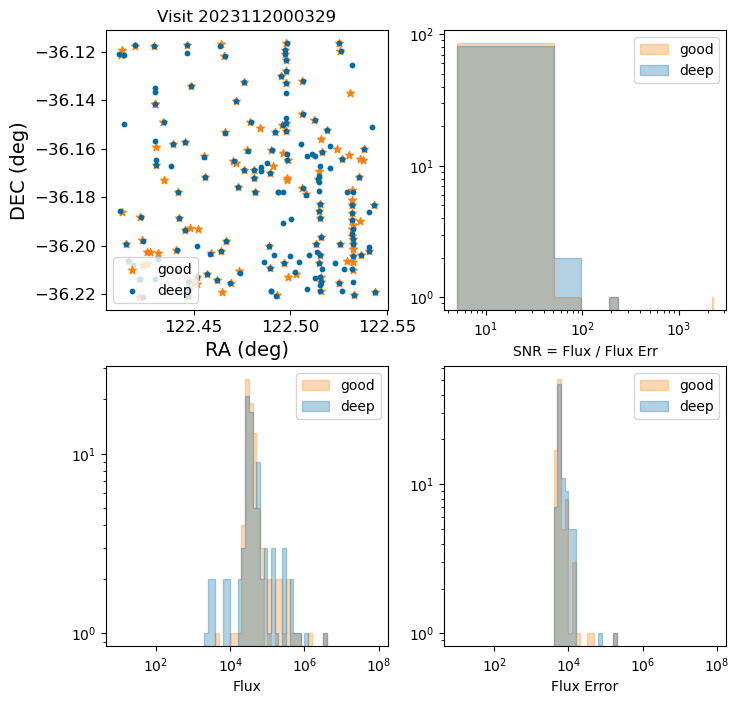

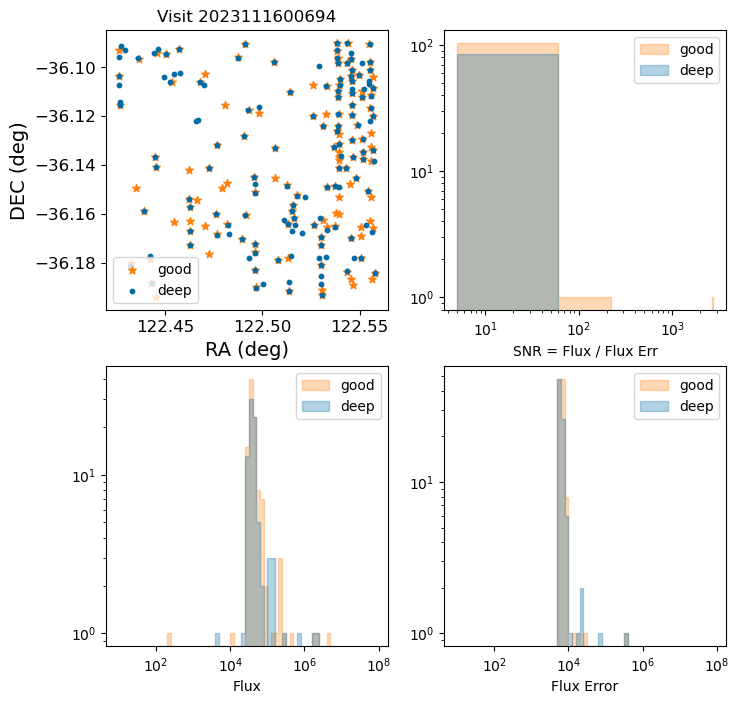

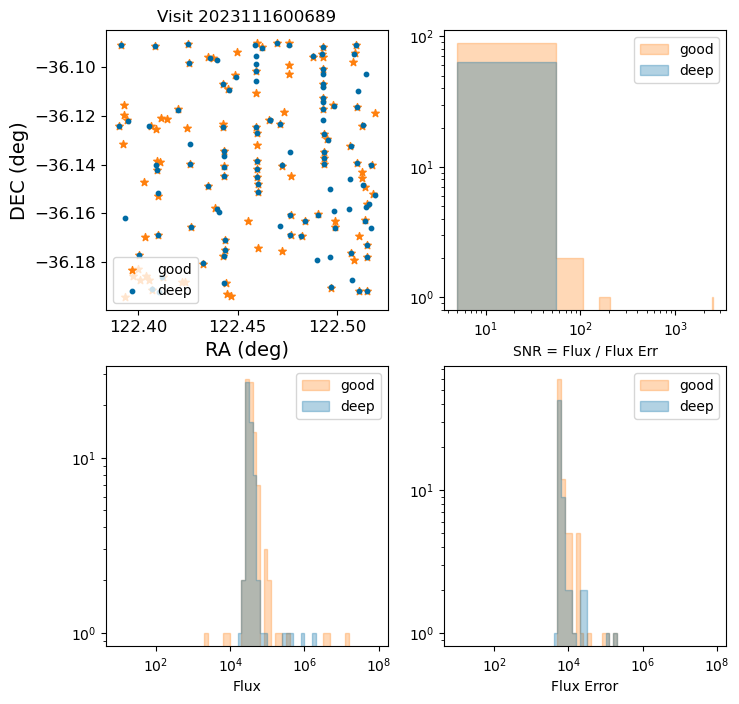

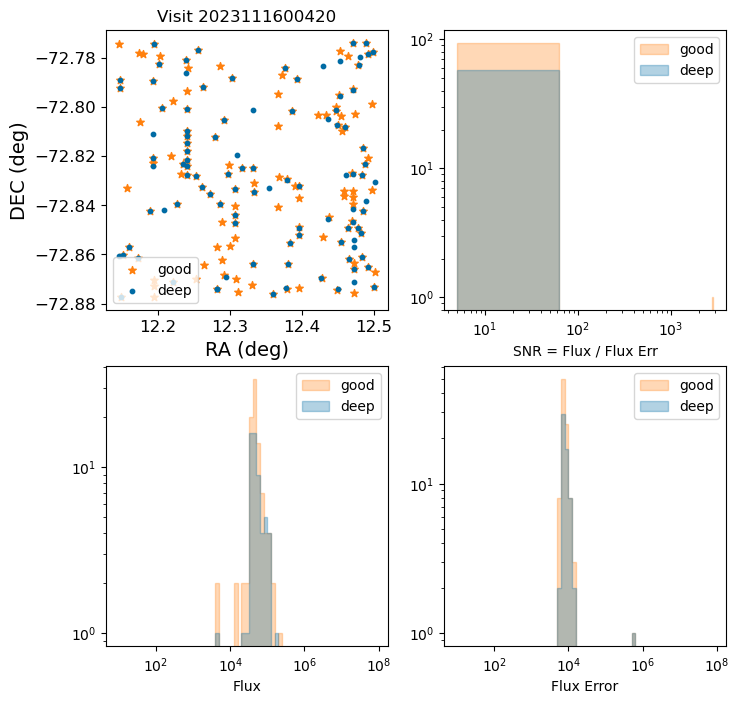

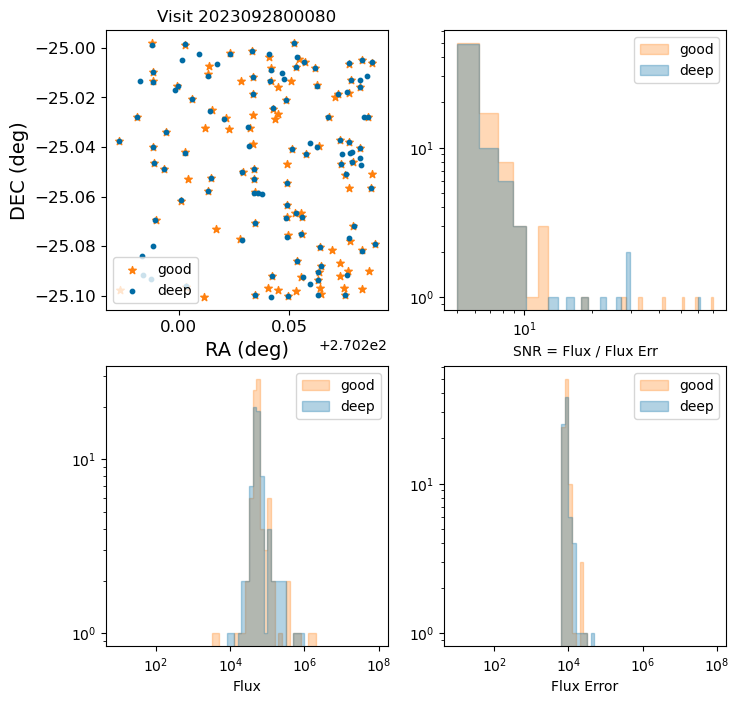

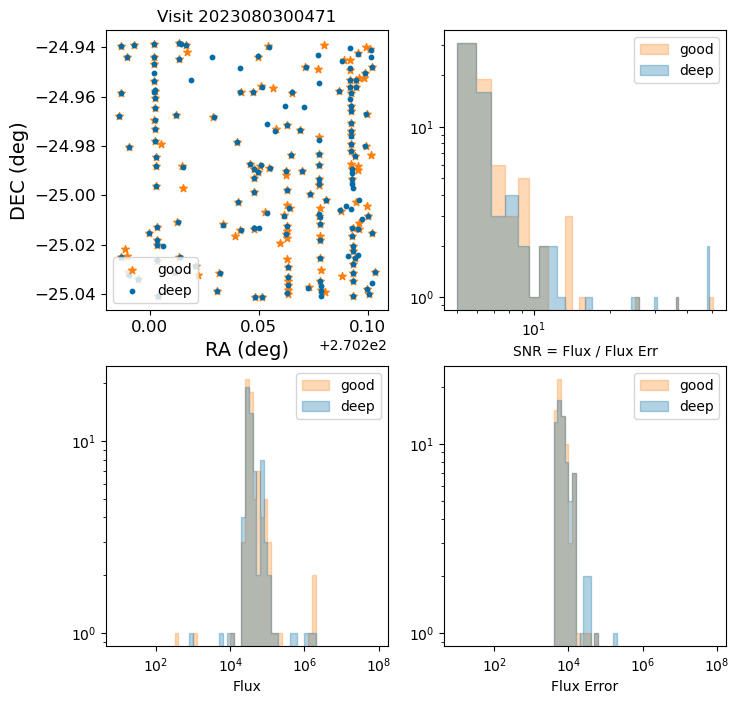

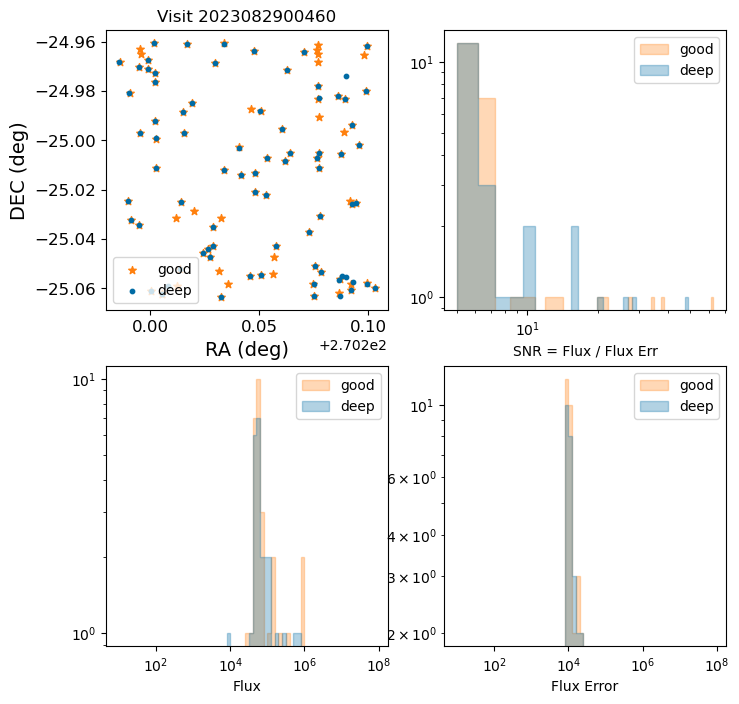

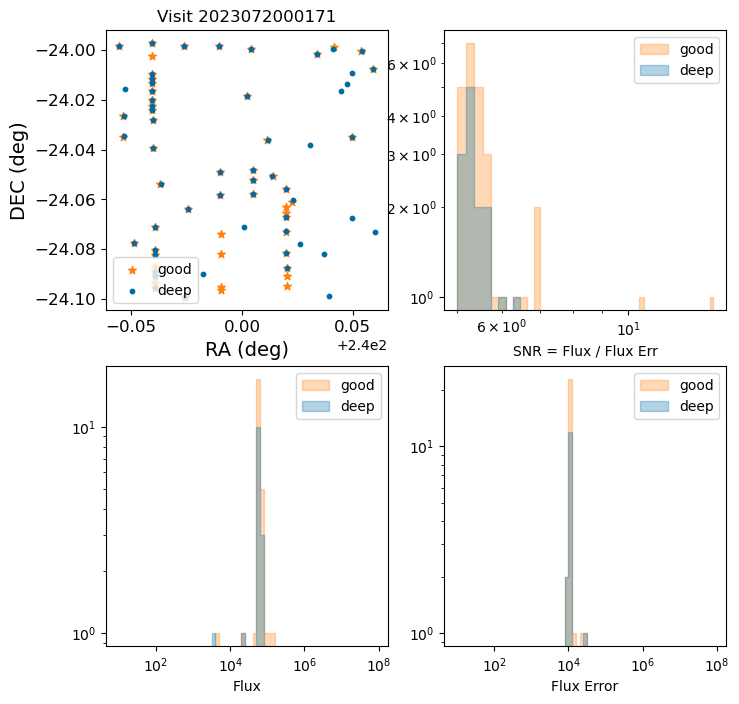

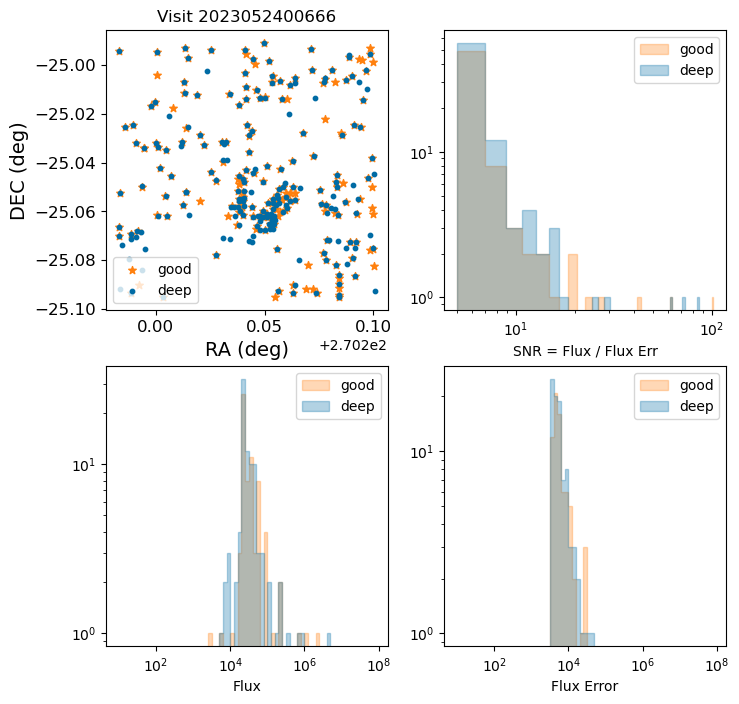

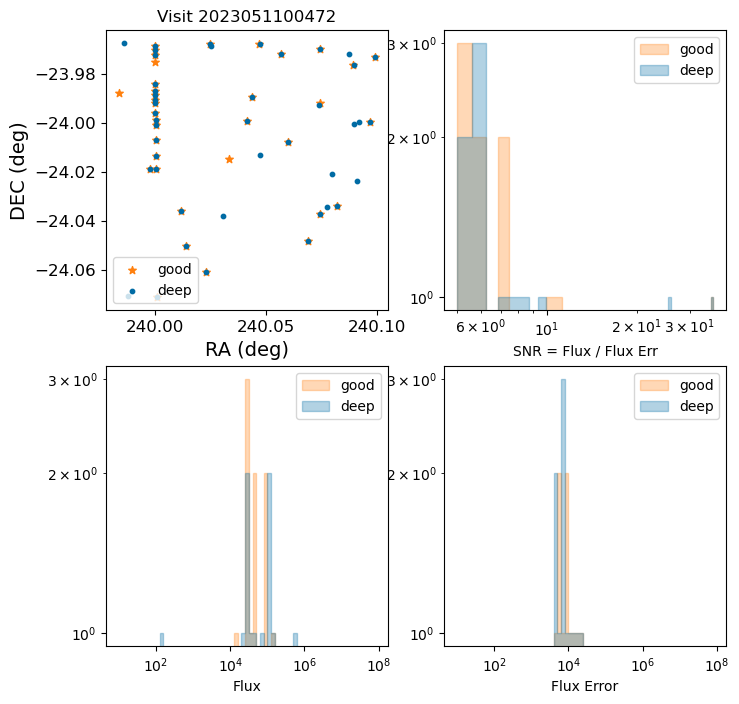

In [53]:
plot_flux_hostogram(good_visit_list, 'psfFlux', 'psfFluxErr', 'snr')